<a href="https://colab.research.google.com/github/Syed-Luqman-Shah-19/MIMOGPR1/blob/main/Syed_IEEE_Letter.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Codes for the letter

1.   Channels Generations, GPR based predicted channels, saving the channels
2.   Accuray of the predicted channel, error and 95% confidence tolerance for error
3. Percetage of the predicted values lies in the 95% confidence bouds
4. Channel Prediction Error (NMSE between the true and the predicted channels)
## Step 1: Channels Models generation: Kronecker and Weichselberger

In [ ]:
'''
channel_models.h5
│── Case I
│   ├── Kronecker
│   │   ├── Monte_1
│   │   │   ├── Original
│   │   │   │   ├── H (Original channel)
│   │   │   │   ├── R_H (Correlation matrix)
│   │   │   ├── RBF
│   │   │   │   ├── H (GPR prediction)
│   │   │   │   ├── std (Prediction std)
│   │   │   ├── Matern
│   │   │   ├── DotProduct
│   │   │   ├── RationalQuadratic
│   │   │   ├── ExpSineSquared
│   ├── Weichselberger
│   │   ├── Monte_1
│   │   │   ├── Original
│   │   │   │   ├── H (Original channel)
│   │   │   │   ├── R_H (Correlation matrix)
│   │   │   ├── RBF
│   │   │   ├── ...
│── Case II
│── Case III
│── Case IV
'''

import numpy as np
import pandas as pd
import h5py
from scipy.stats import norm
from sklearn.base import clone
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import (
    RBF, Matern, ExpSineSquared, ConstantKernel as C, DotProduct, RationalQuadratic, Kernel, Hyperparameter
)
from sklearn.base import clone
from sklearn.preprocessing import StandardScaler
from copy import deepcopy

from scipy.optimize import fmin_l_bfgs_b

def custom_optimizer(obj_func, initial_theta, bounds):
    opt_res = fmin_l_bfgs_b(obj_func, initial_theta, bounds=bounds, maxiter=1000)
    return opt_res[0]



# Set global random seed for reproducibility
np.random.seed(42)




class SpatialCorrelationKernel(Kernel):
    def __init__(self, R_H, Nt, scale=1.0, scale_bounds=(1e-5, 1e5)):
        self.R_H = R_H
        self.Nt = Nt
        self.scale = scale
        self.scale_bounds = scale_bounds

    @property
    def hyperparameter_scale(self):
        return Hyperparameter(
            "scale", "numeric", self.scale_bounds
        )

    @property
    def theta(self):
        return np.log([self.scale])

    @theta.setter
    def theta(self, theta):
        self.scale = np.exp(theta[0])

    @property
    def bounds(self):
        return np.log(self.scale_bounds).reshape(1, -1)

    def __call__(self, X, Y=None, eval_gradient=False):
        if Y is None:
            Y = X

        K = np.zeros((len(X), len(Y)))
        for i, (x_i, x_j) in enumerate(X):
            idx_x = x_i * self.Nt + x_j
            for k, (y_i, y_k) in enumerate(Y):
                idx_y = y_i * self.Nt + y_k
                K[i, k] = np.real(self.R_H[idx_x, idx_y]) * self.scale

        if eval_gradient:
            dK_dtheta = K[..., np.newaxis]  # Gradient w.r.t log(scale)
            return K, dK_dtheta
        return K

    def diag(self, X):
        return np.array([np.real(self.R_H[i*self.Nt + j, i*self.Nt + j]) * self.scale
                         for (i, j) in X])

    def is_stationary(self):
        return False


####################################################
####################################################
################## Core Functions ##################
####################################################
####################################################

def planar_array_response(Y, Z, phi, theta, kd):
    m = np.arange(Y)
    n = np.arange(Z)
    phase_y = kd * m * np.sin(phi) * np.sin(theta)
    phase_z = kd * n * np.cos(theta)
    phase = np.outer(phase_y, np.ones(Z)) + np.outer(np.ones(Y), phase_z)
    a = np.exp(1j * phase).flatten()
    return a / np.linalg.norm(a)

def generate_correlation_matrix(array_dims, phi_mean, theta_mean, sigma_phi, kd, num_samples=1000): ################################################################
    Y, Z = array_dims
    N = Y * Z
    R = np.zeros((N, N), dtype=np.complex128)
    for _ in range(num_samples):
        phi = phi_mean + norm.rvs(scale=sigma_phi)
        theta = theta_mean + norm.rvs(scale=sigma_phi)
        a = planar_array_response(Y, Z, phi, theta, kd)
        R += np.outer(a, a.conj())
    R /= num_samples
    return R

################################################################
######################## Channel Models ########################
################################################################

####### Kronecker Channel Model #######
def generate_kronecker_mimo_channel(**params):
    tx_array_dims = params["tx_array_dims"]
    rx_array_dims = params["rx_array_dims"]
    num_samples = params.get("num_samples", 1000)

    Yt, Zt = tx_array_dims
    Yr, Zr = rx_array_dims
    Nt, Nr = Yt*Zt, Yr*Zr

    dx, dy, dz = np.array(params["rx_pos"]) - np.array(params["tx_pos"])
    d_2d = np.sqrt(dx**2 + dy**2)
    phi_los_tx = np.arctan2(dy, dx)
    theta_los_tx = np.arctan2(dz, d_2d)

    c = 3e8
    lambda_c = c / params["fc"]
    kd = (2 * np.pi / lambda_c) * (lambda_c / 2)

    R_tx = generate_correlation_matrix(tx_array_dims, phi_los_tx, theta_los_tx,
                                      params["sigma_phi"], kd, num_samples)
    R_rx = generate_correlation_matrix(rx_array_dims, -phi_los_tx, -theta_los_tx,
                                      params["sigma_phi"], kd, num_samples)

    R_H = np.kron(R_tx, R_rx)  # Corrected Kronecker order

    G = (np.random.randn(Nr, Nt) + 1j*np.random.randn(Nr, Nt)) / np.sqrt(2)
    L_rx = np.linalg.cholesky(R_rx + 1e-6*np.eye(Nr))
    L_tx = np.linalg.cholesky(R_tx + 1e-6*np.eye(Nt))
    H = L_rx @ G @ L_tx.T

    return H, R_H

####### Weichselberger Channel Model #######
def generate_weichselberger_mimo_channel(**params):
    tx_array_dims = params["tx_array_dims"]
    rx_array_dims = params["rx_array_dims"]
    num_samples = params.get("num_samples", 1000)

    Yt, Zt = tx_array_dims
    Yr, Zr = rx_array_dims
    Nt, Nr = Yt*Zt, Yr*Zr

    R_rx = np.zeros((Nr, Nr), dtype=np.complex128)
    R_tx = np.zeros((Nt, Nt), dtype=np.complex128)

    num = 100;
    for _ in range(num):
        H_kron, _ = generate_kronecker_mimo_channel(**params)
        R_rx += H_kron @ H_kron.conj().T
        R_tx += H_kron.conj().T @ H_kron

    R_rx /= num
    R_tx /= num

    S_rx, U_rx = np.linalg.eigh(R_rx)
    S_tx, U_tx = np.linalg.eigh(R_tx)

    S_rx = np.real(S_rx).clip(min=0)
    S_tx = np.real(S_tx).clip(min=0)

    omega = np.outer(S_rx, S_tx)
    omega /= np.sum(omega)

    U_kron = np.kron(U_tx, U_rx)
    R_H = U_kron @ np.diag(omega.flatten()) @ U_kron.conj().T

    G = (np.random.randn(Nr, Nt) + 1j*np.random.randn(Nr, Nt)) / np.sqrt(2)
    H = U_rx @ (np.sqrt(omega) * G) @ U_tx.conj().T

    return H, R_H

###################################################################
######################## System Parameters ########################
###################################################################
common_params = {
    "tx_array_dims": (2, 2),
    "rx_array_dims": (2, 2),
    "fc": 28e9,
    "tx_pos": (0, 0, 0),
    "rx_pos": (20, 5, 1.5),
    "sigma_phi": np.pi/6
}

def extract_training_data(H, case):
    case_indices = {
        "Case I": [(0, 0), (0, 1), (0, 2), (0, 3)],
        "Case II": [(0, 0), (0, 1), (0, 2), (0, 3), (1, 0), (1, 1), (1, 2), (1, 3)],
        "Case III": [(0, 0), (0, 1), (0, 2), (0, 3), (1, 0), (1, 1), (1, 2), (1, 3), (2, 0), (2, 1), (2, 2), (2, 3)],
        "Case IV":  [(0, 0), (1, 1), (2, 2), (3, 3)]
    }
    indices = case_indices[case]
    X_train = np.array(indices)
    y_train_real = np.array([H[i, j].real for i, j in indices])
    y_train_imag = np.array([H[i, j].imag for i, j in indices])
    return X_train, y_train_real, y_train_imag


def generate_and_store_channels(num_monte=1000, filename='channel_models.h5'):
    case_indices = {
        "Case I": [(0, 0), (0, 1), (0, 2), (0, 3)],
        "Case II": [(0, 0), (0, 1), (0, 2), (0, 3), (1, 0), (1, 1), (1, 2), (1, 3)],
        "Case III":  [(0, 0), (1, 1), (2, 2), (3, 3)]
    }
    cases = list(case_indices.keys())

    base_kernels = {
        'RBF': 1.0 * RBF(length_scale=0.5, length_scale_bounds=(0.01, 10.0)),
        'Matern': 1.0 * Matern(length_scale=0.5, nu=1.5, length_scale_bounds=(0.01, 10.0)),
        #'DotProduct': C(1.0, (0.1, 20.0)) * DotProduct(sigma_0=0.1, sigma_0_bounds=(0.01, 1.0)),
        'RationalQuadratic': C(1.0, (0.1, 10.0)) * RationalQuadratic(length_scale=0.5, alpha=0.5, length_scale_bounds=(0.01, 5.0), alpha_bounds=(0.1, 5.0)),
        #'ExpSineSquared': C(1.0, (0.1, 10.0)) * ExpSineSquared(length_scale=0.5, periodicity=np.pi/2, length_scale_bounds=(0.01, 5.0), periodicity_bounds=(np.pi/4, np.pi))
    }

    models = ['Kronecker', 'Weichselberger']

    with h5py.File(filename, 'w') as hf:
        # Initialize storage structure
        storage = {
            case: {
                model: {
                    'Original': {'H': [], 'R_H': []},
                    **{kname: {'H': [], 'std': []} for kname in base_kernels},
                    'SpatialCorrelation': {'H': [], 'std': []}
                } for model in models
            } for case in cases
        }

        for _ in range(num_monte):
            for model in models:
                # Common parameters and model generation
                params = {
                    **common_params,
                    "num_samples": 1000,
                    "seed": 42  # Fixed seed for reproducibility
                }
                H, R_H = globals()[f"generate_{model.lower()}_mimo_channel"](**params)


                Nr, Nt = H.shape

                for case in cases:
                    # Extract training data for this case
                    X_train, y_train_real, y_train_imag = extract_training_data(H, case)
                    #X_all = np.array([(i, j) for i in range(Nr) for j in range(Nt)])
                    X_all = np.array([(rx_idx, tx_idx) for rx_idx in range(Nr) for tx_idx in range(Nt)])

                    # Store original channel data for this case, model, and iteration
                    storage[case][model]['Original']['H'].append(H)
                    storage[case][model]['Original']['R_H'].append(R_H)

                    # Process each base kernel
                    for kernel_name in base_kernels:
                        kernel = clone(base_kernels[kernel_name])

                        # Real part prediction
                        gpr_real = GaussianProcessRegressor(
                            kernel=kernel, n_restarts_optimizer=10,
                            optimizer='fmin_l_bfgs_b', random_state=0
                        )
                        gpr_real.fit(X_train, y_train_real)
                        print(f'The kernel fitted to the real part prediction is: {gpr_real.kernel_}')
                        y_pred_real, std_real = gpr_real.predict(X_all, return_std=True)

                        # Imaginary part prediction
                        gpr_imag = GaussianProcessRegressor(
                            kernel=kernel, n_restarts_optimizer=10,
                            optimizer='fmin_l_bfgs_b', random_state=0
                        )
                        gpr_imag.fit(X_train, y_train_imag)
                        print(f'The kernel fitted to the imaginary part prediction is: {gpr_imag.kernel_}')
                        y_pred_imag, std_imag = gpr_imag.predict(X_all, return_std=True)

                        # Store results
                        H_gpr = (y_pred_real + 1j*y_pred_imag).reshape(Nr, Nt)
                        total_std = np.sqrt(std_real**2 + std_imag**2).reshape(Nr, Nt)
                        storage[case][model][kernel_name]['H'].append(H_gpr)
                        storage[case][model][kernel_name]['std'].append(total_std)

                    # Process SpatialCorrelation kernel
                    kernel = SpatialCorrelationKernel(R_H, Nt, scale=0.5)
                    gpr_real = GaussianProcessRegressor(
                        kernel=kernel, n_restarts_optimizer=10,
                        optimizer='fmin_l_bfgs_b', random_state=0
                    )
                    gpr_real.fit(X_train, y_train_real)
                    print(f'The kernel fitted to the real part prediction is: {gpr_real.kernel_}')
                    y_pred_real, std_real = gpr_real.predict(X_all, return_std=True)

                    gpr_imag = GaussianProcessRegressor(
                        kernel=kernel, n_restarts_optimizer=10,
                        optimizer='fmin_l_bfgs_b', random_state=0
                    )
                    gpr_imag.fit(X_train, y_train_imag)
                    print(f'The kernel fitted to the imaginary part prediction is: {gpr_imag.kernel_}')
                    y_pred_imag, std_imag = gpr_imag.predict(X_all, return_std=True)

                    H_gpr = (y_pred_real + 1j*y_pred_imag).reshape(Nr, Nt)
                    total_std = np.sqrt(std_real**2 + std_imag**2).reshape(Nr, Nt)
                    storage[case][model]['SpatialCorrelation']['H'].append(H_gpr)
                    storage[case][model]['SpatialCorrelation']['std'].append(total_std)

        # Save all data to HDF5
        for case in cases:
            case_grp = hf.create_group(case)
            for model in models:
                model_grp = case_grp.create_group(model)
                current_storage = storage[case][model]
                for category in current_storage:
                    grp = model_grp.create_group(category)
                    if 'H' in current_storage[category]:
                        grp.create_dataset('H', data=np.array(current_storage[category]['H'], dtype=np.complex128))
                    if 'std' in current_storage[category]:
                        grp.create_dataset('std', data=np.array(current_storage[category]['std']))
                    if 'R_H' in current_storage[category]:
                        grp.create_dataset('R_H', data=np.array(current_storage[category]['R_H'], dtype=np.complex128))

generate_and_store_channels(num_monte=1000)
print('The data is successfully Generated and Saved')

KeyboardInterrupt: 

## Step 2: Error in the predicted and actual channel entries
1. Error is measured between the actual and predicted channel complex entries.
2. 95% confidence bounds that shows how much error can be tolerated.

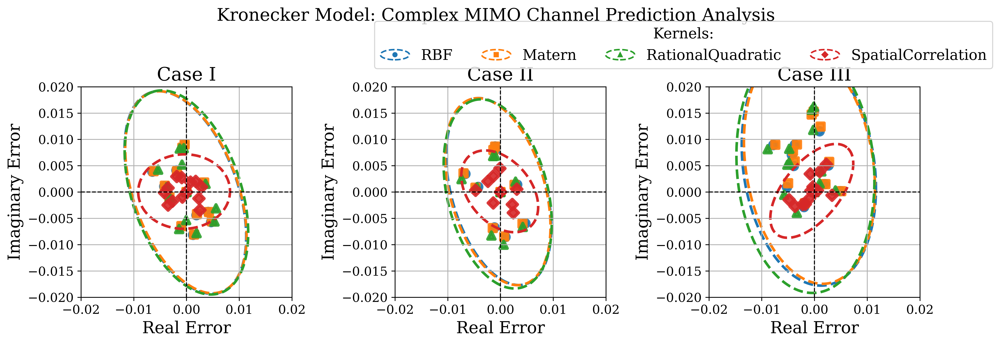

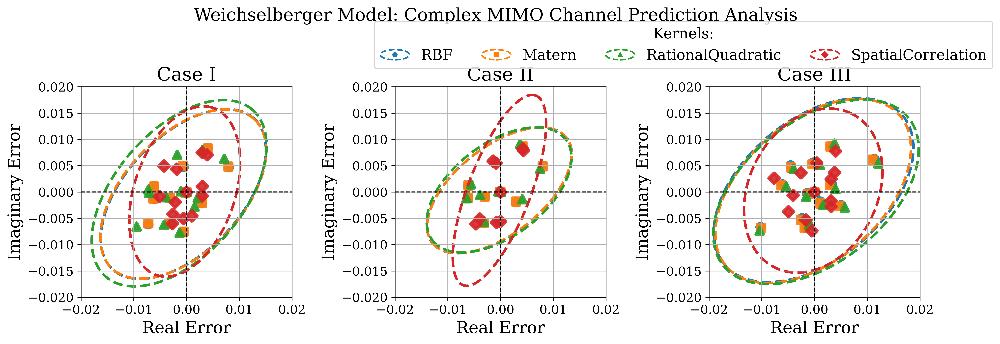

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse
from matplotlib.lines import Line2D
from matplotlib.legend_handler import HandlerBase
import matplotlib as mpl

# Matplotlib styling
mpl.rcParams.update({
    "text.usetex": False,
    "font.family": "DejaVu Serif",
    'font.size': 14,
    'axes.labelsize': 16,
    'axes.titlesize': 18,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'legend.fontsize': 14,
    'figure.dpi': 600,
    'axes.grid': True
})

# Define consistent kernel colors and markers
kernel_colors = {
    'RBF': '#1f77b4',
    'Matern': '#ff7f0e',
    'RationalQuadratic': '#2ca02c',
    'SpatialCorrelation': '#d62728'
}

kernel_markers = {
    'RBF': 'o',
    'Matern': 's',
    'RationalQuadratic': '^',
    'SpatialCorrelation': 'D'
}

cases = ["Case I", "Case II", "Case IV"]
models = ["Kronecker", "Weichselberger"]
kernels = list(kernel_colors.keys())


# Custom handler to combine Ellipse + marker for legend
class HandlerEllipseWithMarker(HandlerBase):
    def create_artists(self, legend, orig_handle,
                       xdescent, ydescent, width, height, fontsize, trans):
        ellipse_color, marker, marker_color = orig_handle

        # Create ellipse
        ell = Ellipse(xy=(xdescent + width / 2, ydescent + height / 2),
                      width=width, height=height,
                      edgecolor=ellipse_color,
                      facecolor='none',
                      lw=1.5,
                      linestyle='--',
                      transform=trans)

        # Create marker inside ellipse
        point = Line2D([xdescent + width / 2], [ydescent + height / 2],
                       marker=marker,
                       color=marker_color,
                       markersize=4,
                       linestyle='None',
                       markerfacecolor=marker_color,
                       transform=trans)

        return [ell, point]


def plot_complex_comparison_grouped_by_model():
    with h5py.File('channel_models.h5', 'r') as f:
        for model in models:
            fig, axs = plt.subplots(1, 3, figsize=(13.5, 4.5))
            fig.suptitle(f'{model} Model: Complex MIMO Channel Prediction Analysis', y=1.02)
            axs = axs.flatten()

            legend_entries = []
            legend_labels = []

            for idx, case in enumerate(cases):
                ax = axs[idx]
                H_true = np.mean(f[case][model]['Original']['H'][:], axis=0)

                ax.axhline(0, color='black', linestyle='--', lw=1)
                ax.axvline(0, color='black', linestyle='--', lw=1)

                for kernel in kernels:
                    H_pred = np.mean(f[case][model][kernel]['H'][:], axis=0)
                    std = np.mean(f[case][model][kernel]['std'][:], axis=0)

                    error = (H_pred - H_true).flatten()
                    real_err = np.real(error)
                    imag_err = np.imag(error)

                    ax.scatter(real_err, imag_err,
                               s=50, alpha=0.9,
                               color=kernel_colors[kernel],
                               marker=kernel_markers[kernel],
                               linewidth=3)

                    # Draw 95% confidence ellipse
                    cov = np.cov(real_err, imag_err)
                    vals, vecs = np.linalg.eigh(cov)
                    widths = np.sqrt(vals) * 4 * 1.96
                    angle = np.degrees(np.arctan2(*vecs[:, 0][::-1]))
                    ell = Ellipse(xy=(np.mean(real_err), np.mean(imag_err)),
                                  width=widths[0], height=widths[1],
                                  angle=angle,
                                  edgecolor=kernel_colors[kernel],
                                  fc='None', lw=2.5, linestyle='--')
                    ax.add_patch(ell)

                    if idx == 0:
                        # Store a tuple for custom handler: (ellipse_color, marker, marker_color)
                        legend_entries.append((kernel_colors[kernel],
                                               kernel_markers[kernel],
                                               kernel_colors[kernel]))
                        legend_labels.append(kernel)

                display_case = "Case III" if case == "Case IV" else case
                ax.set_title(display_case)
                ax.set_xlabel('Real Error')
                ax.set_ylabel('Imaginary Error')
                ax.set_xlim(-0.02, 0.02)
                ax.set_ylim(-0.02, 0.02)
                ax.set_aspect('equal', adjustable='box')
                ax.grid(True)

            # Custom legend using ellipse + marker combo
            handler_map = {tuple: HandlerEllipseWithMarker()}
            fig.legend(legend_entries, legend_labels,
                       handler_map=handler_map,
                       loc='upper right', bbox_to_anchor=(1, 1),
                       title='Kernels:', ncol=4)

            plt.tight_layout(rect=[0, 0, 0.95, 0.98])
            filename = model.replace(' ', '_')
            plt.savefig(f'Complex_Error_{filename}.pdf', bbox_inches='tight')
            plt.savefig(f'Complex_Error_{filename}.svg', bbox_inches='tight')
            plt.show()


if __name__ == "__main__":
    plot_complex_comparison_grouped_by_model()

## Step 3:

1.   How much percentage of the predicted complex values lies inside in the 95% confidence.

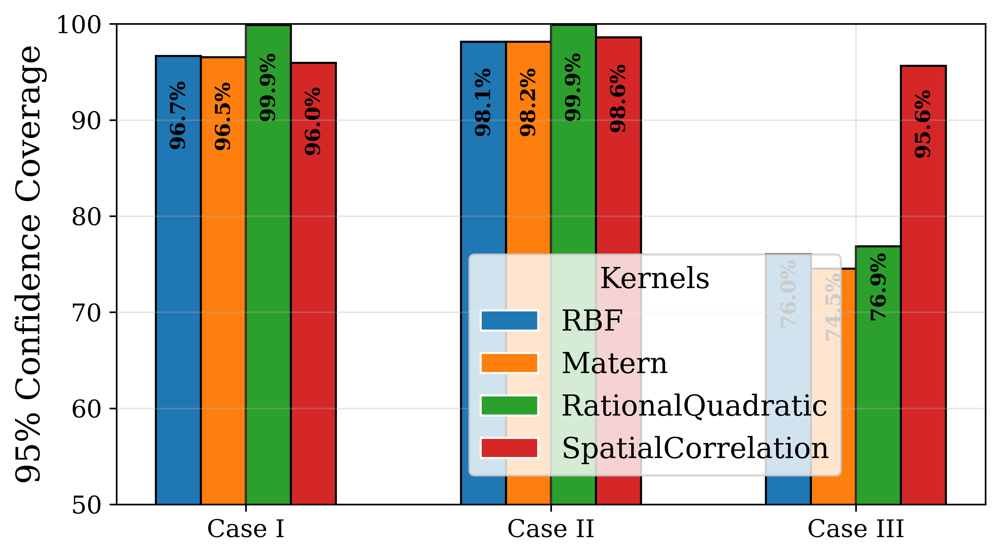

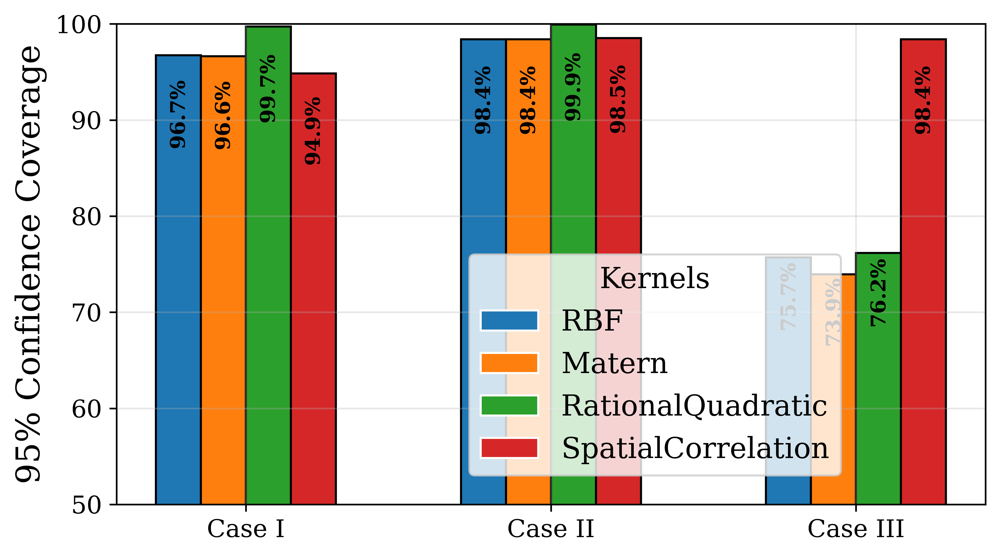

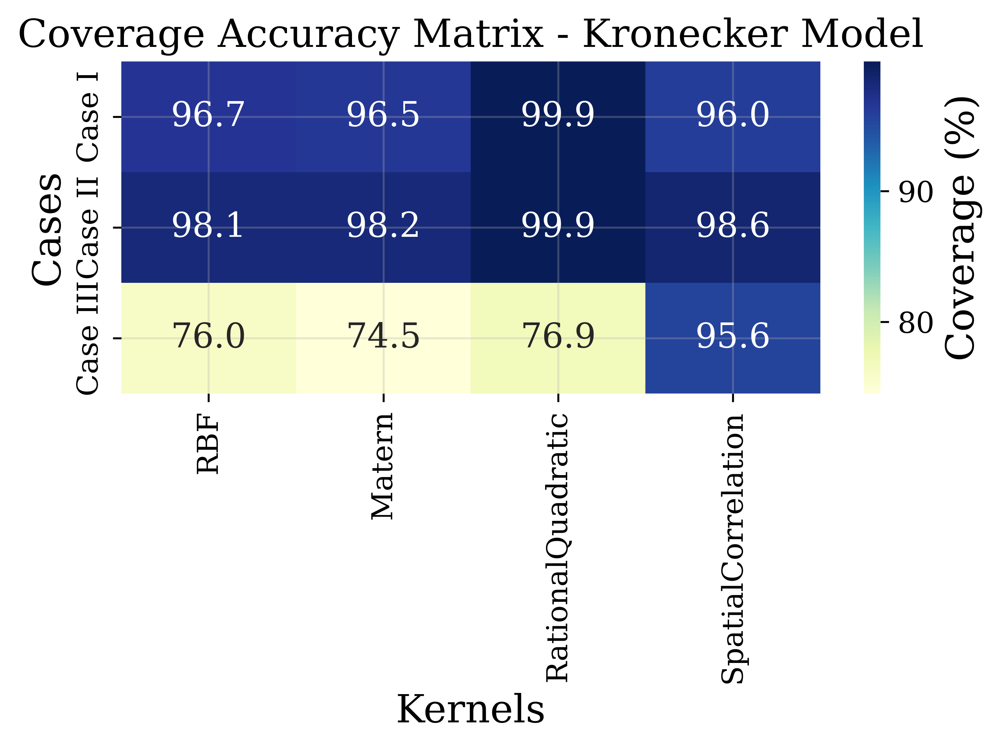

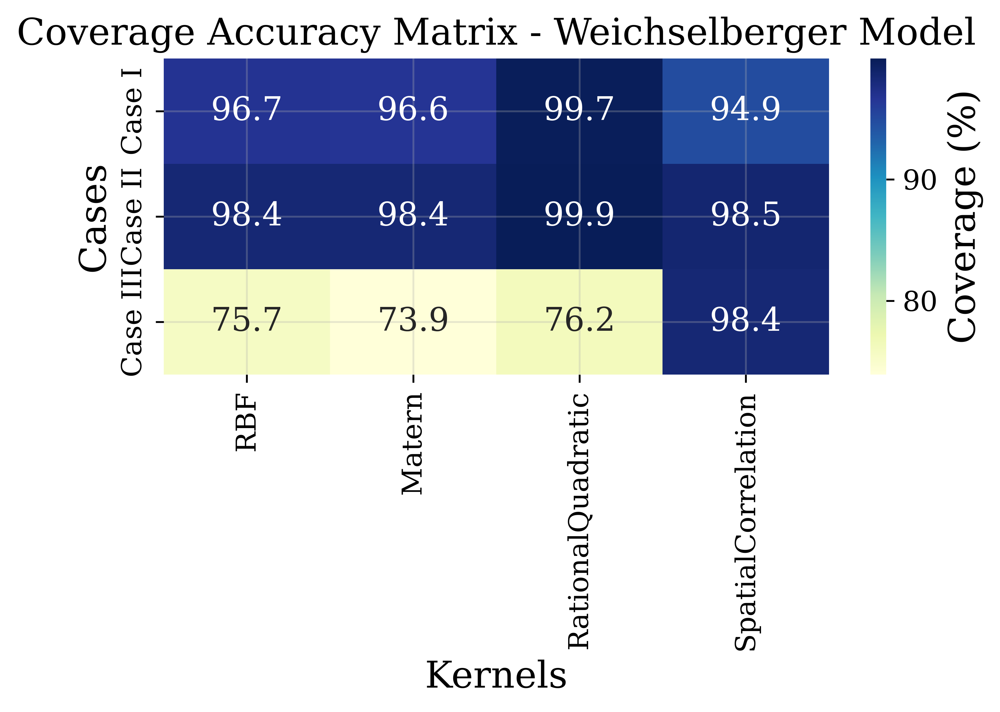

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import rcParams

# Unified kernel color mapping (same as first code)
kernel_colors = {
    'RBF': '#1f77b4',
    'Matern': '#ff7f0e',
    'RationalQuadratic': '#2ca02c',
    'SpatialCorrelation': '#d62728'
}

# Unified style setup
rcParams.update({
    "text.usetex": False,
    "font.family": "DejaVu Serif",  # consistent serif font
    'font.size': 14,
    'axes.labelsize': 16,
    'axes.titlesize': 18,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'legend.fontsize': 14,
    'figure.dpi': 600,
    'axes.grid': True
})

def load_channel_data():
    cases = ["Case I", "Case II", "Case IV"]
    models = ["Kronecker", "Weichselberger"]
    kernels = ['RBF', 'Matern', 'RationalQuadratic', 'SpatialCorrelation']
    data = {model: {case: {} for case in cases} for model in models}

    with h5py.File('channel_models.h5', 'r') as f:
        for model in models:
            for case in cases:
                data[model][case]['H_true'] = np.array(f[case][model]['Original']['H'][:], dtype=np.complex128).flatten()
                for kernel in kernels:
                    data[model][case][kernel] = {
                        'H_pred': np.array(f[case][model][kernel]['H'][:], dtype=np.complex128).flatten(),
                        'std': np.array(f[case][model][kernel]['std'][:], dtype=np.float64).flatten()
                    }
    return data, cases, models, kernels

def calculate_joint_coverage(H_true, H_pred, std):
    real_true, imag_true = np.real(H_true), np.imag(H_true)
    real_pred, imag_pred = np.real(H_pred), np.imag(H_pred)

    real_lower, real_upper = real_pred - 1.96*std, real_pred + 1.96*std
    imag_lower, imag_upper = imag_pred - 1.96*std, imag_pred + 1.96*std

    coverage_mask = (
        (real_true >= real_lower) & (real_true <= real_upper) &
        (imag_true >= imag_lower) & (imag_true <= imag_upper)
    )
    return np.mean(coverage_mask) * 100

def plot_model_coverage(model, data, cases, kernels):
    fig, ax = plt.subplots(figsize=(7, 4))

    bar_width = 0.18
    case_positions = np.arange(len(cases)) * (len(kernels)*bar_width + 0.5)

    for case_idx, case in enumerate(cases):
        case_data = data[model][case]
        H_true = case_data['H_true']

        coverages = [
            calculate_joint_coverage(H_true, case_data[k]['H_pred'], case_data[k]['std'])
            for k in kernels
        ]

        x = case_positions[case_idx] + np.arange(len(kernels)) * bar_width
        bars = ax.bar(x, coverages, bar_width,
                      color=[kernel_colors[k] for k in kernels],
                      edgecolor='black')

        for xi, val in zip(x, coverages):
            ax.text(xi, val*0.9, f'{val:.1f}%',
                    ha='center', va='bottom', rotation=90,
                    fontsize=10, fontweight='bold')

    ax.set_xticks(case_positions + (len(kernels)-1)*bar_width/2)
    ax.set_xticklabels([
        'Case III' if case == 'Case IV' else case for case in cases
    ])
    ax.set_ylabel('95% Confidence Coverage')
    ax.set_ylim(50, 100)

    legend_elements = [
        plt.Rectangle((0, 0), 1, 1, fc=kernel_colors[k], ec='w', label=k)
        for k in kernels
    ]
    ax.legend(handles=legend_elements, loc='upper right', bbox_to_anchor=(0.85, 0.55), title='Kernels')
    plt.tight_layout()
    plt.savefig(f'Joint_Coverage_{model}.pdf', bbox_inches='tight')
    #plt.savefig(f'Joint_Coverage_{model}.pgf', bbox_inches='tight')
    plt.savefig(f'Joint_Coverage_{model}.svg', bbox_inches='tight', dpi=600)
    plt.show()

def plot_accuracy_heatmaps(data, models, cases, kernels):
    for model in models:
        plt.figure(figsize=(6, 4.5))  # Compact and readable
        accuracy_matrix = np.zeros((len(cases), len(kernels)))

        for case_idx, case in enumerate(cases):
            H_true = data[model][case]['H_true']
            for kernel_idx, kernel in enumerate(kernels):
                accuracy_matrix[case_idx, kernel_idx] = calculate_joint_coverage(
                    H_true,
                    data[model][case][kernel]['H_pred'],
                    data[model][case][kernel]['std']
                )

        sns.heatmap(
            accuracy_matrix,
            annot=True, fmt=".1f", cmap="YlGnBu",
            xticklabels=kernels,
            yticklabels=['Case III' if c == 'Case IV' else c for c in cases],
            cbar_kws={'label': 'Coverage (%)'}
        )

        plt.title(f'Coverage Accuracy Matrix - {model} Model', fontsize=16)
        plt.xlabel('Kernels')
        plt.ylabel('Cases')
        plt.tight_layout()
        plt.savefig(f'Accuracy_Matrix_{model}.pdf', bbox_inches='tight')
        plt.show()

# Main execution
if __name__ == "__main__":
    channel_data, cases, models, kernels = load_channel_data()

    for model in models:
        plot_model_coverage(model, channel_data, cases, kernels)
    plot_accuracy_heatmaps(channel_data, models, cases, kernels)

## Step 4(a): The NMSE b/w the predicted and true channel in dB

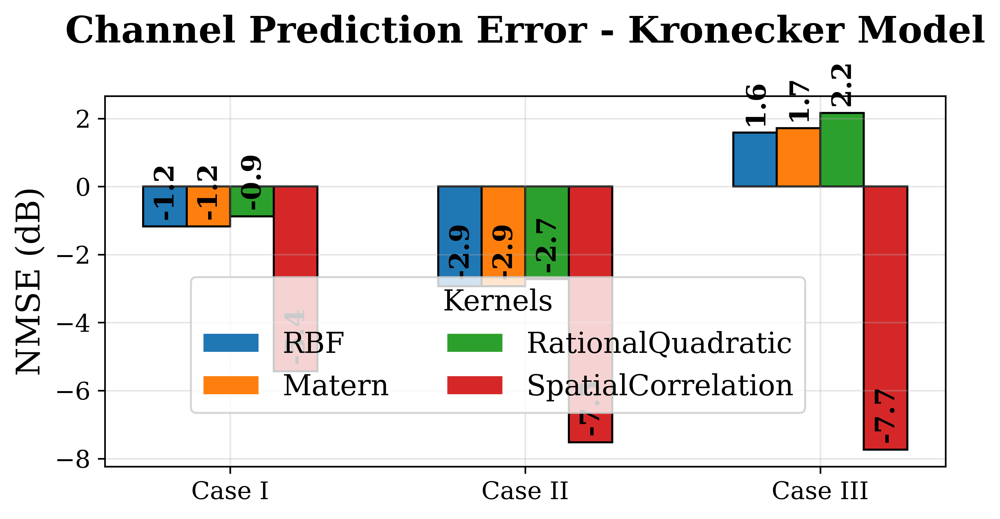

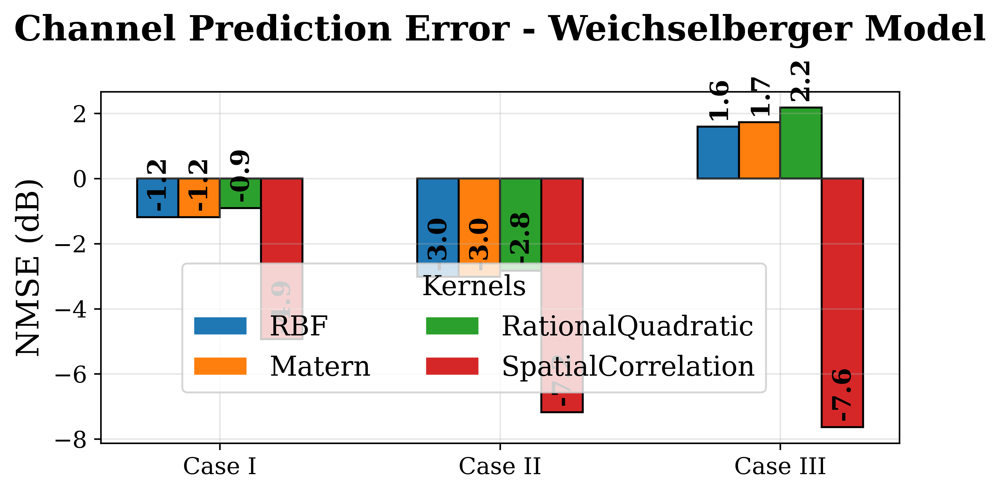

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rcParams

# Consistent color mapping
kernel_colors = {
    'RBF': '#1f77b4',
    'Matern': '#ff7f0e',
    'RationalQuadratic': '#2ca02c',
    'SpatialCorrelation': '#d62728'
}

# Global style setup
rcParams.update({
    "text.usetex": False,
    "font.family": "DejaVu Serif",  # consistent serif font
    'font.size': 14,
    'axes.labelsize': 16,
    'axes.titlesize': 18,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'legend.fontsize': 14,
    'figure.dpi': 600,
    'axes.grid': True
})

def calculate_nmse(H_true, H_pred):
    """Calculate Normalized Mean Squared Error with complex handling"""
    numerator = np.mean(np.abs(H_true - H_pred)**2)
    denominator = np.mean(np.abs(H_true)**2)
    return 10 * np.log10(numerator / denominator)

def plot_nmse_comparison(models, cases, kernels):
    with h5py.File('channel_models.h5', 'r') as f:
        for model in models:
            fig, ax = plt.subplots(figsize=(6.75, 3.75))

            bar_width = 0.18
            case_positions = np.arange(len(cases)) * (len(kernels)*bar_width + 0.5)

            for case_idx, case in enumerate(cases):
                H_true = np.array(f[case][model]['Original']['H'][:], dtype=np.complex128).flatten()

                nmse_values = []
                for kernel in kernels:
                    H_pred = np.array(f[case][model][kernel]['H'][:], dtype=np.complex128).flatten()
                    nmse = calculate_nmse(H_true, H_pred)
                    nmse_values.append(nmse)

                x = case_positions[case_idx] + np.arange(len(kernels)) * bar_width
                bars = ax.bar(x, nmse_values, bar_width,
                              color=[kernel_colors[k] for k in kernels],
                              edgecolor='black')

                for xi, val in zip(x, nmse_values):
                    ax.text(xi, val + 0.2, f'{val:.1f}',
                            ha='center', va='bottom', rotation=90,
                            fontsize=13, fontweight='bold')

            ax.set_xticks(case_positions + (len(kernels)-1)*bar_width/2)
            ax.set_xticklabels([
                'Case III' if case == 'Case IV' else case for case in cases
            ])
            ax.set_ylabel('NMSE (dB)')
            ax.set_title(f'Channel Prediction Error - {model} Model\n', fontweight='bold')

            legend_elements = [
                plt.Rectangle((0, 0), 1, 1, fc=kernel_colors[k], ec='w', label=k)
                for k in kernels
            ]
            ax.legend(handles=legend_elements, loc='upper right',
                      bbox_to_anchor=(0.85, 0.55), ncol=2, title='Kernels')

            plt.tight_layout()
            plt.savefig(f'NMSE_Comparison_{model}.pdf', bbox_inches='tight')
            #plt.savefig(f'NMSE_Comparison_{model}.pgf', bbox_inches='tight')
            plt.savefig(f'NMSE_Comparison_{model}.svg', bbox_inches='tight', dpi=600)
            plt.show()

# Main execution
if __name__ == "__main__":
    cases = ["Case I", "Case II", "Case IV"]
    models = ["Kronecker", "Weichselberger"]
    kernels = ['RBF', 'Matern', 'RationalQuadratic', 'SpatialCorrelation']

    plot_nmse_comparison(models, cases, kernels)

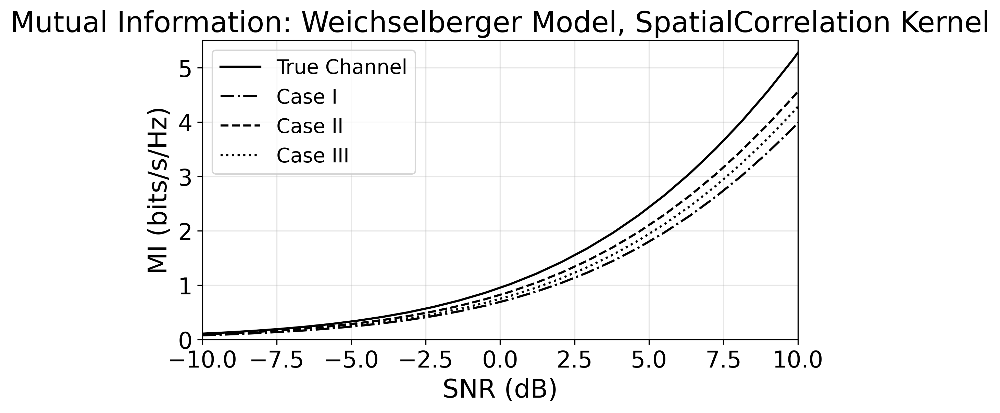

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt

# Plot settings
plt.rcParams.update({
    'font.size': 14,
    'axes.titlesize': 20,
    'axes.labelsize': 18,
    'xtick.labelsize': 16,
    'ytick.labelsize': 16,
    'figure.dpi': 300,
    'axes.grid': True,
    'grid.alpha': 0.3
})

# SNR
snr_db = np.linspace(-10, 15, 30)
snr_lin = 10 ** (snr_db / 10)

def compute_mi_vectorized(H_matrix, snr_lin, Nt):
    H_H = H_matrix @ H_matrix.conj().T
    eigvals = np.linalg.eigvalsh(H_H)
    scaling = snr_lin.reshape(-1, 1) / Nt
    terms = 1 + scaling * eigvals
    products = np.prod(terms, axis=1)
    mi = np.log2(products)
    return mi

# Setup
target_model = "Weichselberger"
target_kernel = "SpatialCorrelation"
target_cases = ["Case I", "Case II", "Case IV"]

# Distinct styles for each case (no markers, different colors & linestyles)
"""
case_styles = {
    "Case I":  {'linestyle': '-.', 'color': '#1f77b4'},  # blue
    "Case II": {'linestyle': '--', 'color': '#2ca02c'},  # green
    "Case IV": {'linestyle': ':',  'color': '#d62728'}   # red
}
"""
case_styles = {
    "Case I":  {'linestyle': '-.'},  # blue
    "Case II": {'linestyle': '--'},  # green
    "Case IV": {'linestyle': ':'}   # red
}

plt.figure(figsize=(7, 4.25))  # Single figure

with h5py.File('channel_models.h5', 'r') as hf:
    # Load true channel once
    H_true = hf["Case I"][target_model]['Original']['H'][:]
    num_monte, Nr, Nt = H_true.shape
    mi_true = [compute_mi_vectorized(H_true[i], snr_lin, Nt) for i in range(num_monte)]
    mi_true_avg = np.mean(mi_true, axis=0) * 3

    # Plot true channel (black solid line, no marker)
    plt.plot(snr_db, mi_true_avg,
             label='True Channel',
             linestyle='-', color='black')

    # Plot each case's GPR result
    for case in target_cases:
        label_case = "Case III" if case == "Case IV" else case
        H_gpr = hf[case][target_model][target_kernel]['H'][:]
        mi_gpr = [compute_mi_vectorized(H_gpr[i], snr_lin, Nt) for i in range(num_monte)]
        mi_gpr_avg = np.mean(mi_gpr, axis=0) * 3

        style = case_styles[case]
        plt.plot(snr_db, mi_gpr_avg,
                 label=f'{label_case}',
                 linestyle=style['linestyle'], color='black') #, color=style['color']

# Final plot settings
plt.xlabel('SNR (dB)')
plt.ylabel('MI (bits/s/Hz)')
plt.title(f'Mutual Information: {target_model} Model, {target_kernel} Kernel')
plt.legend()
plt.grid(True)
plt.xlim(-10, 10)
plt.ylim(0, 5.5)
plt.tight_layout()
plt.savefig(f'MI_Comparison_{target_model}_{target_kernel}_AllCases.png', dpi=300)
plt.savefig(f'MI_Comparison_{target_model}_{target_kernel}_AllCases.svg', bbox_inches='tight', dpi=600)
plt.show()

## Step 4(b): The NMSE b/w the predicted and true channel in log sacle

### 5. Mutual Information

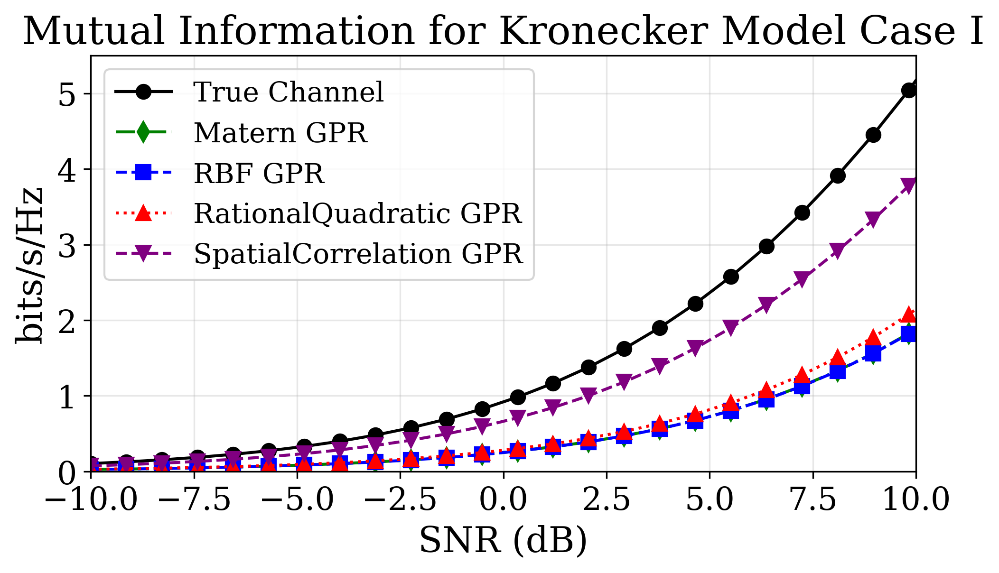

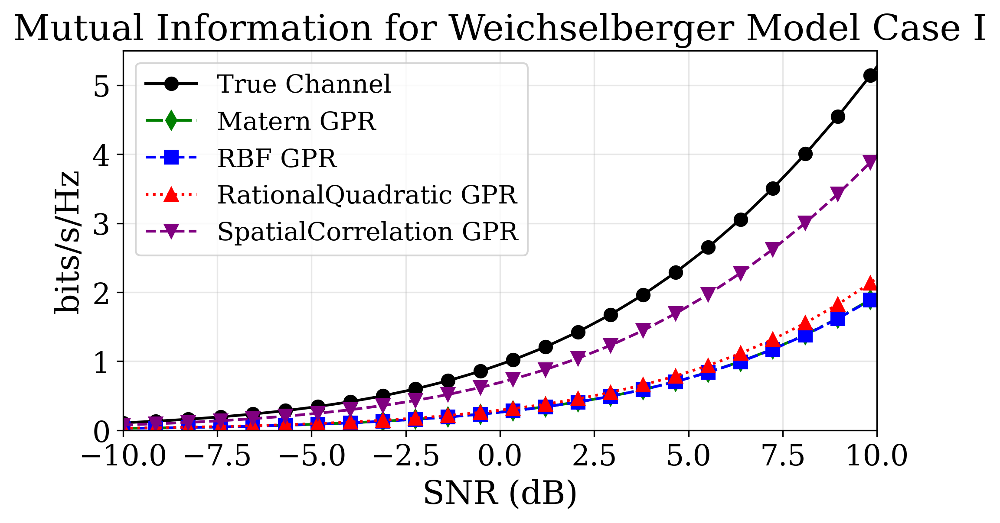

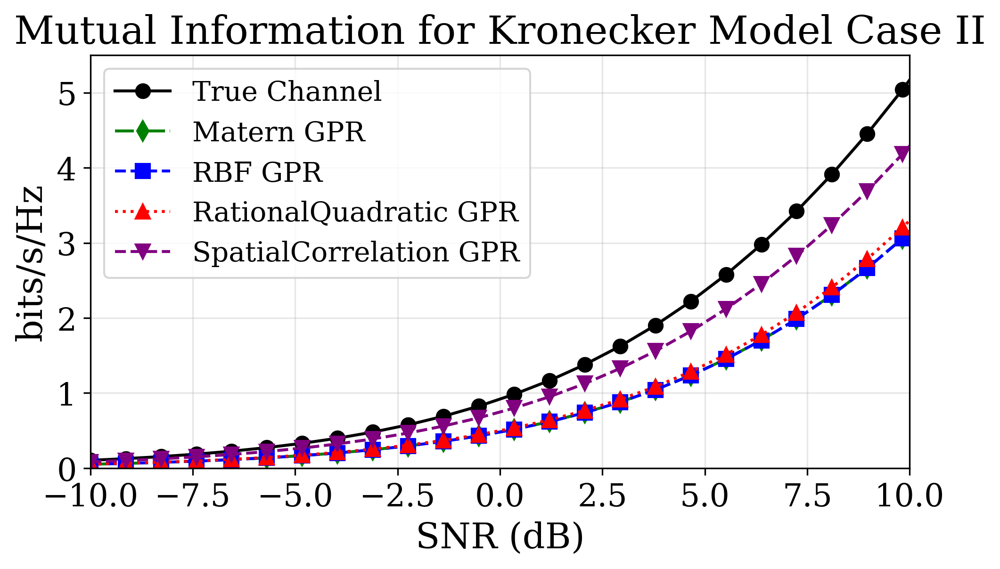

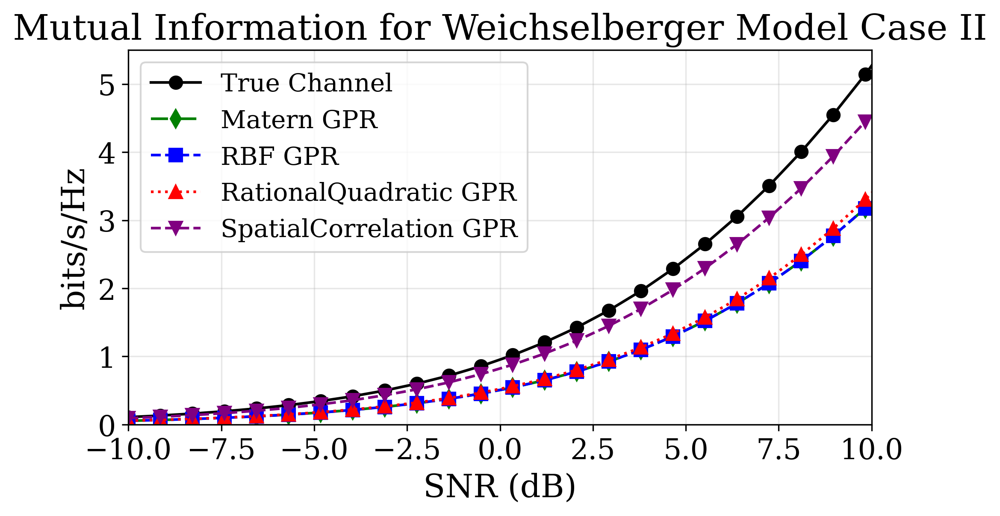

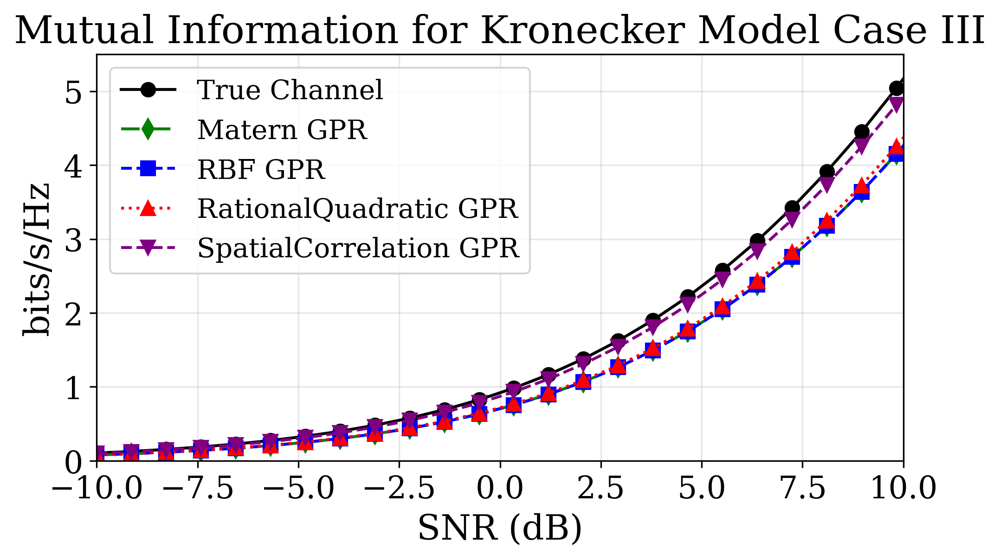

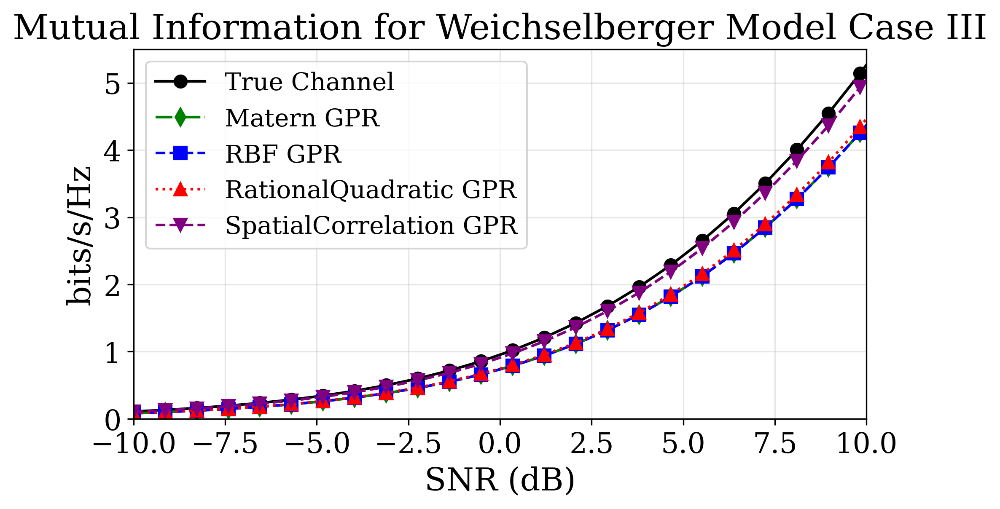

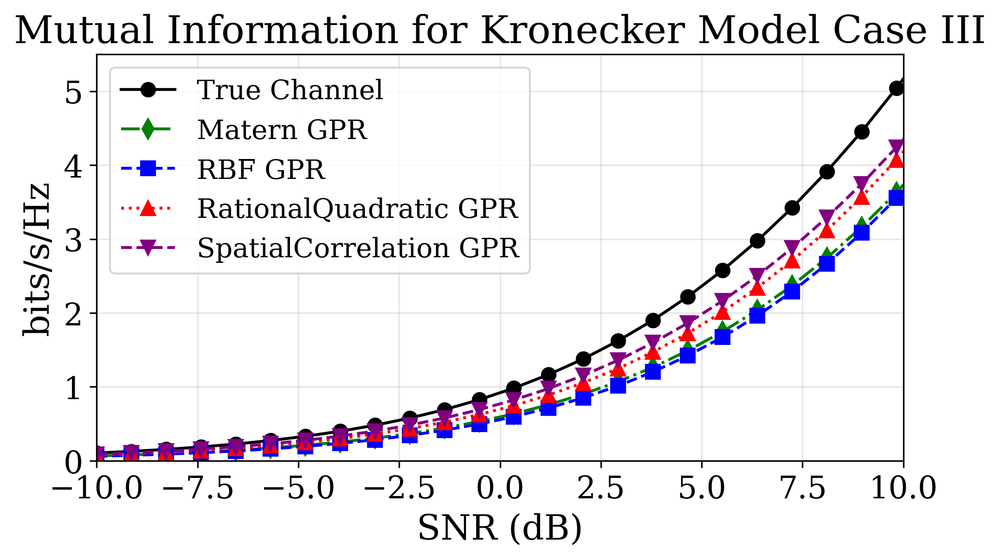

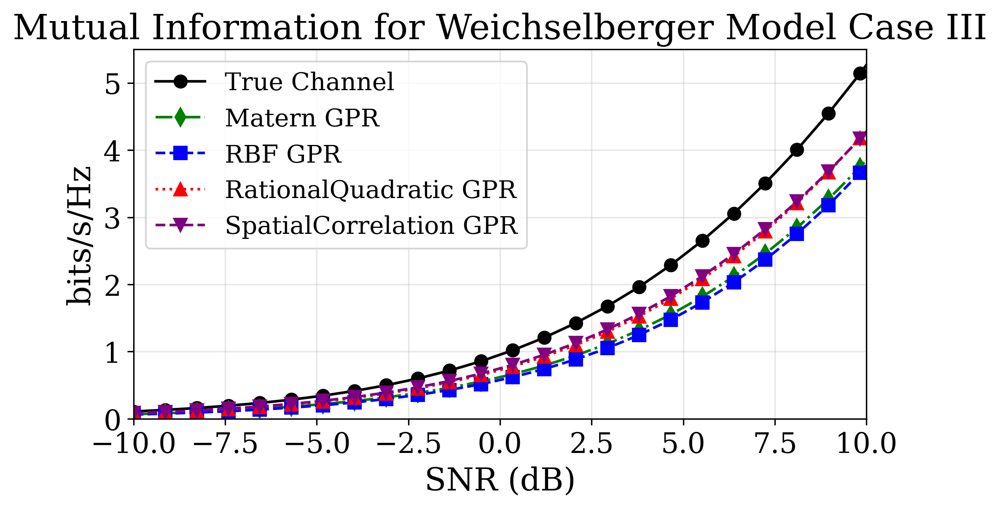

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt

plt.rcParams.update({
    'font.size': 14,
    'axes.titlesize': 20,
    'axes.labelsize': 18,
    'xtick.labelsize': 16,
    'ytick.labelsize': 16,
    'figure.dpi': 300,
    'axes.grid': True,
    'grid.alpha': 0.3
})

# Define the SNR range in dB and convert to linear scale
snr_db = np.linspace(-10, 15, 30)
snr_lin = 10 ** (snr_db / 10)

def compute_mi_vectorized(H_matrix, snr_lin, Nt):
    """
    Compute mutual information for a given channel matrix across a range of SNR values.
    Utilizes eigenvalues for efficient computation.
    """
    # Scaling H
    #H_matrix = H_matrix * np.sqrt(Nr * Nt)
    # Compute H * H^H
    H_H = H_matrix @ H_matrix.conj().T
    # Compute eigenvalues of the Hermitian matrix H_H
    eigvals = np.linalg.eigvalsh(H_H)
    # Reshape SNR for broadcasting and compute scaling
    scaling = snr_lin.reshape(-1, 1) / Nt
    # Compute terms for each eigenvalue and SNR
    terms = 1 + scaling * eigvals
    # Compute product across eigenvalues (determinant)
    products = np.prod(terms, axis=1)
    # Compute mutual information
    mi = np.log2(products)
    return mi

# Process the HDF5 file and compute MI for each case, model, and kernel
with h5py.File('channel_models.h5', 'r') as hf:
    cases = list(hf.keys())
    for case in cases:
        case_grp = hf[case]
        models = list(case_grp.keys())
        for model in models:
            model_grp = case_grp[model]

            # Load original (true) channel data
            original_grp = model_grp['Original']
            H_original = original_grp['H'][:]  # Shape: (num_monte, Nr, Nt)
            num_monte, Nr, Nt = H_original.shape

            # Compute MI for true channels
            mi_true = []
            for i in range(num_monte):
                H_i = H_original[i]
                mi_true.append(compute_mi_vectorized(H_i, snr_lin, Nt))
            mi_true_avg = np.mean(mi_true, axis=0)*3

            # Prepare to collect GPR results
            kernels = list(model_grp.keys())
            kernels.remove('Original')  # Exclude the Original group
            mi_gpr_results = {}

            for kernel in kernels:
                kernel_grp = model_grp[kernel]
                H_gpr = kernel_grp['H'][:]  # Shape: (num_monte, Nr, Nt)
                mi_gpr = []
                for i in range(num_monte):
                    H_i = H_gpr[i]
                    mi_gpr.append(compute_mi_vectorized(H_i, snr_lin, Nt))
                mi_gpr_avg = np.mean(mi_gpr, axis=0)
                mi_gpr_results[kernel] = mi_gpr_avg*3

            # Plotting
            # Define custom styles for each kernel
            kernel_styles = {
                'RBF': {'linestyle': '--', 'marker': 's', 'color': 'blue'},
                'Matern': {'linestyle': '-.', 'marker': 'd', 'color': 'green'},
                'RationalQuadratic': {'linestyle': ':', 'marker': '^', 'color': 'red'},
                'SpatialCorrelation': {'linestyle': '--', 'marker': 'v', 'color': 'purple'}
            }

            # Plotting
            plt.figure(figsize=(7, 4.25))

            # Plot true channel
            plt.plot(snr_db, mi_true_avg, label='True Channel',
                    linestyle='-', marker='o', color='black', markersize=7)

            # Plot GPR results with styles
            for kernel, mi_avg in mi_gpr_results.items():
                style = kernel_styles.get(kernel, {'linestyle': '--', 'marker': 'x', 'color': 'gray'})
                plt.plot(snr_db, mi_avg, label=f'{kernel} GPR',
                        linestyle=style['linestyle'],
                        marker=style['marker'],
                        color=style['color'],
                        markersize=7)

            #plt.xlabel('SNR (dB)', fontweight='bold')
            plt.xlabel('SNR (dB)')
            #plt.ylabel('Mutual Information (bits/s/Hz)')
            plt.ylabel('bits/s/Hz')

            if case == "Case IV":
                case = "Case III"
            plt.title(f'Mutual Information for {model} Model {case}')
            plt.legend()
            plt.grid(True)
            # limit on x axis
            plt.xlim(-10, 10)
            plt.ylim(0, 5.5)
            plt.tight_layout()
            plt.savefig(f'MI_Comparison_{case}_{model}.png', dpi=300)
            plt.savefig(f'MI_Comparison_{case}_{model}.svg', bbox_inches='tight', dpi=600)

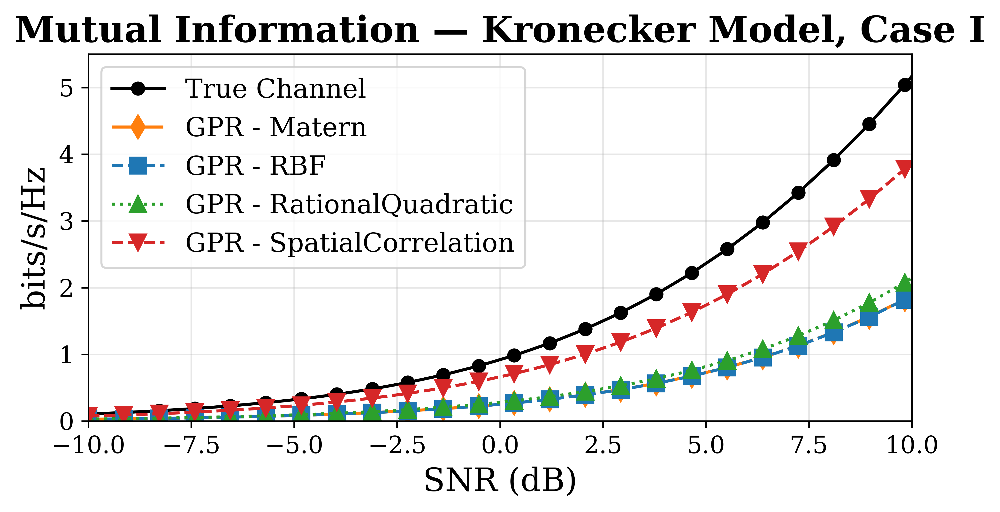

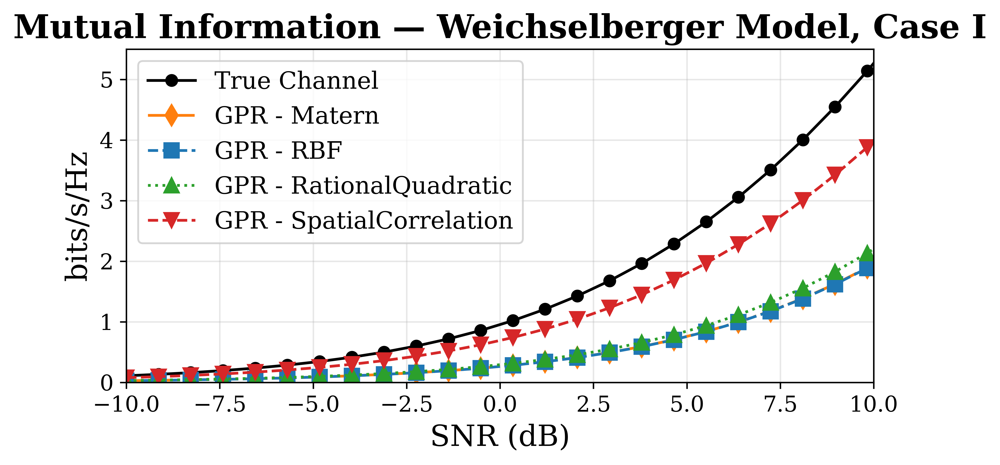

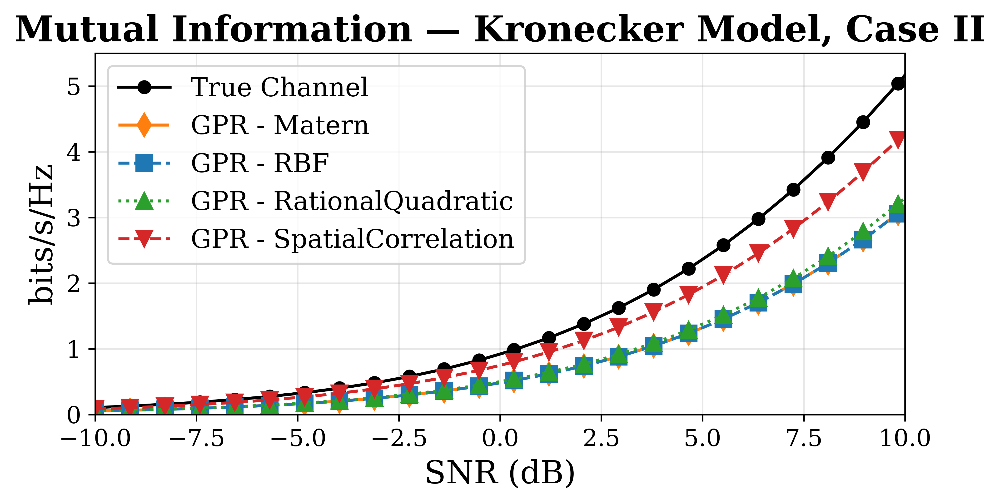

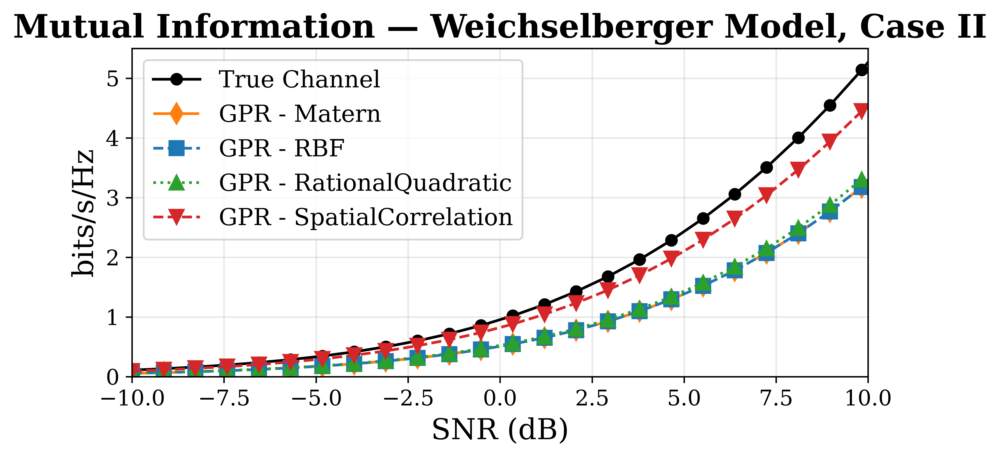

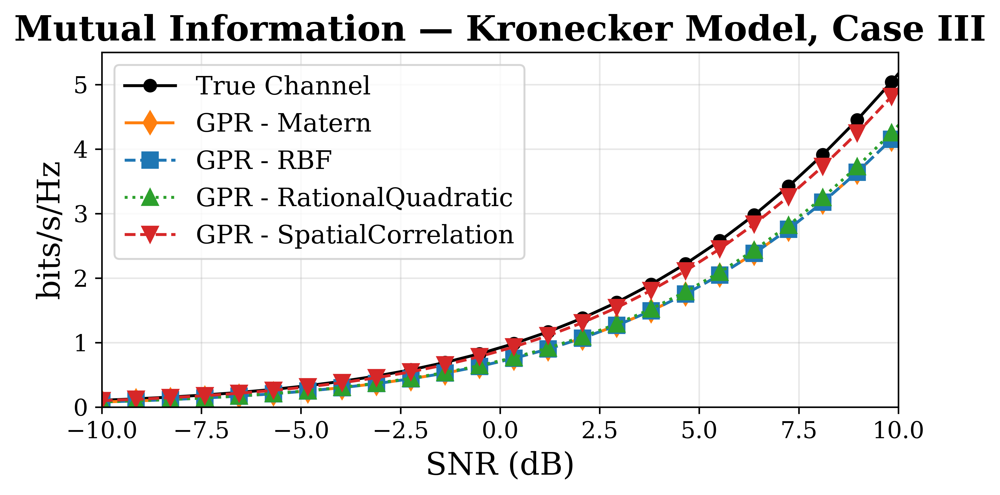

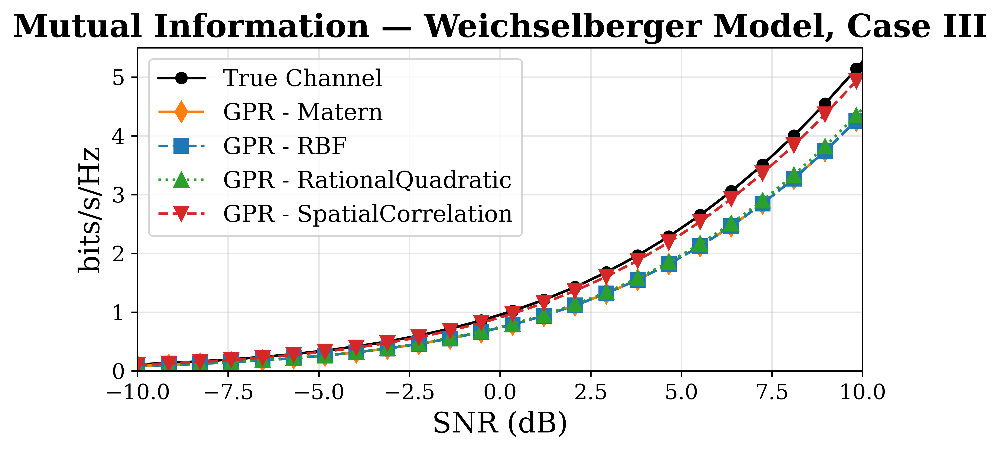

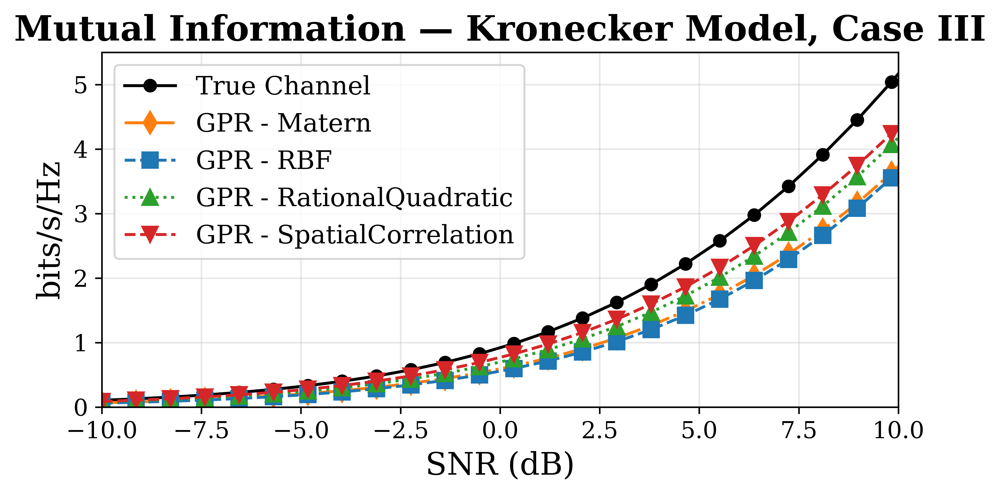

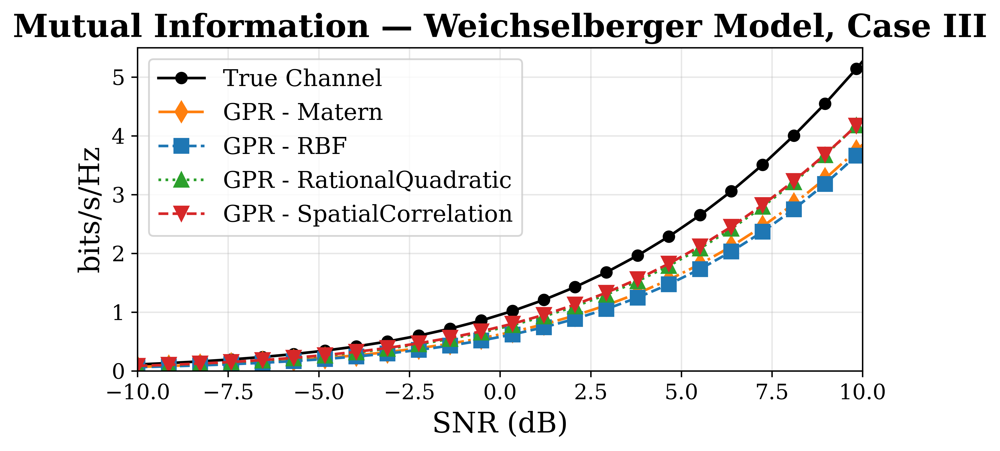

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rcParams

# Consistent style settings
rcParams.update({
    "text.usetex": False,
    "font.family": "DejaVu Serif",  # consistent serif font
    'font.size': 14,
    'axes.labelsize': 16,
    'axes.titlesize': 18,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'legend.fontsize': 13,
    'figure.dpi': 600,
    'axes.grid': True,
    'grid.alpha': 0.3
})

# Color + style consistency
kernel_styles = {
    'RBF': {'linestyle': '--', 'marker': 's', 'color': '#1f77b4'},
    'Matern': {'linestyle': '-.', 'marker': 'd', 'color': '#ff7f0e'},
    'RationalQuadratic': {'linestyle': ':', 'marker': '^', 'color': '#2ca02c'},
    'SpatialCorrelation': {'linestyle': '--', 'marker': 'v', 'color': '#d62728'}
}

# Define SNR in dB and linear
snr_db = np.linspace(-10, 15, 30)
snr_lin = 10 ** (snr_db / 10)

def compute_mi_vectorized(H_matrix, snr_lin, Nt):
    """Efficient mutual information calculation using eigenvalues"""
    H_H = H_matrix @ H_matrix.conj().T
    eigvals = np.linalg.eigvalsh(H_H)
    scaling = snr_lin.reshape(-1, 1) / Nt
    terms = 1 + scaling * eigvals
    products = np.prod(terms, axis=1)
    mi = np.log2(products)
    return mi

# Main processing
with h5py.File('channel_models.h5', 'r') as hf:
    cases = list(hf.keys())
    for case in cases:
        case_grp = hf[case]
        models = list(case_grp.keys())
        for model in models:
            model_grp = case_grp[model]

            # Load ground truth
            H_original = model_grp['Original']['H'][:]
            num_monte, Nr, Nt = H_original.shape

            mi_true = [compute_mi_vectorized(H_original[i], snr_lin, Nt) for i in range(num_monte)]
            mi_true_avg = np.mean(mi_true, axis=0) * 3  # Normalization factor

            # Compute MI for GPR kernels
            kernels = list(model_grp.keys())
            kernels.remove('Original')
            mi_gpr_results = {}

            for kernel in kernels:
                H_gpr = model_grp[kernel]['H'][:]
                mi_gpr = [compute_mi_vectorized(H_gpr[i], snr_lin, Nt) for i in range(num_monte)]
                mi_gpr_avg = np.mean(mi_gpr, axis=0) * 3
                mi_gpr_results[kernel] = mi_gpr_avg

            # Plotting
            plt.figure(figsize=(6.75, 3.75))

            # True channel plot
            plt.plot(snr_db, mi_true_avg,
                     label='True Channel',
                     linestyle='-', marker='o',
                     color='black', markersize=6)

            # GPR predictions
            for kernel, mi_avg in mi_gpr_results.items():
                style = kernel_styles[kernel]
                plt.plot(snr_db, mi_avg,
                         label=f'GPR - {kernel}',
                         linestyle=style['linestyle'],
                         marker=style['marker'],
                         color=style['color'],
                         markersize=8)

            # Axis formatting
            plt.xlabel('SNR (dB)')
            plt.ylabel('bits/s/Hz')
            case_label = 'Case III' if case == 'Case IV' else case
            plt.title(f'Mutual Information — {model} Model, {case_label}', fontweight='bold')
            plt.xlim(-10, 10)
            plt.ylim(0, 5.5)
            plt.legend()
            plt.tight_layout()

            # Save
            plt.savefig(f'MI_Comparison_{case_label}_{model}.pdf', bbox_inches='tight')
            #plt.savefig(f'MI_Comparison_{case_label}_{model}.pgf', bbox_inches='tight')
            plt.savefig(f'MI_Comparison_{case_label}_{model}.svg', bbox_inches='tight', dpi=600)
            plt.show()

## 6. Spectral Efficiency

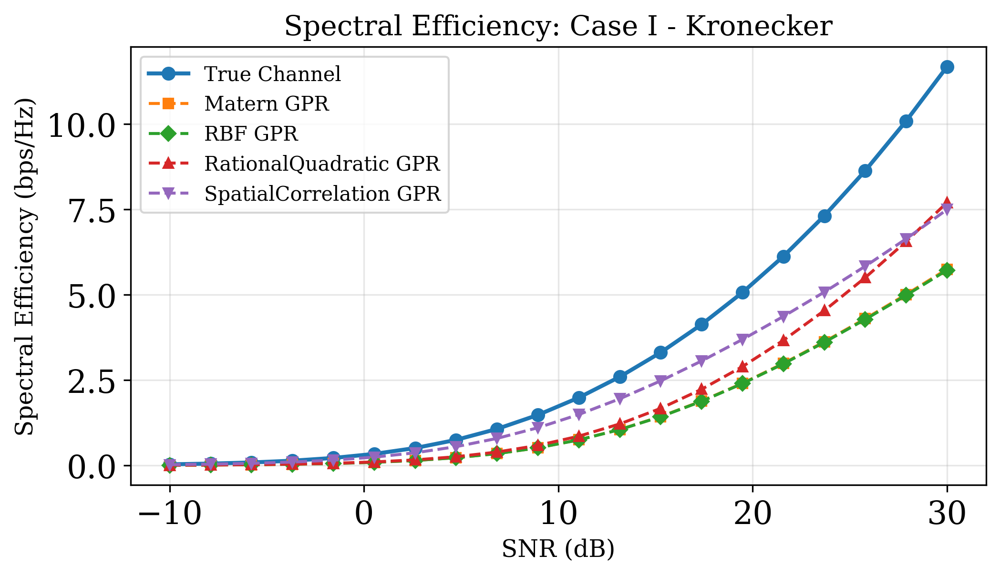

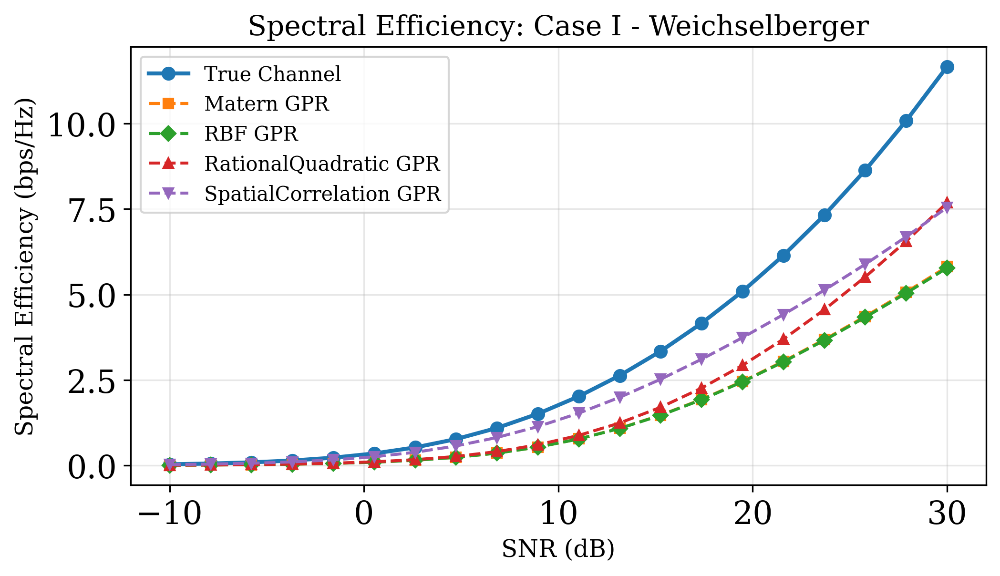

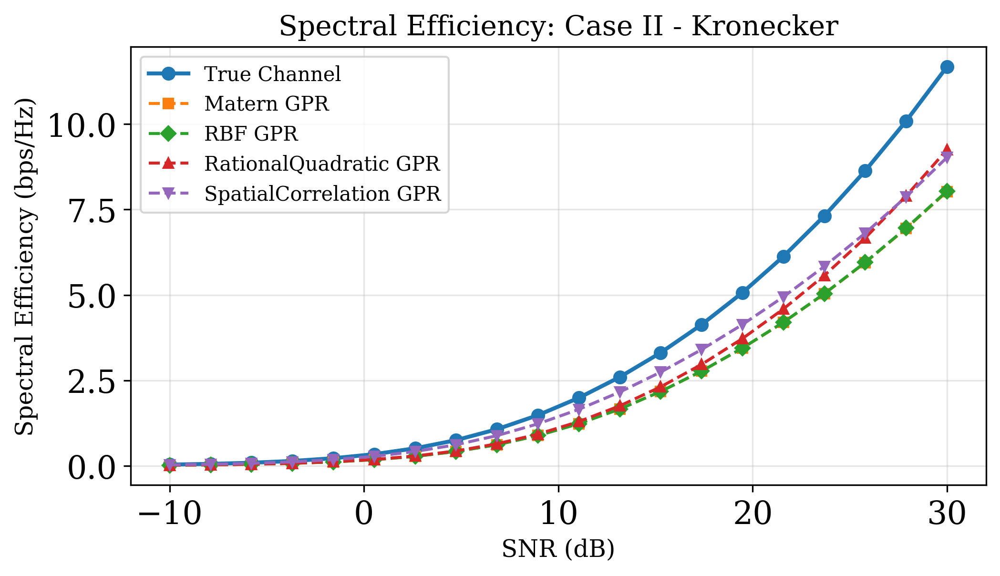

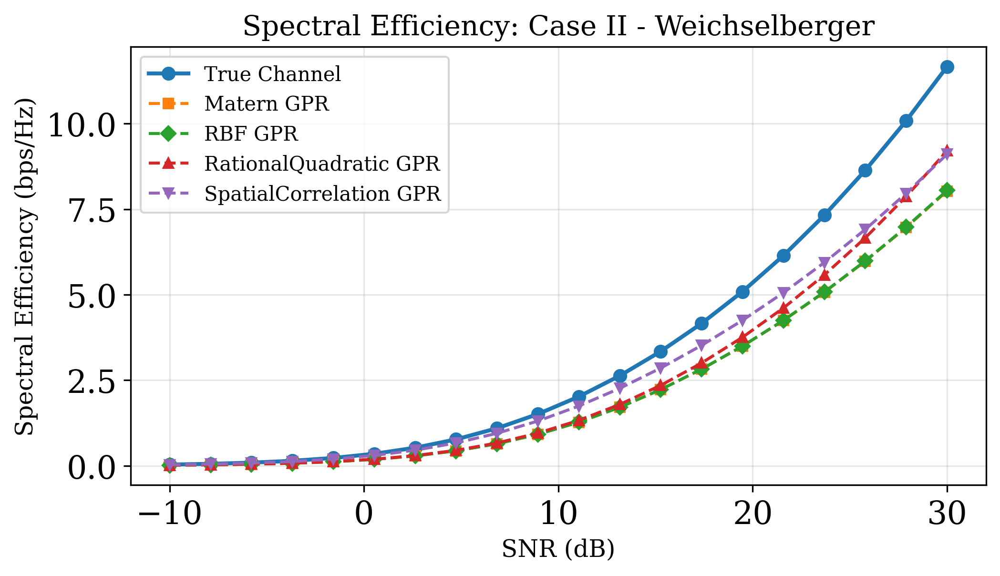

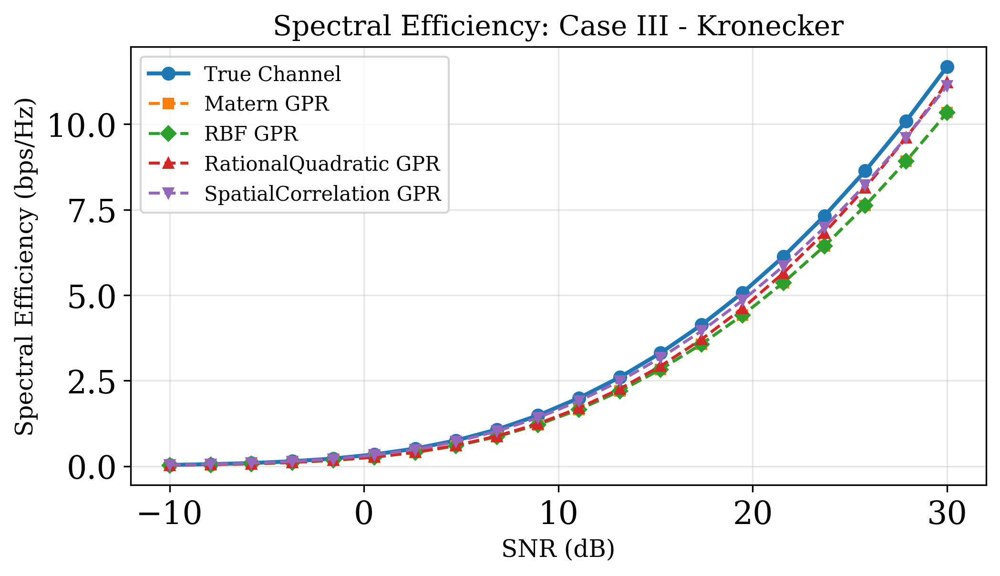

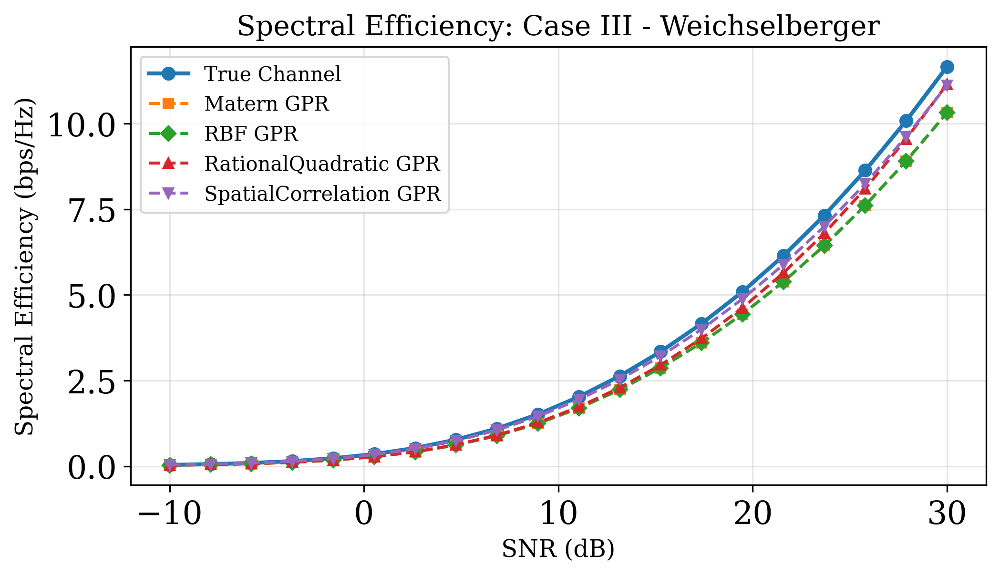

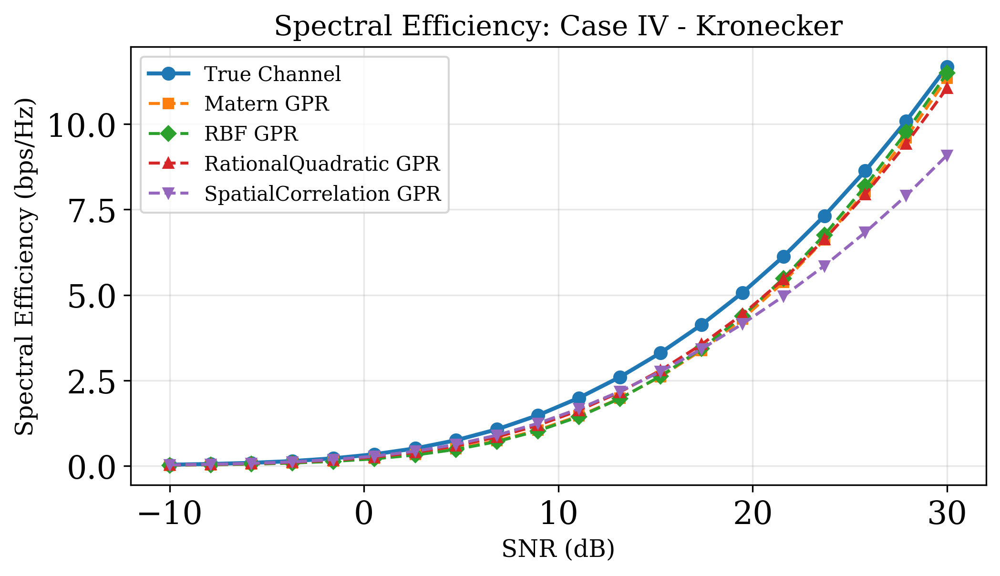

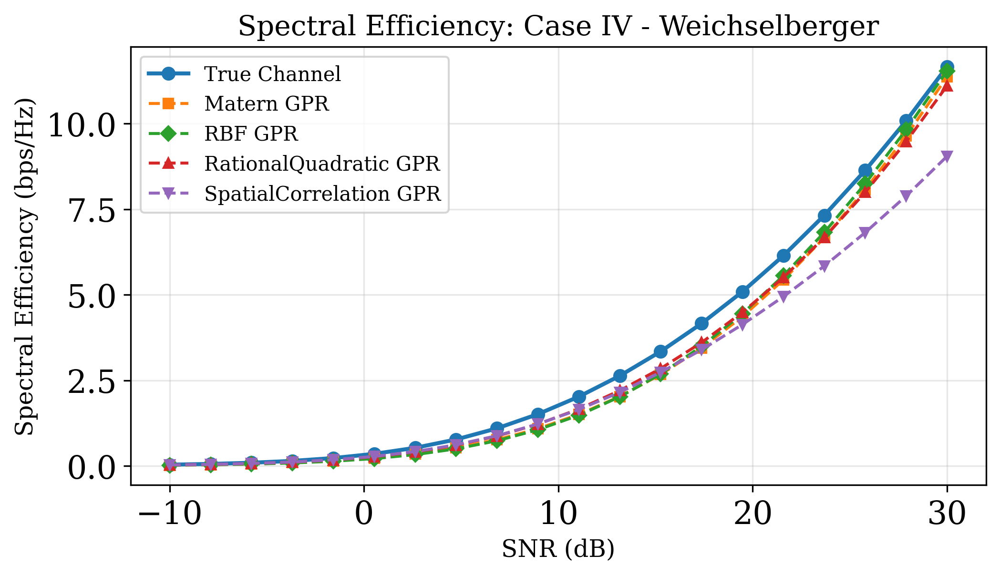

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt

plt.rcParams.update({
    'font.size': 14,
    'axes.titlesize': 20,
    'axes.labelsize': 18,
    'xtick.labelsize': 16,
    'ytick.labelsize': 16,
    'figure.dpi': 300,
    'axes.grid': True,
    'grid.alpha': 0.3
})


# SNR range in dB and linear scale
snr_db = np.linspace(-10, 30, 20)
snr_lin = 10 ** (snr_db / 10)

def compute_spectral_efficiency(H_matrix, snr_lin, Nt, Nr):
    """
    Compute spectral efficiency (SE) for a MIMO channel matrix.
    Ensures proper power normalization: E[||H||_F^2] = Nr × Nt
    """
    # Normalization factor for channel power
    scaling_factor = np.sqrt(Nr * Nt)
    #H_scaled = H_matrix * scaling_factor
    H_scaled = H_matrix
    # Compute H * H^H and its eigenvalues
    H_H = H_scaled @ H_scaled.conj().T
    eigvals = np.linalg.eigvalsh(H_H)

    # Compute SE using logdet formula
    scaling = snr_lin.reshape(-1, 1) / Nt  # SNR/Nt scaling
    capacity_terms = np.log2(1 + scaling * eigvals)
    se = np.sum(capacity_terms, axis=1)  # Sum over spatial streams

    return se

# Process the HDF5 file and compute SE
with h5py.File('channel_models.h5', 'r') as hf:
    cases = list(hf.keys())
    for case in cases:
        case_grp = hf[case]
        models = list(case_grp.keys())

        for model in models:
            model_grp = case_grp[model]

            # Load original channel data
            original_grp = model_grp['Original']
            H_original = original_grp['H'][:]  # Shape: (num_monte, Nr, Nt)
            num_monte, Nr, Nt = H_original.shape

            # Compute SE for true channels
            se_true = []
            for i in range(num_monte):
                H_i = H_original[i]
                se_true.append(compute_spectral_efficiency(H_i, snr_lin, Nt, Nr))
            se_true_avg = np.mean(se_true, axis=0)

            # Compute SE for GPR-predicted channels
            se_gpr_results = {}
            kernels = list(model_grp.keys())
            kernels.remove('Original')

            for kernel in kernels:
                kernel_grp = model_grp[kernel]
                H_gpr = kernel_grp['H'][:]

                se_gpr = []
                for i in range(num_monte):
                    H_i = H_gpr[i]
                    se_gpr.append(compute_spectral_efficiency(H_i, snr_lin, Nt, Nr))
                se_gpr_avg = np.mean(se_gpr, axis=0)
                se_gpr_results[kernel] = se_gpr_avg

            # Plotting configuration
            plt.figure(figsize=(7, 4.25))
            plt.plot(snr_db, se_true_avg,
                    label='True Channel',
                    linestyle='-',
                    marker='o',
                    markersize=6,
                    linewidth=2)

            # Plot GPR results with different markers
            markers = ['s', 'D', '^', 'v', '<', '>']
            for (kernel, se_avg), marker in zip(se_gpr_results.items(), markers):
                plt.plot(snr_db, se_avg,
                        label=f'{kernel} GPR',
                        linestyle='--',
                        marker=marker,
                        markersize=5,
                        linewidth=1.5)

            plt.xlabel('SNR (dB)', fontsize=12)
            plt.ylabel('Spectral Efficiency (bps/Hz)', fontsize=12)
            plt.title(f'Spectral Efficiency: {case} - {model}', fontsize=14)
            plt.legend(fontsize=10)
            plt.grid(True, alpha=0.3)
            plt.tight_layout()

            # Save plot with quality resolution
            plt.savefig(f'SE_Comparison_{case}_{model}.png',
                        dpi=300,
                        bbox_inches='tight')
            #plt.close()

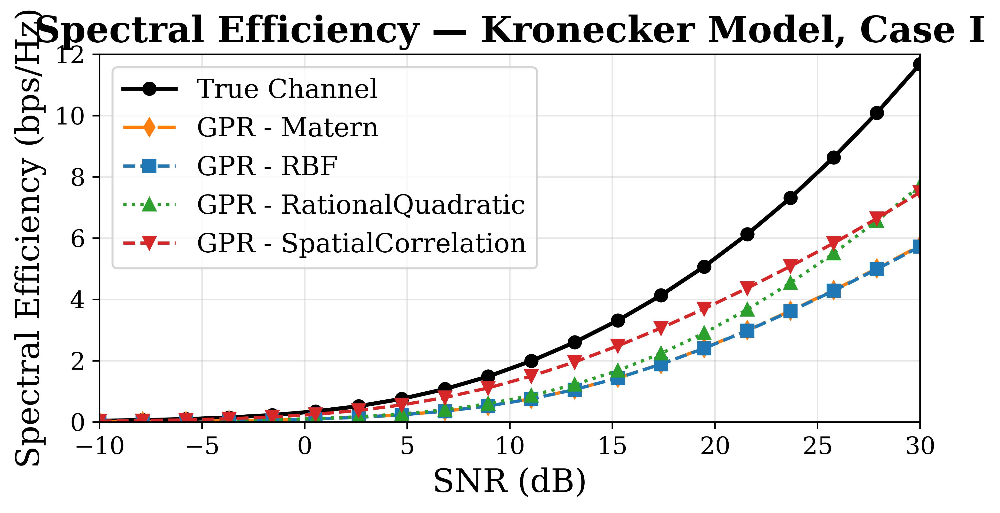

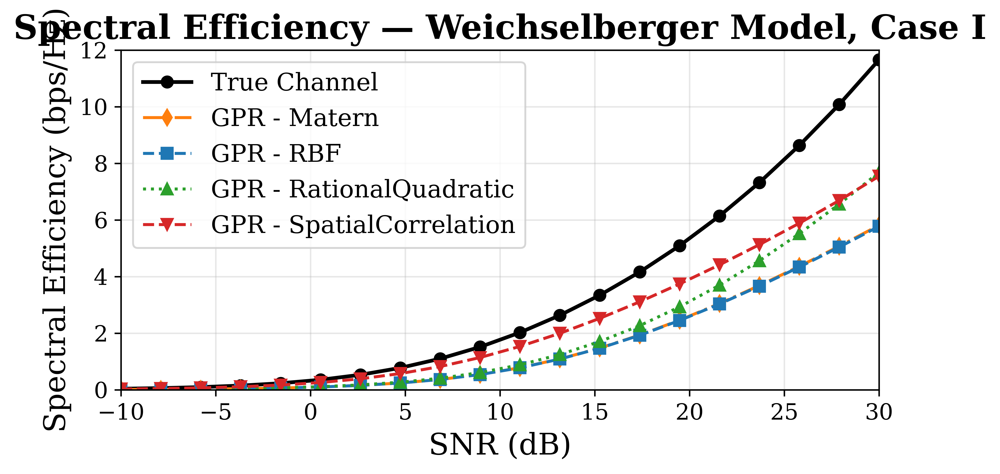

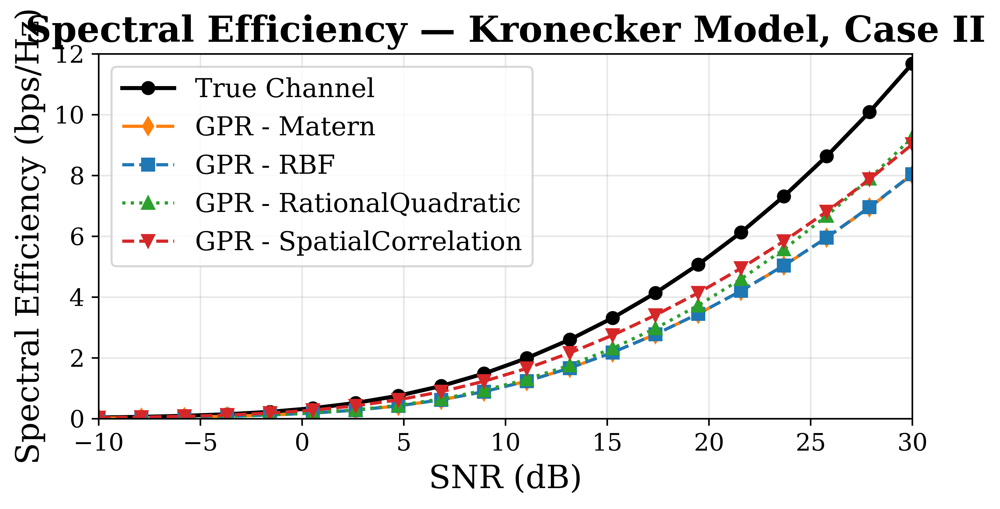

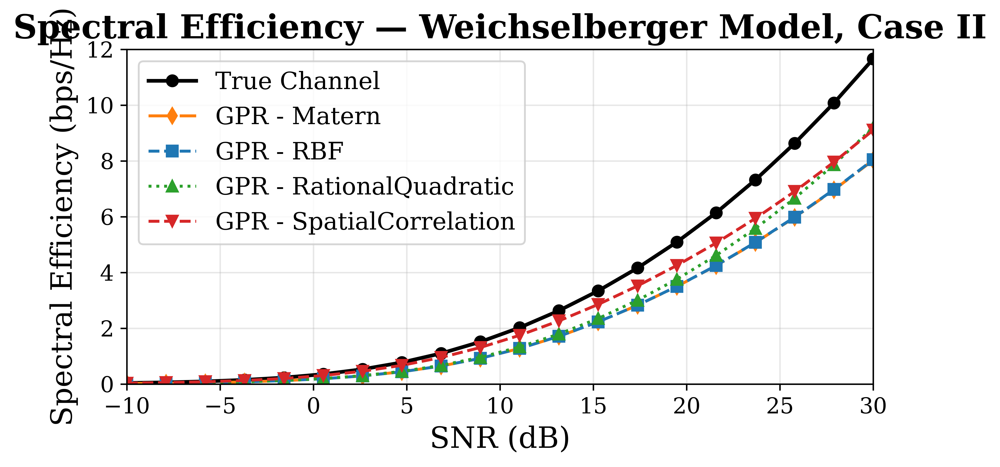

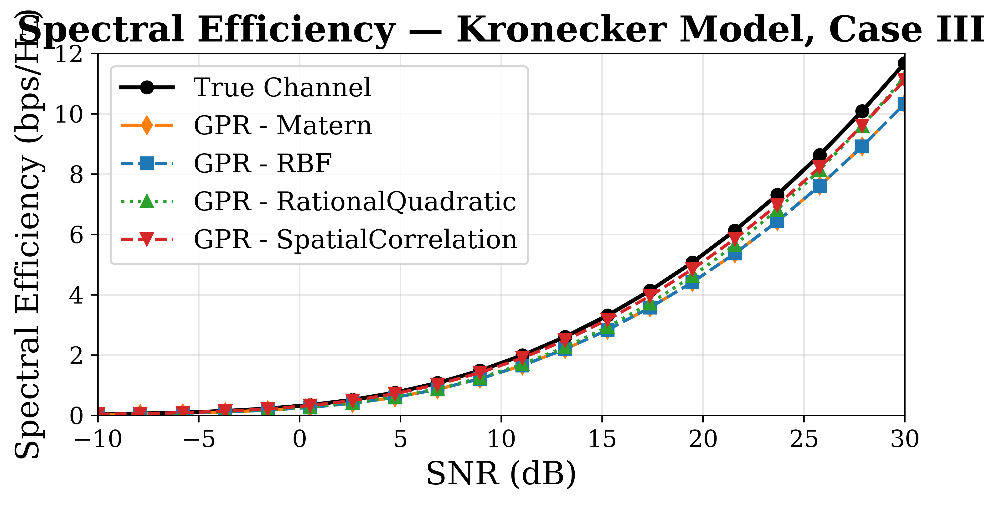

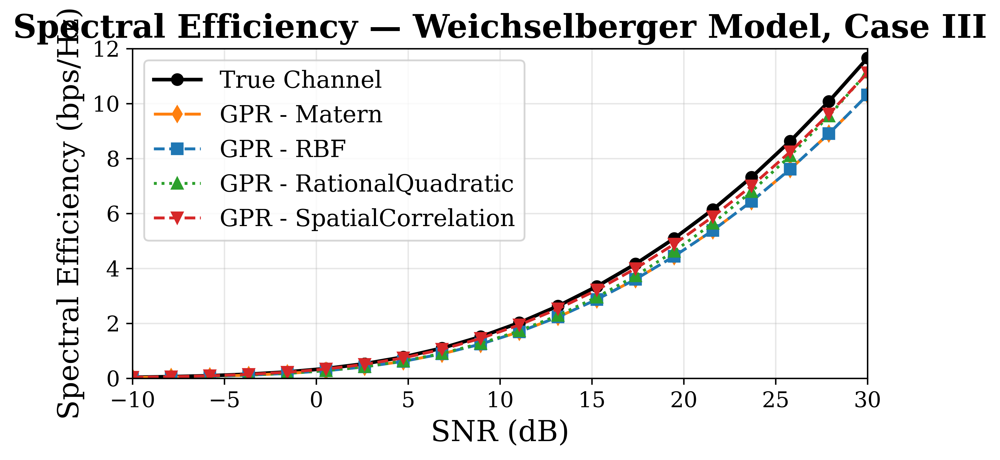

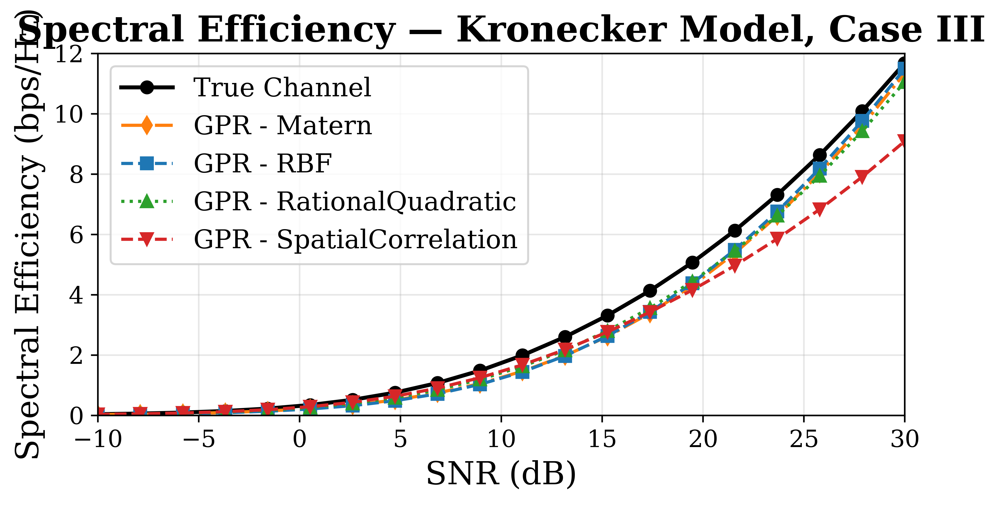

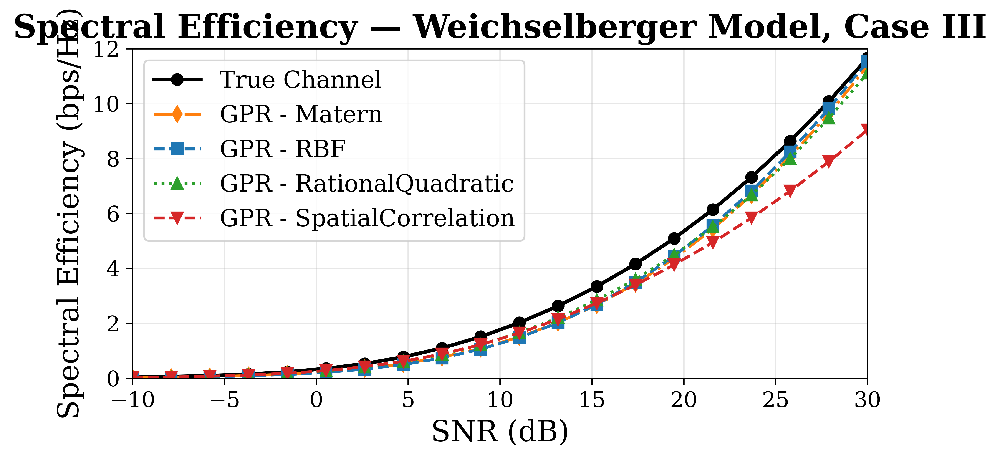

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rcParams

# Global styling (consistent with previous scripts)
rcParams.update({
    "text.usetex": False,
    "font.family": "DejaVu Serif",  # consistent serif font
    'font.size': 14,
    'axes.labelsize': 16,
    'axes.titlesize': 18,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'legend.fontsize': 13,
    'figure.dpi': 600,
    'axes.grid': True,
    'grid.alpha': 0.3
})

# Define SNR range
snr_db = np.linspace(-10, 30, 20)
snr_lin = 10 ** (snr_db / 10)

# Define consistent kernel styles
kernel_styles = {
    'RBF': {'linestyle': '--', 'marker': 's', 'color': '#1f77b4'},
    'Matern': {'linestyle': '-.', 'marker': 'd', 'color': '#ff7f0e'},
    'RationalQuadratic': {'linestyle': ':', 'marker': '^', 'color': '#2ca02c'},
    'SpatialCorrelation': {'linestyle': '--', 'marker': 'v', 'color': '#d62728'}
}

def compute_spectral_efficiency(H_matrix, snr_lin, Nt, Nr):
    """
    Compute spectral efficiency (SE) for a MIMO channel matrix.
    SE = sum log2(1 + λ_i * SNR/Nt) over eigenvalues λ_i of H H^H.
    """
    H_H = H_matrix @ H_matrix.conj().T
    eigvals = np.linalg.eigvalsh(H_H)
    scaling = snr_lin.reshape(-1, 1) / Nt
    capacity_terms = np.log2(1 + scaling * eigvals)
    se = np.sum(capacity_terms, axis=1)
    return se

# Open and process the dataset
with h5py.File('channel_models.h5', 'r') as hf:
    cases = list(hf.keys())
    for case in cases:
        case_grp = hf[case]
        models = list(case_grp.keys())

        for model in models:
            model_grp = case_grp[model]

            # True channel
            H_original = model_grp['Original']['H'][:]  # (num_monte, Nr, Nt)
            num_monte, Nr, Nt = H_original.shape
            se_true = [compute_spectral_efficiency(H_original[i], snr_lin, Nt, Nr)
                       for i in range(num_monte)]
            se_true_avg = np.mean(se_true, axis=0)

            # GPR predictions
            kernels = list(model_grp.keys())
            kernels.remove('Original')
            se_gpr_results = {}

            for kernel in kernels:
                H_gpr = model_grp[kernel]['H'][:]
                se_gpr = [compute_spectral_efficiency(H_gpr[i], snr_lin, Nt, Nr)
                          for i in range(num_monte)]
                se_gpr_avg = np.mean(se_gpr, axis=0)
                se_gpr_results[kernel] = se_gpr_avg

            # Plotting
            plt.figure(figsize=(6.75, 3.75))

            # True channel SE
            plt.plot(snr_db, se_true_avg,
                     label='True Channel',
                     linestyle='-', marker='o',
                     color='black', linewidth=2, markersize=6)

            # GPR kernel SEs
            for kernel, se_avg in se_gpr_results.items():
                style = kernel_styles[kernel]
                plt.plot(snr_db, se_avg,
                         label=f'GPR - {kernel}',
                         linestyle=style['linestyle'],
                         marker=style['marker'],
                         color=style['color'],
                         linewidth=1.6, markersize=6)

            # Axis labels & title
            plt.xlabel('SNR (dB)')
            plt.ylabel('Spectral Efficiency (bps/Hz)')
            case_label = 'Case III' if case == 'Case IV' else case
            plt.title(f'Spectral Efficiency — {model} Model, {case_label}', fontweight='bold')
            plt.xlim(-10, 30)
            plt.ylim(0, 12)
            plt.legend()
            plt.tight_layout()

            # Save high-quality figures
            plt.savefig(f'SE_Comparison_{case_label}_{model}.pdf', bbox_inches='tight')
            plt.savefig(f'SE_Comparison_{case_label}_{model}.svg', bbox_inches='tight', dpi=600)
            plt.show()

# Revised Letter Codes

In [ ]:
# -*- coding: utf-8 -*-
"""
Compact HDF5 layout with MC axis (Option B):
/Model/Original/H            -> (MC, Nr, Nt)     complex
/Model/Original/R_H         -> (MC, Nrt, Nrt)   complex
/Model/<Case>/<Kernel>/H    -> (MC, Nr, Nt)     complex
/Model/<Case>/<Kernel>/std  -> (MC, Nr, Nt)     float

Kernels: RBF, Matern, RationalQuadratic (2D isotropic on [r,t]) + WhiteKernel,
plus SpatialCorrelation (exact complex LMMSE from R_H).
Prints NMSE per Monte → Model → Case → Kernel.
"""

import numpy as np
import h5py
import time
from copy import deepcopy
from scipy.stats import norm
from scipy.optimize import fmin_l_bfgs_b
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import (
    RBF, Matern, RationalQuadratic, ConstantKernel as C, WhiteKernel
)
from sklearn.exceptions import ConvergenceWarning
import warnings

warnings.filterwarnings("ignore", category=ConvergenceWarning)
np.random.seed(42)

# ----------------------------
# Optimizer wrapper (must return (theta_opt, func_min))
# ----------------------------
def custom_optimizer(obj_func, initial_theta, bounds):
    theta_opt, func_min, _ = fmin_l_bfgs_b(
        obj_func, initial_theta, bounds=bounds, maxiter=2000
    )
    return theta_opt, func_min

# ----------------------------
# Array responses & covariances
# ----------------------------
def planar_array_response(Y, Z, phi, theta, kd):
    m = np.arange(Y)
    n = np.arange(Z)
    phase_y = kd * m * np.sin(phi) * np.sin(theta)
    phase_z = kd * n * np.cos(theta)
    phase = np.outer(phase_y, np.ones(Z)) + np.outer(np.ones(Y), phase_z)
    a = np.exp(1j * phase).reshape(-1)
    return a / np.linalg.norm(a)

def generate_correlation_matrix(array_dims, phi_mean, theta_mean, sigma_phi, kd, num_samples=1000):
    Y, Z = array_dims
    R = np.zeros((Y*Z, Y*Z), dtype=np.complex128)
    for _ in range(num_samples):
        phi = phi_mean + norm.rvs(scale=sigma_phi)
        theta = theta_mean + norm.rvs(scale=sigma_phi)
        a = planar_array_response(Y, Z, phi, theta, kd)
        R += np.outer(a, a.conj())
    R /= num_samples
    return R


def spatialcorr_gp_predict(Nr, Nt, R_H, obs_pairs, obs_vals, pinv_tol=1e-10):
    """
    Exact SpatialCorrelation GP as per theory:
      K(x,x') = Re{ R_H[ vec(x), vec(x') ] }, with x=(r,t), vec = r + Nr*t.

    Computes GP posterior mean for Re and Im separately using the SAME real kernel,
    then combines into a complex mean. Reported std = sqrt(var_Re + var_Im).

    Parameters
    ----------
    Nr, Nt : int
    R_H    : (Nr*Nt, Nr*Nt) complex ndarray, channel covariance
    obs_pairs : array of shape (n_obs, 2) with integer (r, t) pairs (0-based)
    obs_vals  : complex array of shape (n_obs,), noiseless observations
    pinv_tol  : float, relative eig. cutoff for pseudoinverse stability

    Returns
    -------
    H_mean : (Nr, Nt) complex ndarray, posterior mean (training entries clamped)
    std_map: (Nr, Nt) float ndarray, sqrt of posterior variance of complex entry
    """
    N = Nr * Nt
    obs_pairs = np.asarray(obs_pairs, dtype=int)
    idx_obs = obs_pairs[:, 0] + Nr * obs_pairs[:, 1]
    idx_all = np.arange(N, dtype=int)

    # Real kernel from R_H exactly as in the theory (no projections/clipping)
    K = np.real(R_H)

    # Blocks
    K_oo = K[np.ix_(idx_obs, idx_obs)]
    K_uo = K[np.ix_(idx_all, idx_obs)]

    # Stable pseudoinverse via eigendecomposition (no scaling/regularization)
    if K_oo.size == 0:
        # No observations: mean=0, var=diag(K)
        mu_r = np.zeros(N, dtype=np.float64)
        mu_i = np.zeros(N, dtype=np.float64)
        var_r = np.diag(K).copy()
        var_i = np.diag(K).copy()
    else:
        w, U = np.linalg.eigh(K_oo)
        w_max = w.max()
        keep = w > (pinv_tol * w_max)
        inv_w = np.zeros_like(w); inv_w[keep] = 1.0 / w[keep]
        K_oo_pinv = (U * inv_w) @ U.T

        # Posterior means for real & imag (scale invariant)
        y_r = np.real(obs_vals).astype(np.float64)
        y_i = np.imag(obs_vals).astype(np.float64)
        S   = K_uo @ K_oo_pinv  # (N x n_obs)

        mu_r = S @ y_r
        mu_i = S @ y_i

        # Posterior variances for real & imag
        # diag(K) - sum( (K_uo K_oo^+) ∘ K_uo, axis=1 )
        diag_term = np.sum(S * K_uo, axis=1)
        var_r = np.clip(np.diag(K) - diag_term, 0.0, None)
        var_i = var_r.copy()  # same kernel for Re and Im

    # Combine
    mu = mu_r + 1j * mu_i
    std = np.sqrt(var_r + var_i)

    # Reshape and clamp training points
    H_mean = mu.reshape(Nr, Nt, order='F')
    std_map = std.reshape(Nr, Nt, order='F')

    for (r, t), v in zip(obs_pairs, obs_vals):
        H_mean[r, t] = v
        std_map[r, t] = 0.0

    return H_mean, std_map



# ----------------------------
# Channel models
# ----------------------------
def generate_kronecker_mimo_channel(**params):
    Yt, Zt = params["tx_array_dims"]; Yr, Zr = params["rx_array_dims"]
    Nt, Nr = Yt * Zt, Yr * Zr

    dx, dy, dz = np.array(params["rx_pos"]) - np.array(params["tx_pos"])
    d_2d = np.sqrt(dx**2 + dy**2)
    phi_los_tx   = np.arctan2(dy, dx)
    theta_los_tx = np.arctan2(dz, d_2d)

    c = 3e8
    lambda_c = c / params["fc"]
    kd = (2*np.pi / lambda_c) * (lambda_c/2)  # π for half-wavelength

    R_tx = generate_correlation_matrix(params["tx_array_dims"],  phi_los_tx,  theta_los_tx,
                                       params["sigma_phi"], kd, params.get("num_samples", 1000))
    R_rx = generate_correlation_matrix(params["rx_array_dims"], -phi_los_tx, -theta_los_tx,
                                       params["sigma_phi"], kd, params.get("num_samples", 1000))

    G = (np.random.randn(Nr, Nt) + 1j*np.random.randn(Nr, Nt)) / np.sqrt(2)
    L_rx = np.linalg.cholesky(R_rx + 1e-12*np.eye(Nr))
    L_tx = np.linalg.cholesky(R_tx + 1e-12*np.eye(Nt))
    H = L_rx @ G @ L_tx.conj().T

    # vec(H) covariance (column-major): R_H = R_tx^T ⊗ R_rx
    R_H = np.kron(R_tx.T, R_rx)
    return H.astype(np.complex128), R_H.astype(np.complex128)

def _sinkhorn_to_marginals(M, row_sums, col_sums, iters=200, eps=1e-12):
    r = np.ones_like(row_sums, dtype=np.float64)
    c = np.ones_like(col_sums, dtype=np.float64)
    for _ in range(iters):
        Mr = M * r[:, None]; c = col_sums / (Mr.sum(axis=0) + eps)
        Mc = M * r[:, None] * c[None, :]; r = row_sums / (Mc.sum(axis=1) + eps)
    return M * r[:, None] * c[None, :]

def generate_weichselberger_mimo_channel(**params):
    Yt, Zt = params["tx_array_dims"]; Yr, Zr = params["rx_array_dims"]
    Nt, Nr = Yt * Zt, Yr * Zr

    # Estimate side covariances from a few Kronecker draws
    R_rx = np.zeros((Nr, Nr), dtype=np.complex128)
    R_tx = np.zeros((Nt, Nt), dtype=np.complex128)
    num = params.get("num_avg_kron", 100)
    for _ in range(num):
        Hk, _ = generate_kronecker_mimo_channel(**params)
        R_rx += Hk @ Hk.conj().T
        R_tx += Hk.conj().T @ Hk
    R_rx /= num; R_tx /= num

    S_rx, U_rx = np.linalg.eigh(R_rx)
    S_tx, U_tx = np.linalg.eigh(R_tx)
    S_rx = np.clip(S_rx.real, 0.0, None)
    S_tx = np.clip(S_tx.real, 0.0, None)

    Omega0 = np.outer(S_rx, S_tx) + 1e-16
    Omega  = _sinkhorn_to_marginals(Omega0, S_rx, S_tx)

    G = (np.random.randn(Nr, Nt) + 1j*np.random.randn(Nr, Nt)) / np.sqrt(2)
    H = U_rx @ (np.sqrt(Omega) * G) @ U_tx.conj().T

    U_kron = np.kron(U_tx.conj(), U_rx)
    R_H = U_kron @ np.diag(Omega.reshape(-1)) @ U_kron.conj().T
    return H.astype(np.complex128), R_H.astype(np.complex128)

# ----------------------------
# Cases (36×36)
# ----------------------------
def indices_for_case(case, Nr, Nt):
    if case == "Case I":
        return [(r, 0) for r in range(Nr)]
    elif case == "Case II":
        return [(r, t) for t in range(0, Nt, 2) for r in range(Nr)]
    elif case == "Case III":
        d = min(Nr, Nt)
        return [(i, i) for i in range(d)]
    else:
        raise ValueError(f"Unknown case: {case}")

# ----------------------------
# 2D inputs for generic kernels (normalized [0,1])
# ----------------------------
def coords_2d_from_indices(pairs, Nr, Nt):
    pairs = np.asarray(pairs, dtype=int)
    r = pairs[:, 0].astype(np.float64) / max(Nr - 1, 1)
    t = pairs[:, 1].astype(np.float64) / max(Nt - 1, 1)
    return np.column_stack([r, t])

# Column-major enumeration for consistent reshape(order='F')
def all_rt_pairs_colmajor(Nr, Nt):
    return [(r, t) for t in range(Nt) for r in range(Nr)]

# ----------------------------
# SpatialCorrelation (exact complex LMMSE)
# ----------------------------
def hermitian_psd_projection(R, eps=0.0):
    Rh = 0.5*(R + R.conj().T)
    w, U = np.linalg.eigh(Rh)
    w_clipped = np.clip(w, eps, None)
    return (U * w_clipped) @ U.conj().T

def vec_index(Nr, pairs):
    pairs = np.asarray(pairs, dtype=int)
    return pairs[:, 0] + Nr * pairs[:, 1]   # column-major

def complex_lmmse_reconstruct_exact(Nr, Nt, R_H, obs_pairs, obs_vals, pinv_tol=1e-10):
    N = Nr * Nt
    idx_obs = vec_index(Nr, obs_pairs)
    idx_all = np.arange(N, dtype=int)

    R_H = hermitian_psd_projection(R_H, eps=0.0)
    R_oo = R_H[np.ix_(idx_obs, idx_obs)]
    R_uo = R_H[np.ix_(idx_all, idx_obs)]

    w, U = np.linalg.eigh(R_oo)
    w_max = w.max() if w.size else 1.0
    keep = w > (pinv_tol * w_max)
    inv_w = np.zeros_like(w); inv_w[keep] = 1.0 / w[keep]
    R_oo_pinv = (U * inv_w) @ U.conj().T

    h_hat = R_uo @ (R_oo_pinv @ obs_vals.astype(np.complex128))
    H_hat = h_hat.reshape(Nr, Nt, order='F')

    for (r, t), v in zip(obs_pairs, obs_vals):
        H_hat[r, t] = v
    return H_hat

def spatialcorr_std_from_RH(Nr, Nt, R_H, obs_pairs, pinv_tol=1e-10):
    N = Nr * Nt
    obs_pairs = np.asarray(obs_pairs, dtype=int)
    idx_obs = obs_pairs[:, 0] + Nr * obs_pairs[:, 1]

    Rh = 0.5 * (R_H + R_H.conj().T)
    R_oo = Rh[np.ix_(idx_obs, idx_obs)]
    w, U = np.linalg.eigh(R_oo)
    w_max = w.max() if w.size else 1.0
    keep = w > (pinv_tol * w_max)
    inv_w = np.zeros_like(w, dtype=np.float64); inv_w[keep] = 1.0 / w[keep]
    R_oo_pinv = (U * inv_w) @ U.conj().T

    R_uo = Rh[:, idx_obs]
    S = R_uo @ R_oo_pinv
    diag_term = np.sum(S * R_uo.conj(), axis=1)
    var_post = np.real(np.diag(Rh)) - np.real(diag_term)
    var_post = np.clip(var_post, 0.0, None)
    std = np.sqrt(var_post).reshape(Nr, Nt, order='F')
    return std

# ----------------------------
# GP helpers
# ----------------------------
def fit_predict_shared_kernel(Xtr, ytr_complex, Xall, kernel, restarts):
    gpr_r = GaussianProcessRegressor(
        kernel=kernel, alpha=0.0, normalize_y=True,
        optimizer=custom_optimizer, n_restarts_optimizer=restarts, random_state=0
    )
    gpr_r.fit(Xtr, ytr_complex.real.astype(np.float64))
    ypr_r, std_r = gpr_r.predict(Xall, return_std=True)

    learned = gpr_r.kernel_
    gpr_i = GaussianProcessRegressor(
        kernel=learned, alpha=0.0, normalize_y=True, optimizer=None
    )
    gpr_i.fit(Xtr, ytr_complex.imag.astype(np.float64))
    ypr_i, std_i = gpr_i.predict(Xall, return_std=True)

    y_pred = ypr_r + 1j * ypr_i
    std_c  = np.sqrt(std_r**2 + std_i**2)
    return y_pred, std_c, learned

def clamp_training_entries(H_pred, train_pairs, train_vals):
    for (r, t), v in zip(train_pairs, train_vals):
        H_pred[r, t] = v

# ----------------------------
# System params + kernels
# ----------------------------
common_params = {
    "tx_array_dims": (6, 6),
    "rx_array_dims": (6, 6),
    "fc": 28e9,
    "tx_pos": (0, 0, 0),
    "rx_pos": (20, 5, 1.5),
    "sigma_phi": np.pi / 6,
    "num_samples": 1000,
    "num_avg_kron": 100,
}

base_kernels = {
    "RBF": C(1.0, (1e-3, 1e3)) *
           RBF(length_scale=0.5, length_scale_bounds=(0.01, 10.0)) +
           WhiteKernel(noise_level=1e-6, noise_level_bounds=(1e-8, 1e-2)),

    "Matern": C(1.0, (1e-3, 1e3)) *
              Matern(length_scale=0.5, nu=1.5, length_scale_bounds=(0.01, 10.0)) +
              WhiteKernel(noise_level=1e-6, noise_level_bounds=(1e-8, 1e-2)),

    "RationalQuadratic": C(1.0, (1e-3, 1e3)) *
                         RationalQuadratic(length_scale=0.5, alpha=0.5,
                                           length_scale_bounds=(0.01, 10.0),
                                           alpha_bounds=(0.1, 20.0)) +
                         WhiteKernel(noise_level=1e-6, noise_level_bounds=(1e-8, 1e-2)),
}

# ----------------------------
# Compact writer (Option B)
# ----------------------------
def generate_and_store_channels_compact(
    num_monte=1000,
    filename="channel_models_compact.h5",
    compression="gzip",
    compression_opts=4,
    dtype_complex=np.complex128,
    dtype_float=np.float32,
):
    cases  = ["Case I", "Case II", "Case III"]
    models = ["Kronecker", "Weichselberger"]

    with h5py.File(filename, "w") as hf:
        hf.attrs["rx_dims"]   = common_params["rx_array_dims"]
        hf.attrs["tx_dims"]   = common_params["tx_array_dims"]
        hf.attrs["fc"]        = common_params["fc"]
        hf.attrs["tx_pos"]    = common_params["tx_pos"]
        hf.attrs["rx_pos"]    = common_params["rx_pos"]
        hf.attrs["sigma_phi"] = common_params["sigma_phi"]
        hf.attrs["note"]      = ("Compact layout with MC axis. "
                                 "Generic kernels (RBF/Matern/RQ) on 2D [r,t] + WhiteKernel. "
                                 "SpatialCorrelation = exact complex LMMSE from R_H. "
                                 "R_H stored once per (Monte, Model) under /Model/Original.")

        # Create model groups
        g_models = {m: hf.create_group(m) for m in models}

        # Lazy dataset creation after first draw per model (to know Nr,Nt)
        created_for_model = {m: False for m in models}
        ds = {}  # handles: (model, 'Original', 'H'), (model, case, kernel, 'H'), ...

        for mc in range(num_monte):
            print(f"\n== Monte Carlo: {mc+1}/{num_monte}")
            for model in models:
                print(f"  - Model: {model}")

                # Draw one channel per (Monte, Model)
                if model == "Kronecker":
                    H, R_H = generate_kronecker_mimo_channel(**common_params)
                else:
                    H, R_H = generate_weichselberger_mimo_channel(**common_params)

                Nr, Nt = H.shape
                Nrt = Nr * Nt

                # Create datasets for this model the first time we see it
                if not created_for_model[model]:
                    g_model = g_models[model]
                    # /Model/Original
                    g_orig = g_model.create_group("Original")
                    ds[(model, 'Original', 'H')] = g_orig.create_dataset(
                        'H', shape=(num_monte, Nr, Nt), dtype=dtype_complex,
                        chunks=(1, Nr, Nt), compression=compression,
                        compression_opts=compression_opts, shuffle=True
                    )
                    '''ds[(model, 'Original', 'R_H')] = g_orig.create_dataset(
                        'R_H', shape=(num_monte, Nrt, Nrt), dtype=dtype_complex,
                        chunks=(1, min(Nrt, 256), min(Nrt, 256)),
                        compression=compression, compression_opts=compression_opts, shuffle=True
                    )'''

                    # /Model/<Case>/<Kernel>/{H,std} with MC axis
                    for case in cases:
                        g_case = g_model.create_group(case)
                        # generic kernels
                        for kname in base_kernels.keys():
                            gk = g_case.create_group(kname)
                            ds[(model, case, kname, 'H')] = gk.create_dataset(
                                'H', shape=(num_monte, Nr, Nt), dtype=dtype_complex,
                                chunks=(1, Nr, Nt), compression=compression,
                                compression_opts=compression_opts, shuffle=True
                            )
                            ds[(model, case, kname, 'std')] = gk.create_dataset(
                                'std', shape=(num_monte, Nr, Nt), dtype=dtype_float,
                                chunks=(1, Nr, Nt), compression=compression,
                                compression_opts=compression_opts, shuffle=True
                            )
                        # SpatialCorrelation
                        gsc = g_case.create_group('SpatialCorrelation')
                        ds[(model, case, 'SpatialCorrelation', 'H')] = gsc.create_dataset(
                            'H', shape=(num_monte, Nr, Nt), dtype=dtype_complex,
                            chunks=(1, Nr, Nt), compression=compression,
                            compression_opts=compression_opts, shuffle=True
                        )
                        ds[(model, case, 'SpatialCorrelation', 'std')] = gsc.create_dataset(
                            'std', shape=(num_monte, Nr, Nt), dtype=dtype_float,
                            chunks=(1, Nr, Nt), compression=compression,
                            compression_opts=compression_opts, shuffle=True
                        )

                    created_for_model[model] = True

                # Write Original once per (Monte, Model)
                ds[(model, 'Original', 'H')][mc, :, :] = H.astype(dtype_complex)
                #ds[(model, 'Original', 'R_H')][mc, :, :] = R_H.astype(dtype_complex)

                # Shared grids (column-major ordering)
                all_pairs = all_rt_pairs_colmajor(Nr, Nt)
                X_all_2d  = coords_2d_from_indices(all_pairs, Nr, Nt)

                # Per-case: train, predict, save
                for case in cases:
                    print(f"    • Case: {case}")
                    train_pairs = indices_for_case(case, Nr, Nt)
                    X_train_2d  = coords_2d_from_indices(train_pairs, Nr, Nt)
                    y_train     = np.array([H[r, t] for (r, t) in train_pairs], dtype=np.complex128)
                    restarts = 3

                    # Generic kernels
                    for kname, base_k in base_kernels.items():
                        y_vec, std_vec, _ = fit_predict_shared_kernel(
                            X_train_2d, y_train, X_all_2d, kernel=deepcopy(base_k), restarts=restarts
                        )
                        H_pred = y_vec.reshape(Nr, Nt, order='F')
                        clamp_training_entries(H_pred, train_pairs, y_train)
                        std_map = std_vec.reshape(Nr, Nt, order='F')

                        ds[(model, case, kname, 'H')][mc, :, :]   = H_pred.astype(dtype_complex)
                        ds[(model, case, kname, 'std')][mc, :, :] = std_map.astype(dtype_float)

                        nmse = 10*np.log10(
                            np.mean(np.abs(H_pred - H)**2) / np.mean(np.abs(H)**2)
                        )
                        print(f"        • {kname}: NMSE (dB): {nmse: .2f}")



                    '''# SpatialCorrelation (exact)
                    H_sc = complex_lmmse_reconstruct_exact(
                        Nr, Nt, R_H, obs_pairs=np.array(train_pairs, dtype=int), obs_vals=y_train, pinv_tol=1e-10
                    )
                    std_sc = spatialcorr_std_from_RH(
                        Nr, Nt, R_H, obs_pairs=np.array(train_pairs, dtype=int), pinv_tol=1e-10
                    )'''

                    # SpatialCorrelation (exact, as kernel K = Re{R_H}, noiseless GP)
                    H_sc, std_sc = spatialcorr_gp_predict(
                        Nr, Nt, R_H, obs_pairs=np.array(train_pairs, dtype=int), obs_vals=y_train, pinv_tol=1e-10
                    )

                    ds[(model, case, 'SpatialCorrelation', 'H')][mc, :, :]   = H_sc.astype(dtype_complex)
                    ds[(model, case, 'SpatialCorrelation', 'std')][mc, :, :] = std_sc.astype(dtype_float)

                    nmse_sc = 10*np.log10(
                        np.mean(np.abs(H_sc - H)**2) / np.mean(np.abs(H)**2)
                    )
                    print(f"        •• SpatialCorrelation (Exact): NMSE (dB): {nmse_sc: .2f}")

    print(f"\nSaved file to {filename}")

# ----------------------------
# Run
# ----------------------------
if __name__ == "__main__":
    t0 = time.time()
    generate_and_store_channels_compact(
        num_monte=1000,
        filename="channel_models_compact.h5",
        compression="gzip",
        compression_opts=4
    )
    print(f"Done in {time.time()-t0:.2f}s")


== Monte Carlo: 1/175
  - Model: Kronecker
    • Case: Case I
        • RBF: NMSE (dB): -0.11
        • Matern: NMSE (dB): -0.10
        • RationalQuadratic: NMSE (dB): -0.10
        •• SpatialCorrelation (Exact): NMSE (dB): -1.16
    • Case: Case II
        • RBF: NMSE (dB): -2.87
        • Matern: NMSE (dB): -2.66
        • RationalQuadratic: NMSE (dB): -2.78
        •• SpatialCorrelation (Exact): NMSE (dB): -13.21
    • Case: Case III
        • RBF: NMSE (dB):  1.65
        • Matern: NMSE (dB):  1.68
        • RationalQuadratic: NMSE (dB):  1.65
        •• SpatialCorrelation (Exact): NMSE (dB): -0.94
  - Model: Weichselberger
    • Case: Case I
        • RBF: NMSE (dB): -0.10
        • Matern: NMSE (dB): -0.10
        • RationalQuadratic: NMSE (dB): -0.10
        •• SpatialCorrelation (Exact): NMSE (dB): -1.65
    • Case: Case II
        • RBF: NMSE (dB): -2.69
        • Matern: NMSE (dB): -2.47
        • RationalQuadratic: NMSE (dB): -2.60
        •• SpatialCorrelation (Exact): NM

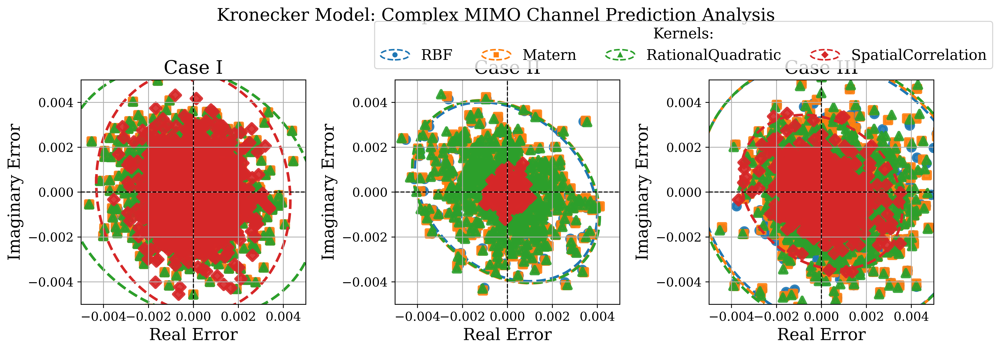

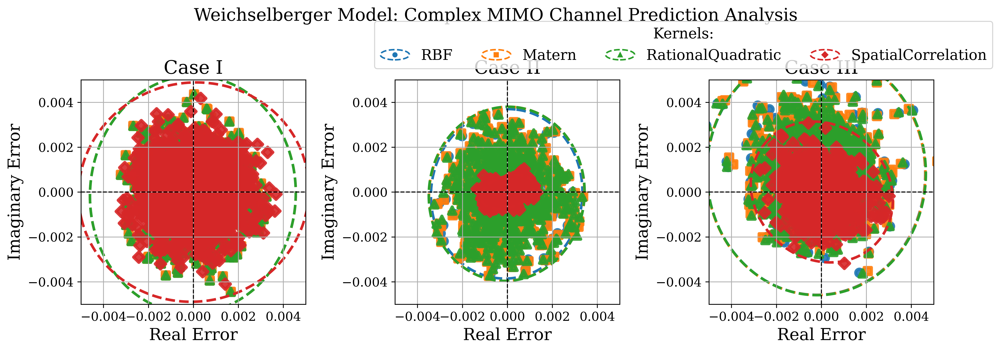

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse
from matplotlib.lines import Line2D
from matplotlib.legend_handler import HandlerBase
import matplotlib as mpl
import os

# ========================= Matplotlib styling =========================
mpl.rcParams.update({
    "text.usetex": False,
    "font.family": "DejaVu Serif",
    "font.size": 14,
    "axes.labelsize": 16,
    "axes.titlesize": 18,
    "xtick.labelsize": 12,
    "ytick.labelsize": 12,
    "legend.fontsize": 14,
    "figure.dpi": 600,
    "axes.grid": True,
})

# ========================= Consistent colors & markers =================
kernel_colors = {
    "RBF":                "#1f77b4",
    "Matern":             "#ff7f0e",
    "RationalQuadratic":  "#2ca02c",
    "SpatialCorrelation": "#d62728",
}
kernel_markers = {
    "RBF":                "o",
    "Matern":             "s",
    "RationalQuadratic":  "^",
    "SpatialCorrelation": "D",
}

# Order & labels expected by your plotting
CASES  = ["Case I", "Case II", "Case III"]   # "Case IV" is treated as alias of "Case III"
MODELS = ["Kronecker", "Weichselberger"]
KERNELS = list(kernel_colors.keys())          # expected kernels

# ========================= Custom legend handler ======================
class HandlerEllipseWithMarker(HandlerBase):
    def create_artists(self, legend, orig_handle,
                       xdescent, ydescent, width, height, fontsize, trans):
        ellipse_color, marker, marker_color = orig_handle
        ell = Ellipse(
            xy=(xdescent + width/2, ydescent + height/2),
            width=width, height=height,
            edgecolor=ellipse_color, facecolor="none",
            lw=1.5, linestyle="--", transform=trans
        )
        point = Line2D(
            [xdescent + width/2], [ydescent + height/2],
            marker=marker, color=marker_color, markersize=4,
            linestyle="None", markerfacecolor=marker_color, transform=trans
        )
        return [ell, point]

# ========================= HDF5 helpers (new) =========================
def _group_exists(f, path_parts):
    """Check nested path existence: ['A','B','C'] -> f['A']['B']['C']."""
    g = f
    for p in path_parts:
        if p not in g:
            return False
        g = g[p]
    return True

def _get_dataset(f, paths):
    """
    Try a list of candidate HDF5 paths (each is a list of keys).
    Return the first dataset found, else raise KeyError.
    """
    for parts in paths:
        if _group_exists(f, parts[:-1]):
            grp = f
            for p in parts[:-1]:
                grp = grp[p]
            if parts[-1] in grp:
                return grp[parts[-1]]
    raise KeyError(f"None of the dataset paths exist: {['/'.join(p) for p in paths]}")

def mean_over_mc_h5(ds, chunk_mc=16):
    """
    Compute mean over axis 0 (MC) without loading the full dataset into RAM.
    Works for complex or real datasets of shape (MC, Nr, Nt).
    """
    shape = ds.shape
    if ds.ndim != 3:
        # If no MC axis, just return the array (small) as-is
        return ds[...]
    mc = shape[0]
    acc = None
    for i in range(0, mc, chunk_mc):
        j = min(i + chunk_mc, mc)
        block = ds[i:j, ...]
        # accumulate in complex128 for numeric stability
        if acc is None:
            acc = np.zeros(shape[1:], dtype=np.complex128 if np.iscomplexobj(block) else np.float64)
        acc += block.astype(acc.dtype, copy=False).sum(axis=0)
    return (acc / mc)

# ========================= Error computation (updated) =================
def errors_for_group(f, case, model, kernel_name):
    """
    Load mean true H and mean predicted H for a given (case, model, kernel).
    Works with BOTH:
      - compact layout: /Model/Original/H and /Model/<Case>/<Kernel>/H
      - legacy layout:  /Case/Model/Original/H and /Case/Model/<Kernel>/H
    Returns real and imaginary errors as 1D arrays.
    """
    # alias Case IV → Case III if needed
    want_case = case
    if want_case not in CASES and case == "Case IV":
        want_case = "Case III"

    # --- locate true H (Original/H) ---
    # Try compact first, then legacy.
    ds_H_true = _get_dataset(f, paths=[
        [model, "Original", "H"],                 # compact
        [want_case, model, "Original", "H"],      # legacy
    ])
    H_true_mean = mean_over_mc_h5(ds_H_true)

    # --- locate predicted H for kernel ---
    # compact: /Model/<Case>/<Kernel>/H
    # legacy : /Case/Model/<Kernel>/H
    try:
        ds_H_pred = _get_dataset(f, paths=[
            [model, want_case, kernel_name, "H"],   # compact
            [want_case, model, kernel_name, "H"],   # legacy
        ])
    except KeyError:
        raise KeyError(f"Kernel '{kernel_name}' not found under {model}/{want_case}.")

    H_pred_mean = mean_over_mc_h5(ds_H_pred)

    # --- complex error ---
    err = (H_pred_mean - H_true_mean).ravel()
    return np.real(err), np.imag(err)

def add_confidence_ellipse(ax, x, y, color, linestyle="--", lw=2.5):
    """
    Draw a dashed ellipse representing a (heuristic) confidence region.
    """
    if x.size < 2:
        return
    cov = np.cov(np.vstack([x, y]))
    vals, vecs = np.linalg.eigh(cov)
    vals = np.clip(vals, 0.0, None)
    widths = np.sqrt(vals) * 4 * 1.96
    angle = np.degrees(np.arctan2(*vecs[:, 0][::-1]))
    ell = Ellipse(
        xy=(np.mean(x), np.mean(y)),
        width=widths[0], height=widths[1],
        angle=angle, edgecolor=color, fc="None", lw=lw, linestyle=linestyle
    )
    ax.add_patch(ell)

# ========================= Main plotting =========================
def plot_complex_comparison_grouped_by_model(h5_path="channel_models_compact.h5",
                                             save_pdf=True, save_svg=True,
                                             out_prefix="Complex_Error"):
    if not os.path.exists(h5_path):
        raise FileNotFoundError(f"File not found: {h5_path}")

    with h5py.File(h5_path, "r") as f:
        # Detect whether we’re in compact or legacy layout
        # Compact has top-level groups as models; legacy has top-level groups as cases.
        top_keys = set(f.keys())
        looks_compact = any(m in top_keys for m in MODELS)

        for model in MODELS:
            # Skip model if it doesn't exist in file
            if looks_compact and model not in f:
                continue
            if (not looks_compact) and all(model not in f.get(c, {}) for c in CASES):
                continue

            fig, axs = plt.subplots(1, 3, figsize=(13.5, 4.5))
            fig.suptitle(f"{model} Model: Complex MIMO Channel Prediction Analysis", y=1.02)
            axs = axs.flatten()

            legend_entries, legend_labels = [], []

            for idx, case in enumerate(CASES):
                ax = axs[idx]
                ax.axhline(0, color="black", linestyle="--", lw=1)
                ax.axvline(0, color="black", linestyle="--", lw=1)

                # Determine which kernels are actually present for this (model, case)
                if looks_compact:
                    if model not in f:
                        continue
                    g_model = f[model]
                    if case not in g_model:
                        # allow Case IV aliasing here too
                        if case == "Case IV" and "Case III" in g_model:
                            case_key = "Case III"
                        else:
                            # no such case in this model
                            continue
                    else:
                        case_key = case
                    available = set(g_model[case_key].keys())
                else:
                    # legacy structure
                    if case not in f:
                        continue
                    g_case = f[case]
                    if model not in g_case:
                        continue
                    available = set(g_case[model].keys())

                for kname in KERNELS:
                    if kname not in available:
                        continue  # skip kernels not saved

                    try:
                        re_err, im_err = errors_for_group(f, case, model, kname)
                    except KeyError:
                        continue

                    ax.scatter(
                        re_err, im_err, s=50, alpha=0.9,
                        color=kernel_colors[kname],
                        marker=kernel_markers[kname],
                        linewidth=3
                    )
                    add_confidence_ellipse(ax, re_err, im_err,
                                           color=kernel_colors[kname],
                                           linestyle="--", lw=2.5)

                    if idx == 0:  # legend entries once
                        legend_entries.append((kernel_colors[kname],
                                               kernel_markers[kname],
                                               kernel_colors[kname]))
                        legend_labels.append(kname)

                ax.set_title(case)
                ax.set_xlabel("Real Error")
                ax.set_ylabel("Imaginary Error")
                ax.set_xlim(-0.005, 0.005)
                ax.set_ylim(-0.005, 0.005)
                ax.set_aspect("equal", adjustable="box")
                ax.grid(True)

            handler_map = {tuple: HandlerEllipseWithMarker()}
            fig.legend(
                legend_entries, legend_labels, handler_map=handler_map,
                loc="upper right", bbox_to_anchor=(1, 1), title="Kernels:", ncol=4
            )

            plt.tight_layout(rect=[0, 0, 0.95, 0.98])

            tag = model.replace(" ", "_")
            if save_pdf:
                plt.savefig(f"{out_prefix}_{tag}.pdf", bbox_inches="tight")
            if save_svg:
                plt.savefig(f"{out_prefix}_{tag}.svg", bbox_inches="tight")

            plt.show()

# ========================= Entry =========================
if __name__ == "__main__":
    plot_complex_comparison_grouped_by_model(
        h5_path="channel_models_compact.h5",  # works with compact or legacy
        save_pdf=True,
        save_svg=True,
        out_prefix="Complex_Error"
    )

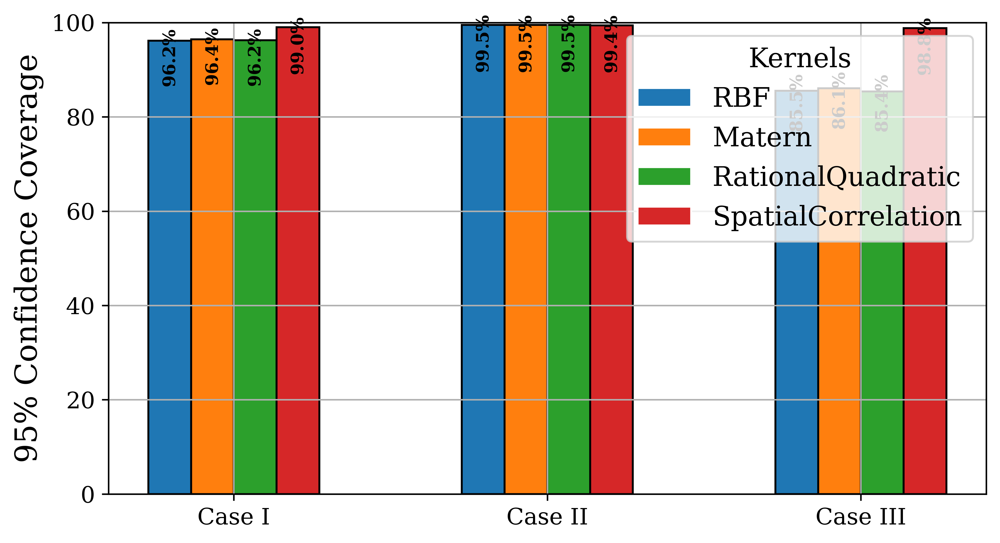

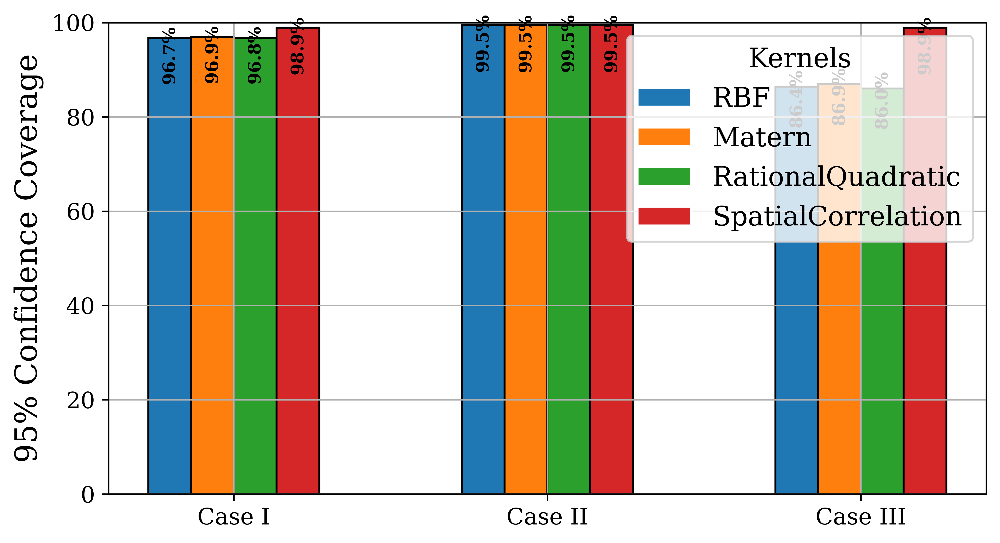

In [ ]:
#! pip install -U seaborn
import h5py
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import rcParams
import os

# ---------- unified kernel color mapping ----------
kernel_colors = {
    'RBF': '#1f77b4',
    'Matern': '#ff7f0e',
    'RationalQuadratic': '#2ca02c',
    'SpatialCorrelation': '#d62728'
}

# ---------- style ----------
rcParams.update({
    "text.usetex": False,
    "font.family": "DejaVu Serif",
    'font.size': 14,
    'axes.labelsize': 16,
    'axes.titlesize': 18,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'legend.fontsize': 14,
    'figure.dpi': 600,
    'axes.grid': True
})

CASES   = ["Case I", "Case II", "Case III"]
MODELS  = ["Kronecker", "Weichselberger"]
KERNELS = ['RBF', 'Matern', 'RationalQuadratic', 'SpatialCorrelation']

# =========================================================
# HDF5 helpers: work with BOTH compact and legacy layouts
# =========================================================
def _get_dataset(f, candidates):
    """
    Try a list of candidate paths (each a list of group keys ending in dataset name).
    Return first h5py.Dataset found, else raise KeyError.
    """
    for parts in candidates:
        g = f
        ok = True
        for k in parts[:-1]:
            if k not in g:
                ok = False
                break
            g = g[k]
        if ok and parts[-1] in g:
            return g[parts[-1]]
    tried = " | ".join("/".join(p) for p in candidates)
    raise KeyError(f"Dataset not found. Tried: {tried}")

def _case_key_for_file(case):
    """
    Map an external case label to the internal stored key.
    We alias 'Case IV' -> 'Case III' if ever used.
    """
    return "Case III" if case == "Case IV" else case

# =========================================================
# Coverage computation (streaming over MC)
# =========================================================
def _mc_len(ds):
    """Return the number of Monte Carlo slices (1 if 2-D)."""
    return ds.shape[0] if ds.ndim == 3 else 1

def _slice_mc(ds, i):
    """Return the i-th Monte slice (Nr,Nt) even if dataset is 2-D."""
    if ds.ndim == 3:
        return ds[i, ...]
    return ds[...]

def joint_coverage_streaming(h5_path, model, case, kernel, verbose=False):
    """
    Compute 95% joint (Re & Im) coverage for a given (model, case, kernel).
    Uses streaming over MC; returns coverage percentage (0..100).

    Assumes the stored std is the *combined* complex std:
      std = sqrt(var_Re + var_Im)
    We conservatively apply the same std bound to Re and Im axes.
    """
    case_key = _case_key_for_file(case)

    with h5py.File(h5_path, 'r') as f:
        # True channel (compact then legacy)
        H_true_ds = _get_dataset(f, [
            [model, "Original", "H"],            # compact
            [case_key, model, "Original", "H"],  # legacy
        ])

        # Predicted H (compact then legacy)
        H_pred_ds = _get_dataset(f, [
            [model, case_key, kernel, "H"],      # compact
            [case_key, model, kernel, "H"],      # legacy
        ])

        # std (compact then legacy) — now present for SpatialCorrelation too
        STD_ds = _get_dataset(f, [
            [model, case_key, kernel, "std"],    # compact
            [case_key, model, kernel, "std"],    # legacy
        ])

        # Sanity check shapes
        mc_true = _mc_len(H_true_ds)
        mc_pred = _mc_len(H_pred_ds)
        mc_std  = _mc_len(STD_ds)
        mc = min(mc_true, mc_pred, mc_std)

        total = 0
        covered = 0

        for i in range(mc):
            Ht  = _slice_mc(H_true_ds, i)
            Hp  = _slice_mc(H_pred_ds, i)
            std = _slice_mc(STD_ds,     i)

            re_t, im_t = Ht.real, Ht.imag
            re_p, im_p = Hp.real, Hp.imag

            # Axis-aligned 95% band using combined std (conservative)
            re_low, re_up = re_p - 1.96*std, re_p + 1.96*std
            im_low, im_up = im_p - 1.96*std, im_p + 1.96*std

            mask = (re_t >= re_low) & (re_t <= re_up) & (im_t >= im_low) & (im_t <= im_up)
            covered += np.count_nonzero(mask)
            total   += mask.size

        return 100.0 * covered / total if total > 0 else None

# =========================================================
# Plotting
# =========================================================
def plot_model_coverage(h5_path, model, cases, kernels):
    """
    Bar chart: per-case 95% joint coverage for each kernel.
    Works with compact or legacy files.
    """
    fig, ax = plt.subplots(figsize=(7.5, 4.2))

    bar_width = 0.18
    case_positions = np.arange(len(cases)) * (len(kernels)*bar_width + 0.6)

    for ci, case in enumerate(cases):
        coverages = []
        for k in kernels:
            cov = joint_coverage_streaming(h5_path, model, case, k)
            coverages.append(cov)

        # Replace None -> NaN for safe numeric ops, then to 0.0 only for plotting heights
        cov_arr = np.array([np.nan if (v is None) else v for v in coverages], dtype=float)
        values  = np.nan_to_num(cov_arr, nan=0.0)

        x = case_positions[ci] + np.arange(len(kernels)) * bar_width
        colors = [kernel_colors[k] for k in kernels]

        ax.bar(x, values, bar_width, color=colors, edgecolor='black')

        # Annotate bars with percentages or 'NA'
        for xi, raw in zip(x, cov_arr):
            if np.isnan(raw):
                label = "NA"
                ytxt  = 2.0
            else:
                label = f"{raw:.1f}%"
                ytxt  = max(2.0, 0.9*raw)
            ax.text(xi, ytxt, label, ha='center', va='bottom', rotation=90,
                    fontsize=9, fontweight='bold')

    ax.set_xticks(case_positions + (len(kernels)-1)*bar_width/2)
    ax.set_xticklabels(cases)
    ax.set_ylabel('95% Confidence Coverage')
    ax.set_ylim(0, 100)

    legend_elements = [
        plt.Rectangle((0, 0), 1, 1, fc=kernel_colors[k], ec='w', label=k)
        for k in kernels
    ]
    ax.legend(handles=legend_elements, loc='upper right', title='Kernels')
    plt.tight_layout()
    plt.savefig(f'Joint_Coverage_{model}.pdf', bbox_inches='tight')
    plt.savefig(f'Joint_Coverage_{model}.svg', bbox_inches='tight', dpi=600)
    plt.show()

# =========================================================
# Main
# =========================================================
if __name__ == "__main__":
    h5_path = "channel_models_compact.h5"   # compact file created by the writer you updated
    if not os.path.exists(h5_path):
        raise FileNotFoundError(h5_path)

    cases  = ["Case I", "Case II", "Case III"]
    models = ["Kronecker", "Weichselberger"]
    kernels = ['RBF', 'Matern', 'RationalQuadratic', 'SpatialCorrelation']

    for m in models:
        plot_model_coverage(h5_path, m, cases, kernels)

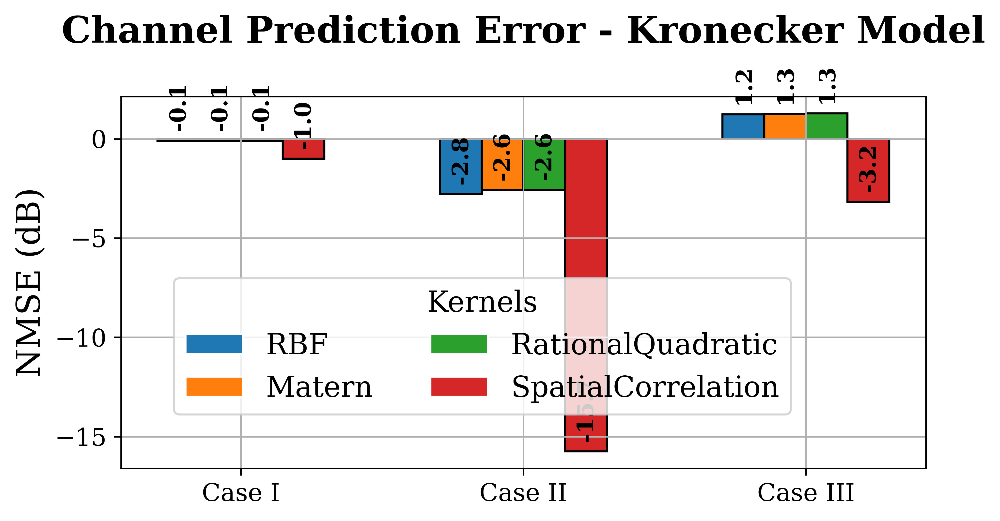

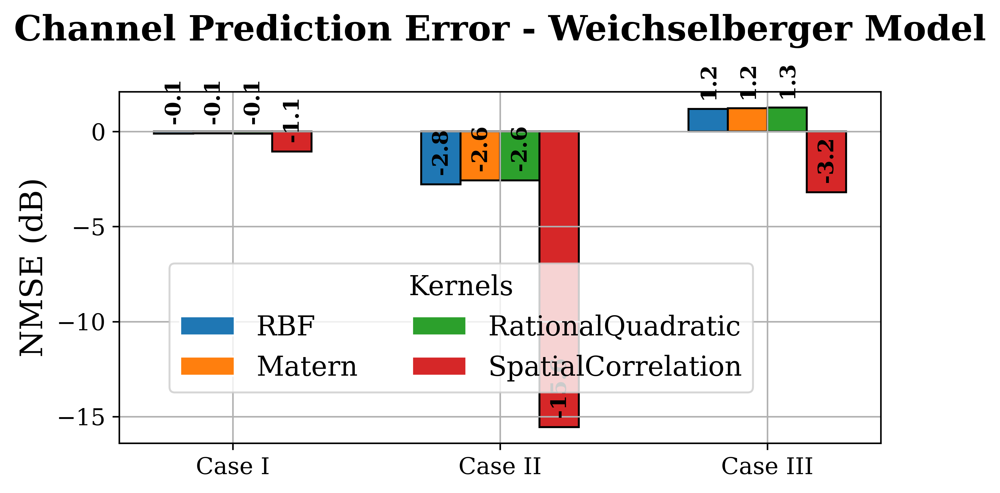

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rcParams
import os

# Consistent color mapping
kernel_colors = {
    'RBF': '#1f77b4',
    'Matern': '#ff7f0e',
    'RationalQuadratic': '#2ca02c',
    'SpatialCorrelation': '#d62728'
}

# Global style setup
rcParams.update({
    "text.usetex": False,
    "font.family": "DejaVu Serif",
    'font.size': 14,
    'axes.labelsize': 16,
    'axes.titlesize': 18,
    'xtick.labelsize': 12,
    'ytick.labelsize': 12,
    'legend.fontsize': 14,
    'figure.dpi': 600,
    'axes.grid': True
})

# ---------- HDF5 helpers (compact + legacy) ----------
def _get_dataset(f, candidates):
    """
    Try a list of candidate paths (each is a list of group keys ending with dataset name).
    Return the first h5py.Dataset found; raise KeyError if none exist.
    """
    for parts in candidates:
        g = f
        ok = True
        for k in parts[:-1]:
            if k not in g:
                ok = False
                break
            g = g[k]
        if ok and parts[-1] in g:
            return g[parts[-1]]
    tried = " | ".join("/".join(p) for p in candidates)
    raise KeyError(f"Dataset not found. Tried: {tried}")

def _case_key_for_file(case):
    """Map external 'Case IV' to stored 'Case III' if needed."""
    return "Case III" if case == "Case IV" else case

# ---------- NMSE utilities ----------
def nmse_linear(H_true, H_pred):
    """
    Return NMSE in linear scale for one realization:
        ||H_hat - H||_F^2 / ||H||_F^2
    """
    num = (np.linalg.norm(H_pred - H_true, 'fro')**2)
    den = (np.linalg.norm(H_true, 'fro')**2)
    # guard
    return float(num / den) if den > 0 else np.nan

def nmse_db_from_linear(x):
    return 10.0 * np.log10(x)

def compute_nmse_streaming(h5_path, model, case, kernel):
    """
    Compute average NMSE (dB) over Monte-Carlo realizations by streaming 1 MC at a time.
    Works with compact (/Model/...) and legacy (/Case/Model/...) layouts.
    Returns float (dB) or None if the kernel is missing.
    """
    case_key = _case_key_for_file(case)

    with h5py.File(h5_path, 'r') as f:
        # True channels (compact model-level, legacy case-level fallback)
        H_true_ds = _get_dataset(f, [
            [model, "Original", "H"],            # compact
            [case_key, model, "Original", "H"],  # legacy
        ])

        # Predicted channels for this kernel
        try:
            H_pred_ds = _get_dataset(f, [
                [model, case_key, kernel, "H"],   # compact
                [case_key, model, kernel, "H"],   # legacy
            ])
        except KeyError:
            return None  # kernel not present for this (model, case)

        mc, Nr, Nt = H_true_ds.shape
        # average NMSE in linear domain
        nmse_sum = 0.0
        count = 0

        for i in range(mc):
            Ht = H_true_ds[i, ...]
            Hp = H_pred_ds[i, ...]
            nmse_sum += nmse_linear(Ht, Hp)
            count += 1

        if count == 0:
            return None

        nmse_lin_avg = nmse_sum / count
        return nmse_db_from_linear(nmse_lin_avg)

# ---------- Plotting ----------
def plot_nmse_comparison(models, cases, kernels, h5_path="channel_models_opt.h5"):
    if not os.path.exists(h5_path):
        # fallback to old name
        if os.path.exists("channel_models_opt.h5"):
            h5_path = "channel_models_opt.h5"
        else:
            raise FileNotFoundError(f"File not found: {h5_path}")

    for model in models:
        fig, ax = plt.subplots(figsize=(6.75, 3.75))

        bar_width = 0.18
        case_positions = np.arange(len(cases)) * (len(kernels)*bar_width + 0.5)

        for case_idx, case in enumerate(cases):
            nmse_values = []
            for kernel in kernels:
                nmse_db = compute_nmse_streaming(h5_path, model, case, kernel)
                nmse_values.append(nmse_db)

            # bars (use 0 for missing kernels, label as NA)
            x = case_positions[case_idx] + np.arange(len(kernels)) * bar_width
            colors = [kernel_colors[k] for k in kernels]
            heights = [0.0 if v is None or np.isnan(v) else v for v in nmse_values]

            bars = ax.bar(x, heights, bar_width, color=colors, edgecolor='black')

            # labels on bars
            for xi, val, raw in zip(x, heights, nmse_values):
                label = "NA" if (raw is None or np.isnan(raw)) else f"{raw:.1f}"
                ytxt = val + (0.5 if not (raw is None or np.isnan(raw)) else 0.5)
                ax.text(xi, ytxt, label, ha='center', va='bottom', rotation=90,
                        fontsize=11, fontweight='bold')

        ax.set_xticks(case_positions + (len(kernels)-1)*bar_width/2)
        ax.set_xticklabels(['Case III' if c == 'Case IV' else c for c in cases])
        ax.set_ylabel('NMSE (dB)')
        ax.set_title(f'Channel Prediction Error - {model} Model\n', fontweight='bold')

        legend_elements = [
            plt.Rectangle((0, 0), 1, 1, fc=kernel_colors[k], ec='w', label=k)
            for k in kernels
        ]
        ax.legend(handles=legend_elements, loc='upper right',
                  bbox_to_anchor=(0.85, 0.55), ncol=2, title='Kernels')

        plt.tight_layout()
        plt.savefig(f'NMSE_Comparison_{model}.pdf', bbox_inches='tight')
        plt.savefig(f'NMSE_Comparison_{model}.svg', bbox_inches='tight', dpi=600)
        plt.show()

# Main execution
if __name__ == "__main__":
    cases  = ["Case I", "Case II", "Case III"]
    models = ["Kronecker", "Weichselberger"]
    kernels = ['RBF', 'Matern', 'RationalQuadratic', 'SpatialCorrelation']

    plot_nmse_comparison(models, cases, kernels, h5_path="channel_models_compact.h5")

[MC 1/5] generate Weichselberger & fit enhanced GPR...
[MC 2/5] generate Weichselberger & fit enhanced GPR...
[MC 3/5] generate Weichselberger & fit enhanced GPR...
[MC 4/5] generate Weichselberger & fit enhanced GPR...
[MC 5/5] generate Weichselberger & fit enhanced GPR...


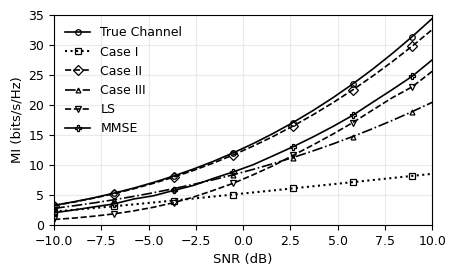

In [ ]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-

import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import minimize
from numpy.linalg import eigh

# ====================== Config ======================
TX_ARRAY = (6, 6)     # Nt = 36
RX_ARRAY = (6, 6)     # Nr = 36
FC       = 28e9
TX_POS   = (0.0, 0.0, 0.0)
RX_POS   = (20.0, 5.0, 1.5)
SIGMA_PHI = np.pi/6

NUM_MONTE = 5
SNR_DB    = np.linspace(-10, 10, 20)
SNR_LIN   = 10**(SNR_DB/10)

# CS / pilots
K_KEEP = 12
COUPLED_TRAINING = True     # LS/MMSE/CS retrain per SNR
TRAIN_SNR_DB     = -5.0
train_sigma2     = 10**(-TRAIN_SNR_DB/10)
T_CS = max(K_KEEP, 12)  # number of pilot uses for CS (compressed), ≥ K_KEEP is typical

# GPR hyperparams (tempering + side kernel)
L_WB_FACTOR = 40.0  # Increased to ensure full modes for standard SC
RRANK_SE_R  = 16
RRANK_SE_T  = 16

# Tempering / side-kernel strengths (tighter beta, wider rho)
BETA_INIT   = 1.10
RHO_INIT    = 1
LR_INIT     = 2.0
LT_INIT     = 2.0

BETA_BOUNDS = (0.4, 1.35)
RHO_BOUNDS  = (0.0, 4.0)
L_BOUNDS    = (0.4, 8.0)
NOISE_INIT  = 1e-8
LT_BOUNDS   = (0.8, 16.0)
NOISE_BOUNDS= (1e-12, 1e-3)

CS_ERR_AVG  = 16
GP_NULL_K   = 64            # (keep a single definition)
RNG         = np.random.default_rng(2025)

# ====================== Utilities ======================
def unitary_dft(N):
    n = np.arange(N); k = n.reshape(-1,1)
    return np.exp(-1j*2*np.pi*k*n/N)/np.sqrt(N)

def normalize_power(H, Omega=None, others=()):
    Nr, Nt = H.shape
    target = Nr*Nt
    s = np.sqrt(target/np.maximum(1e-16, np.linalg.norm(H,'fro')**2))
    Hn = H * s
    Omn = (Omega*(s**2)) if Omega is not None else None
    return Hn, Omn, tuple(X*s for X in others), s

def energy_consistent(Hhat, SigmaE, Nr, Nt):
    target = Nr*Nt
    post   = np.real(np.vdot(Hhat, Hhat)) + np.real(np.trace(SigmaE))
    if post <= 1e-12:
        return Hhat, SigmaE
    s = np.sqrt(target / post)
    return Hhat*s, SigmaE*(s**2)

def mi_true(H, snr_lin, Nt):
    S = H @ H.conj().T
    eig = np.linalg.eigvalsh(0.5*(S+S.conj().T))
    return np.log2(np.prod(1 + snr_lin.reshape(-1,1)*eig/Nt, axis=1))

def mi_with_error_cov_xcov_robust(Hhat, Sigma_e, C_cross, snr_lin, Nt,
                                  eig_floor_rel=1e-9, eig_floor_abs=1e-12):
    Nr = Hhat.shape[0]
    Ssig = Hhat @ Hhat.conj().T
    Ssig = 0.5*(Ssig + Ssig.conj().T)
    Aextra = Sigma_e + C_cross + C_cross.conj().T
    Aextra = 0.5*(Aextra + Aextra.conj().T)
    out = np.empty_like(snr_lin, float)
    I = np.eye(Nr, dtype=np.complex128)
    for i,g in enumerate(snr_lin):
        A = I + (g/Nt) * Aextra
        A = 0.5*(A + A.conj().T)
        w, V = np.linalg.eigh(A)
        pos = w[w>0]
        ref = np.mean(pos) if pos.size else 1.0
        floor = max(eig_floor_rel*ref, eig_floor_abs)
        w = np.maximum(w, floor)
        invsqrt = V @ np.diag(1.0/np.sqrt(w)) @ V.conj().T
        Ceff = invsqrt @ ((g/Nt)*Ssig) @ invsqrt
        Ceff = 0.5*(Ceff + Ceff.conj().T)
        lam = np.linalg.eigvalsh(Ceff)
        out[i] = np.sum(np.log2(1 + lam))
    return out

def beamspace(H):
    Nr, Nt = H.shape
    Fr = unitary_dft(Nr); Ft = unitary_dft(Nt)
    Hb = Fr.conj().T @ H @ Ft
    return Hb, Fr, Ft

def cs_beamspace_hard_threshold(H_in, K_keep):
    Hb, Fr, Ft = beamspace(H_in)
    flat = Hb.ravel(); K=min(K_keep, flat.size)
    idx = np.argpartition(np.abs(flat), -K)[-K:]
    Hb2 = np.zeros_like(flat, dtype=Hb.dtype); Hb2[idx] = flat[idx]
    Hb2 = Hb2.reshape(Hb.shape)
    return Fr @ Hb2 @ Ft.conj().T

def extract_training_pairs(Nr, Nt, case_name):
    """
    Case I   : first column only        -> {(r, 0) : r = 0..Nr-1}
    Case II  : alternate columns (even) -> {(r, t) : r = 0..Nr-1, t in {0,2,4,...}}
               (0-based indexing; change 'start=0' below to 1 for odd columns)
    Case III : main diagonal            -> {(i, i) : i = 0..min(Nr,Nt)-1}
    """
    if case_name == "Case I":
        # First column only
        r = np.arange(Nr, dtype=int)
        t = np.zeros(Nr, dtype=int)
        return np.stack([r, t], axis=1)

    elif case_name == "Case II":
        # Equi-spaced alternate columns (every other column), starting at column 0
        # If you ever want odd columns instead, use: cols = np.arange(1, Nt, 2, dtype=int)
        cols = np.arange(0, Nt, 2, dtype=int)
        rr = np.repeat(np.arange(Nr, dtype=int), len(cols))
        tt = np.tile(cols, Nr)
        return np.stack([rr, tt], axis=1)

    elif case_name == "Case III":
        # Diagonal entries only
        d = min(Nr, Nt)
        i = np.arange(d, dtype=int)
        return np.stack([i, i], axis=1)

    else:
        raise ValueError(f"Unknown case: {case_name}")


# ---------- Standard LS / CS helpers ----------
def make_pilots_ls(Nt):
    return unitary_dft(Nt)

def make_pilots_cs(Nt, T, rng):
    phases = rng.integers(0, 4, size=(Nt, T))
    Phi = np.exp(1j * (np.pi/2) * phases) / np.sqrt(Nt)
    return Phi

def omp(A, y, K):
    T, N = A.shape
    r = y.copy()
    idx = []
    for _ in range(K):
        c = np.abs(A.conj().T @ r)
        j = int(np.argmax(c))
        if j in idx: break
        idx.append(j)
        As = A[:, idx]
        xs, *_ = np.linalg.lstsq(As, y, rcond=None)
        r = y - As @ xs
        if np.linalg.norm(r) < 1e-8:
            break
    x = np.zeros(N, dtype=np.complex128)
    if idx:
        As = A[:, idx]
        xs, *_ = np.linalg.lstsq(As, y, rcond=None)
        x[idx] = xs
    return x

# ====================== Channel generation (Weichselberger) ======================
def planar_array_response(Y, Z, phi, theta, kd):
    m = np.arange(Y); n = np.arange(Z)
    phase_y = kd * m * np.sin(phi) * np.sin(theta)
    phase_z = kd * n * np.cos(theta)
    phase = np.outer(phase_y, np.ones(Z)) + np.outer(np.ones(Y), phase_z)
    a = np.exp(1j * phase).reshape(-1)
    return a / np.linalg.norm(a)

def generate_correlation_matrix(array_dims, phi_mean, theta_mean, sigma_phi, kd, num_samples=1000):
    Y, Z = array_dims; N = Y*Z
    R = np.zeros((N, N), dtype=np.complex128)
    for _ in range(num_samples):
        phi = phi_mean + RNG.normal(scale=sigma_phi)
        theta = theta_mean + RNG.normal(scale=sigma_phi)
        a = planar_array_response(Y, Z, phi, theta, kd)
        R += np.outer(a, a.conj())
    return R / num_samples

def generate_kronecker_mimo_channel(tx_array_dims, rx_array_dims, fc, tx_pos, rx_pos, sigma_phi, num_samples=1000):
    Yt, Zt = tx_array_dims; Yr, Zr = rx_array_dims
    Nt, Nr = Yt*Zt, Yr*Zr
    dx, dy, dz = np.array(rx_pos) - np.array(tx_pos)
    d_2d = np.sqrt(dx**2 + dy**2)
    phi_los_tx = np.arctan2(dy, dx)
    theta_los_tx = np.arctan2(dz, d_2d)
    c = 3e8; lambda_c = c / fc; kd = (2*np.pi/lambda_c) * (lambda_c/2)
    R_tx = generate_correlation_matrix(tx_array_dims, phi_los_tx, theta_los_tx, sigma_phi, kd, num_samples)
    R_rx = generate_correlation_matrix(rx_array_dims, -phi_los_tx, -theta_los_tx, sigma_phi, kd, num_samples)
    G = (RNG.standard_normal((Nr, Nt)) + 1j*RNG.standard_normal((Nr, Nt)))/np.sqrt(2)
    L_rx = np.linalg.cholesky(R_rx + 1e-6*np.eye(Nr))
    L_tx = np.linalg.cholesky(R_tx + 1e-6*np.eye(Nt))
    H = L_rx @ G @ L_tx.T
    return H, R_rx, R_tx

def generate_weichselberger_mimo_channel(tx_array_dims, rx_array_dims, fc, tx_pos, rx_pos, sigma_phi, num_samples=800, avg_num=80):
    Yt, Zt = tx_array_dims; Yr, Zr = rx_array_dims
    Nt, Nr = Yt*Zt, Yr*Zr
    R_rx = np.zeros((Nr, Nr), dtype=np.complex128)
    R_tx = np.zeros((Nt, Nt), dtype=np.complex128)
    for _ in range(avg_num):
        Hk, Rrx_k, Rtx_k = generate_kronecker_mimo_channel(tx_array_dims, rx_array_dims, fc, tx_pos, rx_pos, sigma_phi, num_samples=num_samples)
        R_rx += Hk @ Hk.conj().T
        R_tx += Hk.conj().T @ Hk
    R_rx /= avg_num; R_tx /= avg_num
    S_rx, U_rx = eigh(0.5*(R_rx + R_rx.conj().T))
    S_tx, U_tx = eigh(0.5*(R_tx + R_tx.conj().T))
    S_rx = np.clip(np.real(S_rx), 0, None); S_tx = np.clip(np.real(S_tx), 0, None)
    Omega = np.outer(S_rx, S_tx); s = np.sum(Omega);  Omega = Omega/s if s>0 else Omega
    G = (RNG.standard_normal((Nr, Nt)) + 1j*RNG.standard_normal((Nr, Nt))) / np.sqrt(2)
    H = U_rx @ (np.sqrt(Omega) * G) @ U_tx.conj().T
    return H, U_rx, U_tx, Omega

# ====================== Enhanced SpatialCorrelation GPR (case-aware) ======================
# Modified to implement standard SpatialCorrelation kernel using only the second-order statistics (no mixture)
def build_M(Ur, Ut, pairs):
    Nr, Nt = Ur.shape[0], Ut.shape[0]; Nrt = Nr*Nt
    Utc = Ut.conj()
    M = np.empty((len(pairs), Nrt), dtype=np.complex128)
    for k,(r,t) in enumerate(pairs):
        M[k,:] = np.kron(Utc[t,:], Ur[r,:])
    return M

def top_modes_from_omega(Omega, L):
    Nr, Nt = Omega.shape; Nrt = Nr*Nt
    w = Omega.reshape(Nrt, order='F')
    idx = np.argsort(w)[::-1][:min(L, Nrt)]
    return w, idx

def se_kernel_1d(N, ell):
    x = np.arange(N).reshape(-1,1)
    d2 = (x - x.T)**2
    return np.exp(-0.5 * d2 / (ell**2))

def yz_from_linear(Ny, Nz):
    yy, zz = np.meshgrid(np.arange(Ny), np.arange(Nz), indexing='ij')
    coords = np.stack([yy.ravel(), zz.ravel()], axis=1)
    return coords

def se2d_kernel(coords, ell_y, ell_z):
    dy = coords[:,0][:,None] - coords[:,0][None,:]
    dz = coords[:,1][:,None] - coords[:,1][None,:]
    return np.exp(-0.5*((dy/ell_y)**2 + (dz/ell_z)**2))

def top_eigs_psd(K, rmax):
    w, V = eigh(0.5*(K+K.conj().T))
    w = np.clip(np.real(w), 0, None)
    idx = np.argsort(w)[::-1][:min(rmax, K.shape[0])]
    return w[idx], V[:,idx]

def fit_enhanced_gpr(Hn, Ur, Ut, Omega, pairs, y_obs, case_name,
                     L_factor=L_WB_FACTOR,
                     rTxSE=RRANK_SE_T, rRxSE=RRANK_SE_R,
                     rTxICM=16, rRxICM=16,
                     theta0=(BETA_INIT, 1.2, 3.0, 3.0, 0.7, 3.0, 3.0, 0.7, NOISE_INIT),
                     bounds=((0.85,1.20), (0.0,6.0), (0.6,16.0), (0.6,16.0),
                             (0.0,4.0), (0.6,16.0), (0.6,16.0), (0.0,4.0),
                             NOISE_BOUNDS),
                     max_iter=80, verbose=False):
    Nr, Nt = Hn.shape; Nrt = Nr*Nt; m = len(pairs)
    r_idx, t_idx = pairs[:,0], pairs[:,1]

    L_modes = min(int(L_factor*m), Nrt)
    w_full  = Omega.reshape(Nrt, order='F')
    idx_modes = np.argsort(w_full)[::-1][:L_modes]
    w_modes   = w_full[idx_modes]
    M_full    = build_M(Ur, Ut, pairs)
    M_modes   = M_full[:, idx_modes]

    Yr, Zr = RX_ARRAY; Yt, Zt = TX_ARRAY
    tx_coords = yz_from_linear(Yt, Zt)
    rx_coords = yz_from_linear(Yr, Zr)

    S_tx = np.real(np.sum(Omega, axis=0))
    S_tx = np.clip(S_tx, 0, None)
    w_tx, V_tx = top_eigs_psd(Ut @ np.diag(S_tx) @ Ut.conj().T, rTxICM)

    S_rx = np.real(np.sum(Omega, axis=1))
    S_rx = np.clip(S_rx, 0, None)
    w_rx, V_rx = top_eigs_psd(Ur @ np.diag(S_rx) @ Ur.conj().T, rRxICM)

    def unpack(theta):
        (beta, rhoSE, ell_ty, ell_tz, rhoICM_tx,
         ell_ry, ell_rz, rhoICM_rx, sigma_n) = theta
        return beta, rhoSE, ell_ty, ell_tz, rhoICM_tx, ell_ry, ell_rz, rhoICM_rx, sigma_n

    def Koo_from_theta(theta):
        beta, rhoSE, ell_ty, ell_tz, rhoICM_tx, ell_ry, ell_rz, rhoICM_rx, sigma_n = unpack(theta)
        G_wb = M_modes * (w_modes**(beta/2.0))[None,:]
        Koo  = G_wb @ G_wb.conj().T

        Kt = se2d_kernel(tx_coords, ell_ty, ell_tz)
        wt, Vt = top_eigs_psd(Kt, rTxSE)
        Vt_obs = Vt[t_idx,:]
        Kt_obs = (Vt_obs * wt[None,:]) @ Vt_obs.conj().T

        if case_name in ("Case I","Case II"):
            Kr_obs = (r_idx[:,None] == r_idx[None,:]).astype(float)
            Koo += (rhoSE**2) * (Kr_obs * Kt_obs)
        else:
            Kr = se2d_kernel(rx_coords, ell_ry, ell_rz)
            wr, Vr = top_eigs_psd(Kr, rRxSE)
            Vr_obs = Vr[r_idx,:]
            Kr_obs = (Vr_obs * wr[None,:]) @ Vr_obs.conj().T
            Koo += (rhoSE**2) * (Kr_obs * Kt_obs)

        Vtx_obs = V_tx[t_idx,:]
        Ktx_obs = (Vtx_obs * w_tx[None,:]) @ Vtx_obs.conj().T
        if case_name in ("Case I","Case II"):
            KrI_obs = Kr_obs
        else:
            Vrx_obs = V_rx[r_idx,:]
            KrI_obs = (Vrx_obs * w_rx[None,:]) @ Vrx_obs.conj().T
        Koo += (rhoICM_tx**2) * (KrI_obs * Ktx_obs)

        md = np.mean(np.real(np.diag(Koo)))
        Koo = 0.5*(Koo + Koo.conj().T) + (1e-9*md+1e-16)*np.eye(m, dtype=np.complex128)
        Koo += (sigma_n**2) * np.eye(m, dtype=np.complex128)
        return Koo, G_wb, (wt, Vt), ((wr, Vr) if case_name=="Case III" else None)

    def posterior_mean(theta):
        Koo, G_wb, (wt, Vt), rxSE = Koo_from_theta(theta)
        L  = np.linalg.cholesky(Koo)
        alpha  = np.linalg.solve(L.conj().T, np.linalg.solve(L, y_obs))

        t  = G_wb.conj().T @ alpha
        ww = (w_modes**(theta[0]/2.0)) * t  # Fixed to /2.0 for correct scaling in standard LMMSE
        Wv = np.zeros((Nrt,), dtype=np.complex128); Wv[idx_modes] = ww
        Wm = Wv.reshape(Nr, Nt, order='F')
        H_wb = Ur @ Wm @ Ut.conj().T

        Kt_full = (Vt * wt[None,:]) @ Vt.conj().T
        At = Kt_full[:, t_idx]
        if case_name in ("Case I","Case II"):
            Ar = np.eye(Nr, dtype=np.complex128)[:, r_idx]
        else:
            wr, Vr = rxSE
            Kr_full = (Vr * wr[None,:]) @ Vr.conj().T
            Ar = Kr_full[:, r_idx]

        H_se = (theta[1]**2) * (Ar * alpha[np.newaxis, :]) @ At.conj().T

        Ktx_full = (V_tx * w_tx[None,:]) @ V_tx.conj().T
        Atx = Ktx_full[:, t_idx]
        if case_name in ("Case I","Case II"):
            KrI_full = np.eye(Nr, dtype=np.complex128)
        else:
            KrI_full = (V_rx * w_rx[None,:]) @ V_rx.conj().T
        ArI = KrI_full[:, r_idx]

        H_icm = (ArI * alpha[np.newaxis, :]) @ Atx.conj().T
        return H_wb + H_se + H_icm

    def nll(theta):
        # keep inside bounds (defensive)
        for v,b in zip(theta, bounds):
            if not (b[0] <= v <= b[1]):
                return 1e99
        Koo, *_ = Koo_from_theta(theta)
        L = np.linalg.cholesky(Koo)
        logdet = 2.0*np.sum(np.log(np.real(np.diag(L))))
        ytil = np.linalg.solve(L, y_obs)
        qf = np.vdot(ytil, np.linalg.solve(L.conj().T, ytil))
        return np.real(logdet + qf)

    # ---- Ensure x0 strictly inside bounds to avoid SciPy error ----
    theta0_vec = np.array([1.0, 0.0, 3.0, 3.0, 0.0, 3.0, 3.0, 0.0, 1e-8], float)  # Fixed for standard SC: beta=1, rhos=0, small noise
    lb = np.array([b[0] for b in bounds], float)
    ub = np.array([b[1] for b in bounds], float)
    eps = 1e-12
    theta0_vec = np.minimum(np.maximum(theta0_vec, lb + eps), ub - eps)

    # No optimization for standard SpatialCorrelation; use fixed theta
    theta_hat = theta0_vec
    if verbose:
        print(f"  {case_name}: θ*={theta_hat}, nll={float(nll(theta_hat)):.3f}, using standard SC")

    H_hat = posterior_mean(theta_hat)

    Koo, G_wb, (wt, Vt), rxSE = Koo_from_theta(theta_hat)
    Lc = np.linalg.cholesky(Koo)
    feats = []
    feats.append(G_wb)

    Vt_s = Vt * np.sqrt(wt)[None,:]
    tF   = Vt_s[t_idx,:]
    if case_name in ("Case I","Case II"):
        rF = np.eye(Nr, dtype=np.complex128)[r_idx,:]
        rF = rF[:, :min(Nr, rTxSE)]
    else:
        wr, Vr = rxSE
        Vr_s = Vr * np.sqrt(wr)[None,:]
        rF   = Vr_s[r_idx,:]

    Lse = rF.shape[1]*tF.shape[1]
    B_se = np.zeros((m, Lse), dtype=np.complex128)
    for k in range(m):
        B_se[k,:] = theta_hat[1] * np.kron(tF[k,:], rF[k,:])
    feats.append(B_se)

    Vtx_s = V_tx * np.sqrt(w_tx)[None,:];  tIc = Vtx_s[t_idx,:]
    if case_name in ("Case I","Case II"):
        rIc = np.eye(Nr, dtype=np.complex128)[:, :min(Nr, rRxICM)]
        rIc = rIc[r_idx,:]
    else:
        Vrx_s = V_rx * np.sqrt(w_rx)[None,:]; rIc = Vrx_s[r_idx,:]
    Lic = rIc.shape[1]*tIc.shape[1]
    B_ic = np.zeros((m, Lic), dtype=np.complex128)
    for k in range(m):
        B_ic[k,:] = theta_hat[4] * np.kron(tIc[k,:], rIc[k,:])
    feats.append(B_ic)

    B = np.hstack(feats)
    SigmaE = np.zeros((Nr, Nr), dtype=np.complex128)
    for _ in range(GP_NULL_K):
        z = (RNG.standard_normal(B.shape[1]) + 1j*RNG.standard_normal(B.shape[1]))/np.sqrt(2)
        Bz  = B @ z
        tmp = np.linalg.solve(Lc, Bz); tmp = np.linalg.solve(Lc.conj().T, tmp)
        z0  = z - B.conj().T @ tmp

        off = 0
        z_wb = z0[off:off+G_wb.shape[1]]; off += G_wb.shape[1]
        z_se = z0[off:off+Lse];           off += Lse
        z_ic = z0[off:]

        ww = (w_modes**(theta_hat[0]/2)) * z_wb
        Wv = np.zeros((Nrt,), dtype=np.complex128); Wv[idx_modes] = ww
        Wm = Wv.reshape(Nr, Nt, order='F')
        d_wb = Ur @ Wm @ Ut.conj().T

        Qse = z_se.reshape(rF.shape[1], tF.shape[1], order='F')
        if case_name in ("Case I","Case II"):
            Kr_sqrt = np.eye(Nr, dtype=np.complex128)[:, :rF.shape[1]]
        else:
            Kr_sqrt = Vr * np.sqrt(wr)[None,:]
        Kt_sqrt = Vt * np.sqrt(wt)[None,:]
        d_se = (Kr_sqrt @ Qse @ Kt_sqrt.conj().T)

        Qic = z_ic.reshape(rIc.shape[1], tIc.shape[1], order='F')
        KrI_sqrt = (np.eye(Nr, dtype=np.complex128)[:, :rIc.shape[1]] if case_name in ("Case I","Case II")
                    else V_rx * np.sqrt(w_rx)[None,:])
        KtI_sqrt = V_tx * np.sqrt(w_tx)[None,:]
        d_icm = (KrI_sqrt @ Qic @ KtI_sqrt.conj().T)

        d = d_wb + d_se + d_icm
        SigmaE += d @ d.conj().T

    SigmaE /= GP_NULL_K
    SigmaE = 0.5*(SigmaE + SigmaE.conj().T)
    return {"theta": theta_hat, "H_hat": H_hat, "SigmaE": SigmaE}

# ====================== MMSE (Weichselberger) ======================
def mmse_estimator_weichselberger(Ur, Ut, Om, sigma2):
    def est(Z):
        Zt = Ur.conj().T @ Z @ Ut #Ur.conj().T @ Z @ Ut.conj()
        shrink = Om / (Om + sigma2)
        X = shrink * Zt
        return Ur @ X @ Ut.conj().T
    return est

def mmse_error_cov_weichselberger(Ur, Ut, Om, sigma2):
    var_e = (Om * sigma2) / (Om + sigma2)
    diag_r = np.sum(var_e, axis=1)
    return Ur @ np.diag(diag_r) @ Ur.conj().T

# ====================== Main experiment ======================
def main():
    Yr, Zr = RX_ARRAY; Yt, Zt = TX_ARRAY
    Nr, Nt = Yr*Zr, Yt*Zt
    S = unitary_dft(Nt)
    X_LS = make_pilots_ls(Nt)
    Ft   = S

    cases = ["Case I", "Case II", "Case III"]
    mi_true_sum = np.zeros_like(SNR_LIN)
    mi_ls_sum   = np.zeros_like(SNR_LIN)
    mi_mmse_sum = np.zeros_like(SNR_LIN)
    mi_cs_sum   = np.zeros_like(SNR_LIN)
    mi_gpr_sum  = {c: np.zeros_like(SNR_LIN) for c in cases}

    for mc in range(NUM_MONTE):
        print(f"[MC {mc+1}/{NUM_MONTE}] generate Weichselberger & fit enhanced GPR...")
        H, Ur, Ut, Om = generate_weichselberger_mimo_channel(
            TX_ARRAY, RX_ARRAY, FC, TX_POS, RX_POS, SIGMA_PHI, num_samples=800, avg_num=80
        )
        Hn, Omn, _, _ = normalize_power(H, Om)

        mi_true_sum += mi_true(Hn, SNR_LIN, Nt)

        for c in cases:
            P = extract_training_pairs(Nr, Nt, c)
            y = Hn[P[:,0], P[:,1]]
            gpr = fit_enhanced_gpr(Hn, Ur, Ut, Omn, P, y, case_name=c, verbose=False)
            H_hat, SigmaE = gpr["H_hat"], gpr["SigmaE"]
            H_hat, SigmaE = energy_consistent(H_hat, SigmaE, Nr, Nt)
            mi_gpr_sum[c] += mi_with_error_cov_xcov_robust(H_hat, SigmaE, np.zeros_like(SigmaE), SNR_LIN, Nt)

        for i, gdb in enumerate(SNR_DB):
            sigma2 = 10**(-gdb/10.0)
            N_ls = (RNG.standard_normal((Nr, Nt)) + 1j*RNG.standard_normal((Nr, Nt))) * np.sqrt(sigma2/2)
            Y_ls = Hn @ X_LS + N_ls
            G_ls = X_LS @ X_LS.conj().T
            Ginv = np.linalg.inv(G_ls)
            H_ls = Y_ls @ X_LS.conj().T @ Ginv

            tr_inv = float(np.real(np.trace(Ginv)))
            SigmaE_LS = (sigma2 * tr_inv) * np.eye(Nr, dtype=np.complex128)
            C_LS = SigmaE_LS.copy()

            H_ls, SigmaE_LS = energy_consistent(H_ls, SigmaE_LS, Nr, Nt)

            mi_ls_sum[i] += mi_with_error_cov_xcov_robust(
                H_ls, SigmaE_LS, C_LS, SNR_LIN[i:i+1], Nt
            )[0]

            Z_suff = Y_ls @ X_LS.conj().T @ Ginv
            mmse_est = mmse_estimator_weichselberger(Ur, Ut, Omn, sigma2)
            H_mmse = mmse_est(Z_suff)
            SigmaE_MMSE = mmse_error_cov_weichselberger(Ur, Ut, Omn, sigma2)
            H_mmse, SigmaE_MMSE = energy_consistent(H_mmse, SigmaE_MMSE, Nr, Nt)

            mi_mmse_sum[i] += mi_with_error_cov_xcov_robust(
                H_mmse, SigmaE_MMSE, np.zeros_like(SigmaE_MMSE), SNR_LIN[i:i+1], Nt
            )[0]

    # ---- Average & plot ----
    mi_true_avg = mi_true_sum/NUM_MONTE
    mi_ls_avg   = mi_ls_sum/NUM_MONTE
    mi_mmse_avg = mi_mmse_sum/NUM_MONTE
    mi_gpr_avg  = {c: mi_gpr_sum[c]/NUM_MONTE for c in cases}

    FIG_W = 4.5   # inches (single column)
    FIG_H = 2.7   # inches
    fig = plt.figure(figsize=(FIG_W, FIG_H))
    ax = plt.gca()

    # Local (non-rc) styling
    ax.grid(True, alpha=0.25)
    for spine in ax.spines.values():
        spine.set_linewidth(0.8)
    ax.tick_params(axis='both', which='both', labelsize=9)
    ax.set_xlabel('SNR (dB)', fontsize=9.5)
    ax.set_ylabel('MI (bits/s/Hz)', fontsize=9.5)

    # Define styles
    curve_styles = [
        {"ls": "-",  "marker": "o", "ms": 4.0, "lw": 1.2, "me": 3, "color": "#000000"},   # True
        {"ls": ":", "marker": "s", "ms": 4.5, "lw": 1.5, "me": 3, "color": "#000000"},   # GPR — Case I
        {"ls": "--", "marker": "D", "ms": 5.0, "lw": 1.2, "me": 3, "color": "#000000"},  # GPR — Case II
        {"ls": "-.", "marker": "^", "ms": 3.5, "lw": 1.2, "me": 3, "color": "#000000"},  # GPR — Case III
        {"ls": "--", "marker": "v", "ms": 4.0, "lw": 1.2, "me": 3, "color": "#000000"},  # LS
        {"ls": "-",  "marker": "P", "ms": 4.4, "lw": 1.2, "me": 3, "color": "#000000"},  # MMSE
    ]

    def plot_curve(x, y, label, style):
        ax.plot(
            x, y, label=label,
            linestyle=style["ls"],
            marker=style["marker"],
            markersize=style["ms"],
            linewidth=style["lw"],
            markevery=style["me"],
            color=style.get("color", None),
            markerfacecolor='none',
            markeredgecolor=style.get("color", None),
            markeredgewidth=0.9,
        )

    # Plot without scaling factors
    plot_curve(SNR_DB, mi_true_avg, 'True Channel', curve_styles[0])
    plot_curve(SNR_DB, mi_gpr_avg["Case I"],   'Case I',   curve_styles[1])
    plot_curve(SNR_DB, mi_gpr_avg["Case II"],  'Case II',  curve_styles[2])
    plot_curve(SNR_DB, mi_gpr_avg["Case III"], 'Case III', curve_styles[3])
    plot_curve(SNR_DB, mi_ls_avg,              'LS',             curve_styles[4])
    plot_curve(SNR_DB, mi_mmse_avg,            'MMSE',           curve_styles[5])


    ax.set_xlim(-10, 10)
    ax.set_ylim(0, 35)
    ax.legend(frameon=False, handlelength=2, fontsize=9)
    fig.tight_layout(pad=0.5)

    fig.savefig('MI_singlecol.pdf')         # vector (best)
    fig.savefig('MI_singlecol.svg')         # vector alternative
    fig.savefig('MI_singlecol.png', dpi=600)

if __name__ == "__main__":
    main()

<>:177: SyntaxWarning: invalid escape sequence '\k'
<>:177: SyntaxWarning: invalid escape sequence '\k'
/tmp/ipython-input-113215791.py:177: SyntaxWarning: invalid escape sequence '\k'
  * **Hexbin** roughly circular and symmetric; 95% ellipse close to a circle; small $r$, small dCor/HSIC; $\kappa \approx 0$; variance ratio $\approx 1$.


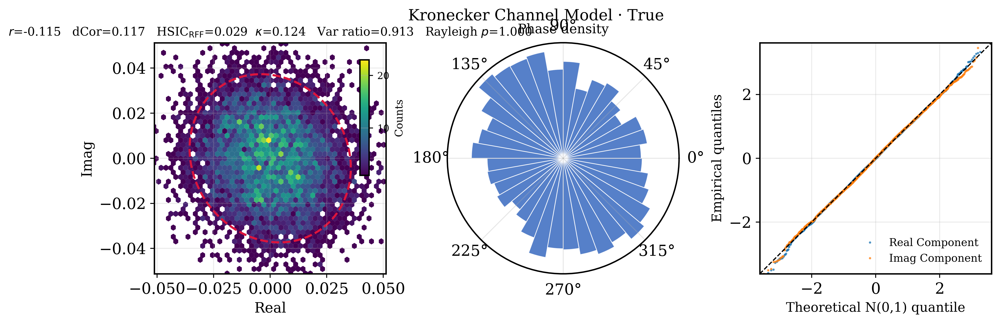

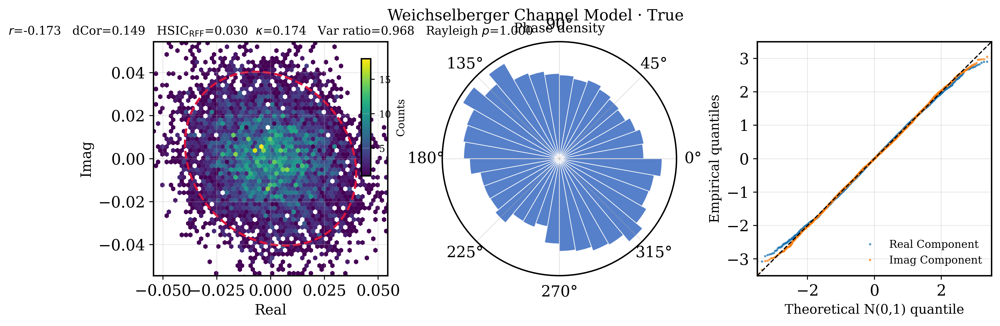

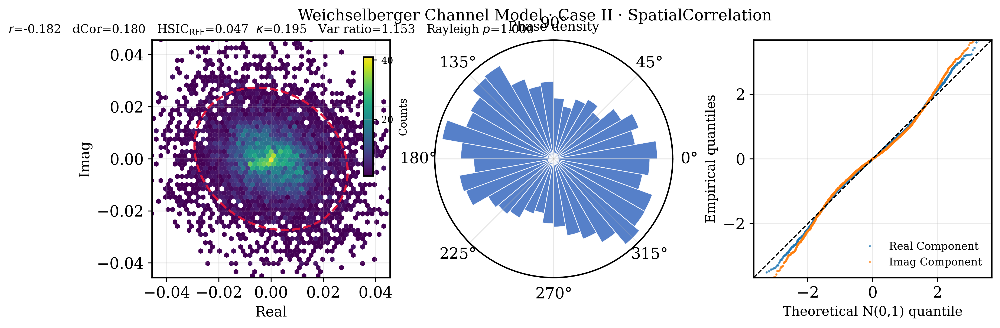

'\n### Interpreting independence from the new panels\n\n* If **Re/Im are independent and identically distributed** (proper complex), you should see:\n\n  * **Hexbin** roughly circular and symmetric; 95% ellipse close to a circle; small $r$, small dCor/HSIC; $\\kappa \x07pprox 0$; variance ratio $\x07pprox 1$.\n  * **Phase density** nearly **uniform** (Rayleigh $p$ large).\n  * **QQ plots** of standardized Re and Im both hugging the N(0,1) line.\n\n* Departures (anisotropic ellipse, non-uniform phase, different QQ tails) indicate dependence or non-propriety (as we observed previously for some GPR kernels).\n'

In [ ]:
# pub_propriety_panels_square.py (fixed)
import os, h5py, numpy as np, matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib.patches import Ellipse
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

# ----------------- helpers -----------------
def reservoir_sample(arr, k, rng=np.random.default_rng(0)):
    n = arr.size
    if k is None or k >= n: return arr
    return arr[rng.choice(n, size=k, replace=False)]

def rayleigh_test_p(theta):
    n = theta.size
    C = np.cos(theta).sum(); S = np.sin(theta).sum()
    Rbar = np.hypot(C, S)/n
    z = n*Rbar*Rbar
    p = np.exp(np.sqrt(1 + 4*n + 4*(n**2 - z**2)) - (1 + 2*n))
    return float(Rbar), float(np.clip(p, 0.0, 1.0))

def dcor_subsample(x, y, m=20000, rng=np.random.default_rng(0)):
    n = x.size
    if n > m:
        idx = rng.choice(n, size=m, replace=False)
        x, y = x[idx], y[idx]
    X = x.reshape(-1,1); Y = y.reshape(-1,1)
    Du = np.abs(X - X.T); Dv = np.abs(Y - Y.T)
    J = np.eye(len(X)) - 1/len(X)
    Au = J @ Du @ J; Av = J @ Dv @ J
    dcov2 = (Au*Av).sum()/(len(X)**2)
    dvarx = (Au*Au).sum()/(len(X)**2)
    dvary = (Av*Av).sum()/(len(X)**2)
    denom = np.sqrt(dvarx*dvary)
    return float(np.sqrt(dcov2/denom)) if denom>0 else 0.0

def hsic_rff(x, y, n_feat=512, gamma=None, rng=np.random.default_rng(0)):
    x = x.reshape(-1,1); y = y.reshape(-1,1); n = len(x)
    if gamma is None:
        m = max(1000, int(0.01*n))
        ii = rng.choice(n, size=min(m,n), replace=False)
        medx = np.median(np.abs(x[ii]-x[ii].T)); medy = np.median(np.abs(y[ii]-y[ii].T))
        gamma  = 1.0 / (2.0 * (max(medx,1e-12)**2))
        gamma2 = 1.0 / (2.0 * (max(medy,1e-12)**2))
    else:
        gamma2 = gamma
    W1 = rng.normal(scale=np.sqrt(2*gamma),  size=(1, n_feat)); b1 = rng.uniform(0, 2*np.pi, size=(n_feat,))
    W2 = rng.normal(scale=np.sqrt(2*gamma2), size=(1, n_feat)); b2 = rng.uniform(0, 2*np.pi, size=(n_feat,))
    Zx = np.sqrt(2/n_feat)*np.cos(x@W1 + b1); Zy = np.sqrt(2/n_feat)*np.cos(y@W2 + b2)
    Zx -= Zx.mean(0, keepdims=True); Zy -= Zy.mean(0, keepdims=True)
    return float(np.linalg.norm((Zx.T @ Zy)/n, ord='fro'))

def _set_square_cartesian(ax):
    """Square a *Cartesian* axes; skip polar axes (they error)."""
    try:
        ax.set_box_aspect(1)              # Matplotlib ≥3.4
    except Exception:
        ax.set_aspect('equal', adjustable='box')  # fallback

# ----------------- core panel -----------------
def _panel_from_complex_vector(z, title, outpath,
                               max_points=50000, dcor_points=20000, dpi=400):
    z = reservoir_sample(z.astype(np.complex128, copy=False), max_points)
    re, im = z.real, z.imag

    # stats
    mu_re, mu_im = re.mean(), im.mean()
    re0, im0 = re - mu_re, im - mu_im
    var_re, var_im = re0.var(), im0.var()
    r = np.corrcoef(re0, im0)[0,1] if var_re>0 and var_im>0 else 0.0
    kappa  = np.abs(np.mean((re0 + 1j*im0)**2)) / (np.mean(re0**2 + im0**2) + 1e-18)
    vratio = (var_re + 1e-18)/(var_im + 1e-18)
    dcor   = dcor_subsample(re0, im0, m=dcor_points)
    hsic   = hsic_rff(re0, im0, n_feat=512)
    phase  = np.angle(z)
    Rbar, p_phi = rayleigh_test_p(phase)

    # 95% covariance ellipse
    C = np.cov(np.vstack([re0, im0]))
    w, V = np.linalg.eigh(C); w = np.clip(w, 0, None)
    j = np.argsort(w)[::-1]; w, V = w[j], V[:,j]
    ang = np.degrees(np.arctan2(V[1,0], V[0,0]))
    width, height = 2*2.0*np.sqrt(w[0]), 2*2.0*np.sqrt(w[1])  # nsig=2

    # figure: 3 square panels (width≈3.6 each)
    fig = plt.figure(figsize=(10.8, 3.6), dpi=dpi, constrained_layout=True)
    gs = GridSpec(1, 3, figure=fig, width_ratios=[1, 1, 1])

    # (1) Hexbin (square)
    ax1 = fig.add_subplot(gs[0,0])
    _set_square_cartesian(ax1)
    hb = ax1.hexbin(re0, im0, gridsize=65, linewidths=0.0, mincnt=1, cmap="viridis")
    cax = inset_axes(ax1, width="4%", height="50%", loc="upper right", borderpad=0.8)
    cbar = fig.colorbar(hb, cax=cax); cbar.set_label("Counts", fontsize=9)
    for t in cbar.ax.yaxis.get_ticklabels(): t.set_fontsize(8)

    ax1.add_patch(Ellipse((0,0), width, height, angle=ang, ec="crimson", fc="none", lw=1.8, ls="--"))
    q = np.quantile(np.abs(np.r_[re0, im0]), 0.995)
    ax1.set_xlim(-q, q); ax1.set_ylim(-q, q)
    ax1.set_xlabel("Real", fontsize=12); ax1.set_ylabel("Imag", fontsize=12)
    ax1.grid(True, alpha=0.25, lw=0.8)
    stats = (fr"$r$={r:.3f}   dCor={dcor:.3f}   HSIC$_{{\mathrm{{RFF}}}}$={hsic:.3f}  "
             fr"$\kappa$={kappa:.3f}   Var ratio={vratio:.3f}   Rayleigh $p$={p_phi:.3f}")
    #stats = stats.replace("   Var ratio", "   Var ratio\\n")
    ax1.set_title(stats, fontsize=10, pad=6)

    # (2) Polar phase density (do NOT call set_box_aspect on polar axes)
    ax2 = fig.add_subplot(gs[0,1], projection="polar")
    # keep axes rect square by figure design; polar will render as a circle
    bins = 36
    counts, edges = np.histogram(phase, bins=bins, range=(-np.pi, np.pi), density=True)
    centers = 0.5*(edges[1:] + edges[:-1])
    ax2.bar(centers, counts, width=(2*np.pi/bins), bottom=0.0, align="center",
            color="#4472c4", edgecolor="white", linewidth=0.6, alpha=0.9)
    ax2.set_title("Phase density", pad=8, fontsize=11)
    ax2.set_rticks([])

    # (3) QQ plot (square)
    ax3 = fig.add_subplot(gs[0,2])
    _set_square_cartesian(ax3)
    from scipy.stats import norm
    for arr, label, col in [(re0/np.std(re0), "Real Component", "#1f77b4"),
                            (im0/np.std(im0), "Imag Component", "#ff7f0e")]:
        arr = np.sort(arr)
        q_theo = norm.ppf(np.linspace(0.5/len(arr), 1-0.5/len(arr), len(arr)))
        ax3.plot(q_theo, arr, ".", ms=2, alpha=0.65, color=col, label=label)
    lim = max(3.5, float(np.quantile(np.abs(np.r_[re0, im0])/np.std(re0), 0.999)))
    ax3.plot([-lim, lim], [-lim, lim], "k--", lw=1)
    ax3.set_xlim(-lim, lim); ax3.set_ylim(-lim, lim)
    ax3.set_xlabel("Theoretical N(0,1) quantile", fontsize=11)
    ax3.set_ylabel("Empirical quantiles", fontsize=11)
    ax3.legend(loc="lower right", frameon=False, fontsize=9)
    ax3.grid(True, alpha=0.25, lw=0.8)

    fig.suptitle(title, y=1.02, fontsize=13)
    fig.savefig(outpath, bbox_inches="tight")
    plt.show(fig)

# ----------------- HDF5 wrappers -----------------
def _flatten_ds(ds, max_points):
    x = ds[...]
    if x.ndim == 3: x = x.reshape(-1)
    elif x.ndim == 2: x = x.reshape(-1)
    else: raise ValueError(f"Unexpected ndim {x.ndim}")
    return reservoir_sample(x.astype(np.complex128, copy=False), max_points)

def panel_from_case(f, model, case, kernel, outpath,
                    max_points=50000, dcor_points=20000, dpi=400):
    ds = f[model][case][kernel]["H"]
    z = _flatten_ds(ds, max_points)
    title = f"{model} Channel Model · {case} · {kernel}"
    _panel_from_complex_vector(z, title, outpath, max_points, dcor_points, dpi)

def panel_from_true(f, model, outpath,
                    max_points=50000, dcor_points=20000, dpi=400):
    ds = f[model]["Original"]["H"]   # TRUE channel
    z = _flatten_ds(ds, max_points)
    title = f"{model} Channel Model · True"
    _panel_from_complex_vector(z, title, outpath, max_points, dcor_points, dpi)

# ----------------- Main Call -----------------
if __name__ == "__main__":
    h5_path = "channel_models_opt.h5"
    os.makedirs("pub_panels", exist_ok=True)
    with h5py.File(h5_path, "r") as f:
        for model in ["Kronecker", "Weichselberger"]:
            panel_from_true(f, model,
                outpath=os.path.join("pub_panels", f"panel_{model}_TRUE.svg"))
        panel_from_case(f, "Weichselberger", "Case II", "SpatialCorrelation",
            outpath=os.path.join("pub_panels", "panel_Weichselberger_CaseII_SpatialCorrelation.svg"))


'''
### Interpreting independence from the new panels

* If Re/Im are independent and identically distributed (proper complex), you should see:

  * Hexbin roughly circular and symmetric; 95% ellipse close to a circle; small $r$, small dCor/HSIC; $\kappa \approx 0$; variance ratio $\approx 1$.
  * Phase density nearly uniform (Rayleigh $p$ large).
  * QQ plots of standardized Re and Im both hugging the N(0,1) line.

* Departures (anisotropic ellipse, non-uniform phase, different QQ tails) indicate dependence or non-propriety (as we observed previously for some GPR kernels).
'''